In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
import random

Reading the data

In [ ]:
train = pd.read_csv('train_2.csv')
train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-01,2017-09-02,2017-09-03,2017-09-04,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,19.0,33.0,33.0,18.0,16.0,27.0,29.0,23.0,54.0,38.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,32.0,30.0,11.0,19.0,54.0,25.0,26.0,23.0,13.0,81.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,6.0,6.0,7.0,2.0,4.0,7.0,3.0,4.0,7.0,6.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,7.0,19.0,19.0,9.0,6.0,16.0,19.0,30.0,38.0,4.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,16.0,16.0,19.0,9.0,20.0,23.0,28.0,14.0,8.0,7.0


Duplicate and Missing data 

In [ ]:
# Checking if any page is duplicated
print("Number of duplicated data :" , format(sum(train['Page'].duplicated())))

Number of duplicated data : 0


In [ ]:
# Missing data
missing = train.isnull().sum(axis=1)
missing_value_df = pd.DataFrame({'Index_no': train.index,
                                'missing': missing})
missing_value_df

,Index_no,missing
0,0,0
1,1,0
2,2,0
3,3,0
4,4,291
...,...,...
145058,145058,544
145059,145059,564
145060,145060,579
145061,145061,573


In [ ]:
'''
For calculation of the popularity I am filling the NA values with 0 
'''
raw_train=train.iloc[:,:].copy()
raw_train.loc[:,raw_train.columns!='Page']=raw_train.loc[:,raw_train.columns!='Page'].fillna(0)
raw_train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-01,2017-09-02,2017-09-03,2017-09-04,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,19.0,33.0,33.0,18.0,16.0,27.0,29.0,23.0,54.0,38.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,32.0,30.0,11.0,19.0,54.0,25.0,26.0,23.0,13.0,81.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,6.0,6.0,7.0,2.0,4.0,7.0,3.0,4.0,7.0,6.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,7.0,19.0,19.0,9.0,6.0,16.0,19.0,30.0,38.0,4.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,16.0,16.0,19.0,9.0,20.0,23.0,28.0,14.0,8.0,7.0


In [ ]:
'''

For the imputed data the NA values are filled using forward linear interpolation. 
The remaining missing values will give us an idea on the number of days the website was active. If the website is inactive for a 
day then there will be no traffic value for that day .
'''
inp_train=train.iloc[:,:].copy()
inp_train.iloc[:,1:]=inp_train.iloc[:,1:].interpolate(method='linear',axis=1,limit_direction='forward')


In [ ]:
# Missing data after linear interpolation , this value will be used in the calculation of the active days of the website
missing = inp_train.isnull().sum(axis=1)
missing_value_df = pd.DataFrame({'Index_no': train.index,
                                'missing': missing})
missing_value_df

,Index_no,missing
0,0,0
1,1,0
2,2,0
3,3,0
4,4,291
...,...,...
145058,145058,544
145059,145059,564
145060,145060,571
145061,145061,573


In [ ]:
# Filling these values with 0 .This is the imputed data.
inp_train.loc[:,inp_train.columns!='Page']=inp_train.loc[:,inp_train.columns!='Page'].fillna(0)

inp_train.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-01,2017-09-02,2017-09-03,2017-09-04,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10
0,2NE1_zh.wikipedia.org_all-access_spider,18.0,11.0,5.0,13.0,14.0,9.0,9.0,22.0,26.0,...,19.0,33.0,33.0,18.0,16.0,27.0,29.0,23.0,54.0,38.0
1,2PM_zh.wikipedia.org_all-access_spider,11.0,14.0,15.0,18.0,11.0,13.0,22.0,11.0,10.0,...,32.0,30.0,11.0,19.0,54.0,25.0,26.0,23.0,13.0,81.0
2,3C_zh.wikipedia.org_all-access_spider,1.0,0.0,1.0,1.0,0.0,4.0,0.0,3.0,4.0,...,6.0,6.0,7.0,2.0,4.0,7.0,3.0,4.0,7.0,6.0
3,4minute_zh.wikipedia.org_all-access_spider,35.0,13.0,10.0,94.0,4.0,26.0,14.0,9.0,11.0,...,7.0,19.0,19.0,9.0,6.0,16.0,19.0,30.0,38.0,4.0
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,16.0,16.0,19.0,9.0,20.0,23.0,28.0,14.0,8.0,7.0


#### List of dates in the train data

In [ ]:
'''
datelist is created from column names by converting it to datetime format
'''

from datetime import datetime
date_list=[]
for i in train.columns[1:]:
    date_list.append(datetime.strptime(i, '%Y-%m-%d'))
    


#### Weekday , Weekend and Month for each date

In [ ]:
'''
Weekday is calculated using datelist ,weekend is calculated as 1 for weekend days and 0 
for weekdays.
Month is also calculated from datelist .Other features like month_start, month_end , quarter_start , quarter_end etc 
are created using this datelist.
'''
weekday=[]
for i in date_list:
    weekday.append(i.weekday())
weekday=pd.Series(weekday)
weekend=[]
for i in weekday:
    if i in range(5):
        weekend.append(0)
    else:
        weekend.append(1)
weekend=pd.Series(weekend)
month=[]
for i in date_list:
    month.append(i.month)
month=pd.Series(month)

month_start=[]
month_start=pd.Series(date_list).dt.is_month_start

month_end=[]
month_end=pd.Series(date_list).dt.is_month_end

quarter_start=[]
quarter_start=pd.Series(date_list).dt.is_quarter_start

quarter_end=[]
quarter_end=pd.Series(date_list).dt.is_quarter_end

week=[]
week=pd.Series(date_list).dt.week


quarter=[]
quarter=pd.Series(date_list).dt.quarter


days_in_month=[]
days_in_month =pd.Series(date_list).dt.days_in_month

year=[]
year=pd.Series(date_list).dt.year


In [ ]:
## Features for EDA
feat_for_eda=pd.DataFrame()


#### Dividing the dataset based on languages of the pages

In [ ]:
## Language is calculated from page name. The dataframes are stored in a dictionary
def lang(page):
    index=re.search('[a-z][a-z].wikipedia.org',page)
   
    if(index):
        return (index[0][0:2])
    else:
        return('na')
feat_for_eda['Lang']=train['Page'].apply(lang)
lang_df={}

for i in feat_for_eda['Lang'].unique():
    lang_df[i]=inp_train.loc[feat_for_eda['Lang']==i]


In [ ]:
lang_mean={}
for key in lang_df:
    lang_mean[key]=lang_df[key].iloc[:,1:].mean().reset_index(drop=True)
lang_mean

{'zh': 0      240.582042
 1      240.971125
 2      239.358622
 3      241.667788
 4      257.791433
           ...    
 798    290.238885
 799    302.535725
 800    291.725405
 801    304.790412
 802    317.292182
 Length: 803, dtype: float64,
 'fr': 0      475.150994
 1      478.203960
 2      459.840994
 3      491.515491
 4      482.563026
           ...    
 798    518.278471
 799    509.551724
 800    449.860802
 801    474.597517
 802    512.069262
 Length: 803, dtype: float64,
 'en': 0      3513.862203
 1      3502.540258
 2      3325.387138
 3      3462.089869
 4      3575.560857
           ...     
 798    3861.927995
 799    4062.642879
 800    3096.774598
 801    2993.151879
 802    3429.376016
 Length: 803, dtype: float64,
 'na': 0       83.479922
 1       87.523883
 2       82.722546
 3       70.632746
 4       78.278474
           ...    
 798    498.486818
 799    804.622323
 800    143.450378
 801    145.331784
 802    129.114030
 Length: 803, dtype: float64,
 'ru': 0 

#### Dividing the dataset based on agent of the pages

In [ ]:
## Agent is also calculated from page name.
def agent(page):
    index=re.search('spider',page)
   
    if(index):
        return (1)
    else:
        return(0)
feat_for_eda['Agent']=train['Page'].apply(agent)

In [ ]:
agent_df={}
agent_df['spider']=train.loc[feat_for_eda['Agent']==1].iloc[:,:]
agent_df['non_spider']=train.loc[feat_for_eda['Agent']==0].iloc[:,:]



#### Dividing the dataset based on access type of the pages

In [ ]:
def access(page):
    all_access=re.search('all-access',page)
    desktop=re.search('desktop',page)   
    mobile=re.search('mobile-web',page)
    if(all_access):    
        return (0)
    elif(desktop):
        return(1)
    else:
        return(2)
feat_for_eda['Access']=train['Page'].apply(access)


In [ ]:
access_df={}
for i in feat_for_eda['Access'].unique():
    if i == 0:
        access_df['All-Access']=train.loc[feat_for_eda['Access']==i].iloc[:,:]
    elif i == 1:
        access_df['Desktop']=train.loc[feat_for_eda['Access']==i].iloc[:,:]
    elif i ==2:
        access_df['Mobile']=train.loc[feat_for_eda['Access']==i].iloc[:,:]
        


#### Active days for each page

In [ ]:
#Calculated by subtracting the missing value days after interpolation from total number of days.
feat_for_eda['Days_active']= train.shape[1]-1-missing

In [ ]:
'''
View Percentage is calculated by dividing the total traffic for each page by the number of active days for that page.
'''
# View Percentage calculated from raw data
data_values=raw_train.iloc[:,1:train.shape[1]]
raw=pd.DataFrame()
raw['viewperc']=data_values.sum(axis=1)/feat_for_eda['Days_active']
raw=raw.fillna(0)
# View Percentage calculated from imputed data
data_values=inp_train.iloc[:,1:train.shape[1]]
imp=pd.DataFrame()
#total_hit=data_values.values.sum()
imp['viewperc']=data_values.sum(axis=1)/feat_for_eda['Days_active']
imp=imp.fillna(0)


In [ ]:
# Raw data along with features for eda
eda_train_raw=pd.concat([train,feat_for_eda,raw],axis=1)
eda_train_raw=eda_train_raw.sort_values(by='viewperc',ascending=False)

#transforming the data using log function (log(1+x))
eda_log_raw=eda_train_raw.iloc[:,:].copy()
eda_log_raw.iloc[:,1:train.shape[1]]=raw_train.iloc[:,1:train.shape[1]].apply(np.log1p)
# Imputed data along with features for eda
eda_train_imp=pd.concat([inp_train,feat_for_eda,imp],axis=1)
eda_train_imp=eda_train_imp.sort_values(by='viewperc',ascending=False)

#transforming the data using log function (log(1+x))
eda_log_imp=eda_train_imp.iloc[:,:].copy()
eda_log_imp.iloc[:,1:train.shape[1]]=inp_train.iloc[:,1:train.shape[1]].apply(np.log1p)


In [ ]:
eda_train_raw.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,20381245.0,20752194.0,19573967.0,20439645.0,20772109.0,22544669.0,21210887.0,19107911.0,19993848.0,...,17499187.0,18273046.0,14116665.0,12696261.0,15731110.0,en,0,0,803,2.141502e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,11952559.0,12344021.0,11195848.0,11982470.0,12379684.0,14164829.0,12917172.0,11089923.0,12067334.0,...,15458480.0,16256524.0,12236818.0,10723874.0,13755046.0,en,0,1,803,1.609010e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,8039732.0,8018607.0,7980511.0,8024814.0,7929962.0,7959839.0,7892357.0,7607871.0,7515302.0,...,1912028.0,1937004.0,1802121.0,1884689.0,1884638.0,en,0,2,803,4.780634e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,2983623.0,2965848.0,2900702.0,2687450.0,2827409.0,3062343.0,2999196.0,2995270.0,2995810.0,...,1804026.0,2054882.0,1659567.0,1484199.0,1548258.0,de,0,0,803,2.823571e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,2034850.0,1984412.0,1763117.0,1620136.0,1766701.0,2108408.0,2118720.0,2052391.0,2300186.0,...,2554541.0,2298018.0,1930918.0,1717417.0,1936047.0,en,0,0,803,2.366707e+06


In [ ]:
eda_log_raw.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,16.830126,16.848163,16.789711,16.832987,16.849122,16.931009,16.870025,16.765613,16.810935,...,16.677665,16.720938,16.462867,16.356818,16.571151,en,0,0,803,2.141502e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,16.296456,16.328682,16.231054,16.298955,16.331567,16.466273,16.374068,16.221548,16.306013,...,16.553668,16.604005,16.319960,16.187983,16.436916,en,0,1,803,1.609010e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,15.899906,15.897275,15.892513,15.898049,15.886159,15.889919,15.881406,15.844694,15.832452,...,14.463676,14.476654,14.404475,14.449274,14.449247,en,0,2,803,4.780634e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,14.908649,14.902674,14.880464,14.804104,14.854872,14.934691,14.913855,14.912545,14.912726,...,14.405532,14.535729,14.322068,14.210386,14.252642,de,0,0,803,2.823571e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,14.525933,14.500834,14.382594,14.298021,14.384625,14.561444,14.566323,14.534517,14.648501,...,14.753384,14.647558,14.473507,14.356333,14.476159,en,0,0,803,2.366707e+06


In [ ]:
eda_train_imp.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,20381245.0,20752194.0,19573967.0,20439645.0,20772109.0,22544669.0,21210887.0,19107911.0,19993848.0,...,17499187.0,18273046.0,14116665.0,12696261.0,15731110.0,en,0,0,803,2.141502e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,11952559.0,12344021.0,11195848.0,11982470.0,12379684.0,14164829.0,12917172.0,11089923.0,12067334.0,...,15458480.0,16256524.0,12236818.0,10723874.0,13755046.0,en,0,1,803,1.609010e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,8039732.0,8018607.0,7980511.0,8024814.0,7929962.0,7959839.0,7892357.0,7607871.0,7515302.0,...,1912028.0,1937004.0,1802121.0,1884689.0,1884638.0,en,0,2,803,4.780634e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,2983623.0,2965848.0,2900702.0,2687450.0,2827409.0,3062343.0,2999196.0,2995270.0,2995810.0,...,1804026.0,2054882.0,1659567.0,1484199.0,1548258.0,de,0,0,803,2.823571e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,2034850.0,1984412.0,1763117.0,1620136.0,1766701.0,2108408.0,2118720.0,2052391.0,2300186.0,...,2554541.0,2298018.0,1930918.0,1717417.0,1936047.0,en,0,0,803,2.366707e+06


In [ ]:
eda_log_imp

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Lang,Agent,Access,Days_active,viewperc
38573,Main_Page_en.wikipedia.org_all-access_all-agents,16.830126,16.848163,16.789711,16.832987,16.849122,16.931009,16.870025,16.765613,16.810935,...,16.677665,16.720938,16.462867,16.356818,16.571151,en,0,0,803,2.141502e+07
9774,Main_Page_en.wikipedia.org_desktop_all-agents,16.296456,16.328682,16.231054,16.298955,16.331567,16.466273,16.374068,16.221548,16.306013,...,16.553668,16.604005,16.319960,16.187983,16.436916,en,0,1,803,1.609010e+07
74114,Main_Page_en.wikipedia.org_mobile-web_all-agents,15.899906,15.897275,15.892513,15.898049,15.886159,15.889919,15.881406,15.844694,15.832452,...,14.463676,14.476654,14.404475,14.449274,14.449247,en,0,2,803,4.780634e+06
139119,Wikipedia:Hauptseite_de.wikipedia.org_all-acce...,14.908649,14.902674,14.880464,14.804104,14.854872,14.934691,14.913855,14.912545,14.912726,...,14.405532,14.535729,14.322068,14.210386,14.252642,de,0,0,803,2.823571e+06
39180,Special:Search_en.wikipedia.org_all-access_all...,14.525933,14.500834,14.382594,14.298021,14.384625,14.561444,14.566323,14.534517,14.648501,...,14.753384,14.647558,14.473507,14.356333,14.476159,en,0,0,803,2.366707e+06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14613,User:46.188.28.235_commons.wikimedia.org_all-a...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,na,1,0,243,0.000000e+00
123837,xss_ru.wikipedia.org_all-access_spider,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,ru,1,0,368,0.000000e+00
123695,????:Andrey_Belloly_1.jpg_ru.wikipedia.org_all...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,ru,1,0,546,0.000000e+00
83021,Artificial_Insemination's_Art_www.mediawiki.or...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,na,1,0,803,0.000000e+00


In [ ]:
eda_train_raw.to_csv('eda_train_raw.csv',index=False)
eda_train_imp.to_csv('eda_train_imp.csv',index=False)

In [ ]:
#Extracting the pages with view percentage greater than 0.
#eda_raw_pop=eda_train_raw.loc[eda_train_raw['viewperc']>0]
eda_imp_pop=eda_train_imp.loc[eda_train_imp['viewperc']>0]



In [ ]:
# Get the last 15 pages with least view percentage greater than 0.
last_15_raw=eda_raw_pop.iloc[-15:,:] 
last_15_imp=eda_imp_pop.iloc[-15:,:]

NameError: name 'eda_raw_pop' is not defined

In [ ]:
last_15_imp.head()

,Page,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,...,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Lang,Agent,Access,Days_active,viewperc
14589,Special:Translate/editpage_commons.wikimedia.o...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,0.0,0.0,na,1,0,803,0.069738
83324,Help_talk:Talk_pages/ca_www.mediawiki.org_all-...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,0.0,0.0,na,1,0,549,0.061020
83716,Special:Preferences_www.mediawiki.org_all-acce...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,1,0,803,0.057285
83713,Special:OAuth/authorize_www.mediawiki.org_all-...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,1,0,803,0.054795
14584,Special:Preferences_commons.wikimedia.org_all-...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,na,1,0,803,0.051059


## Exploratory Data Analysis 
### Univariate Analysis

#### Plotting the average pagehit with different parameters like weekdays , weekends , months.

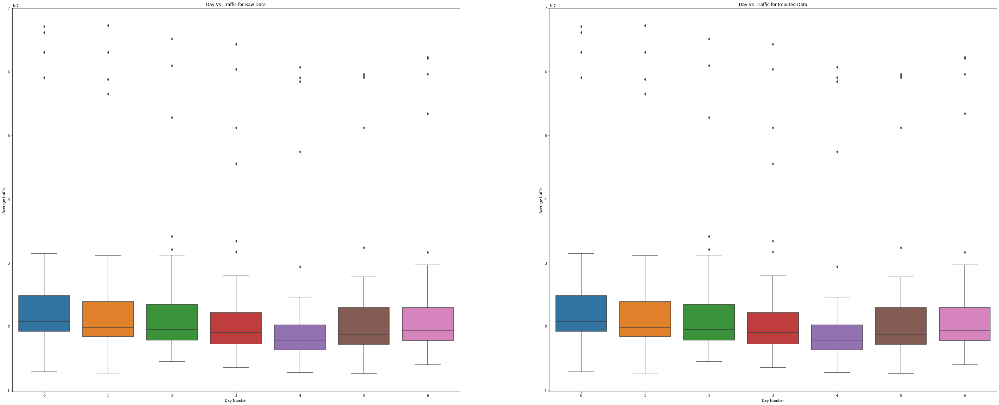

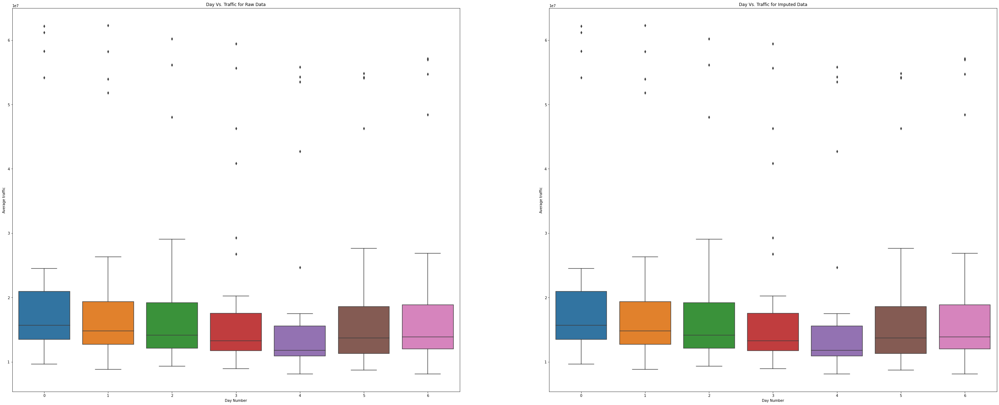

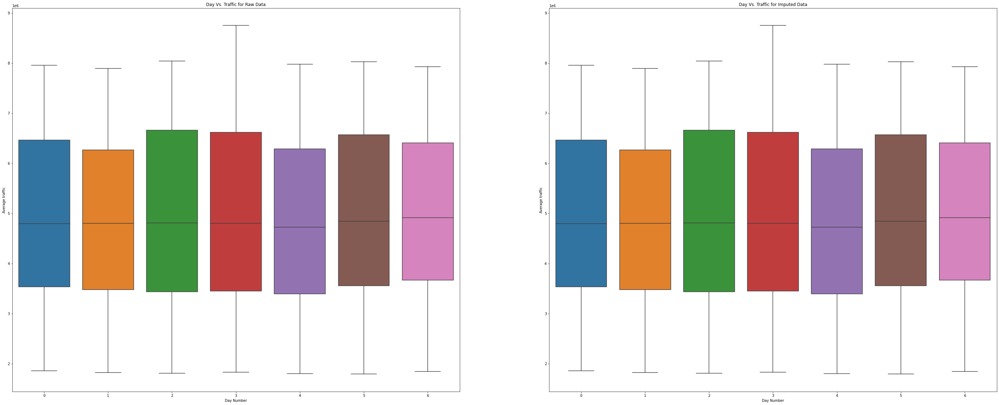

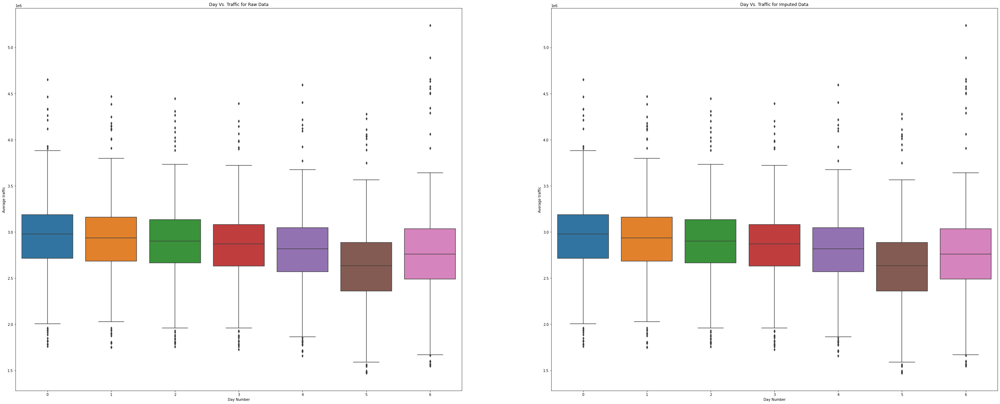

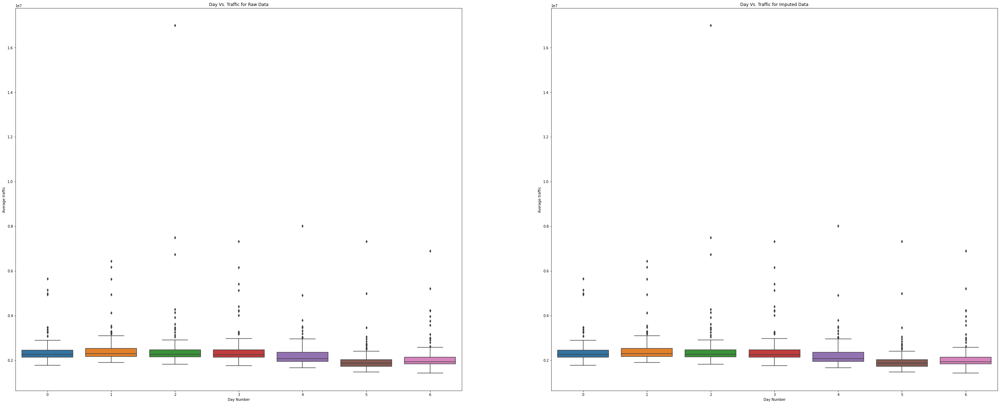

...

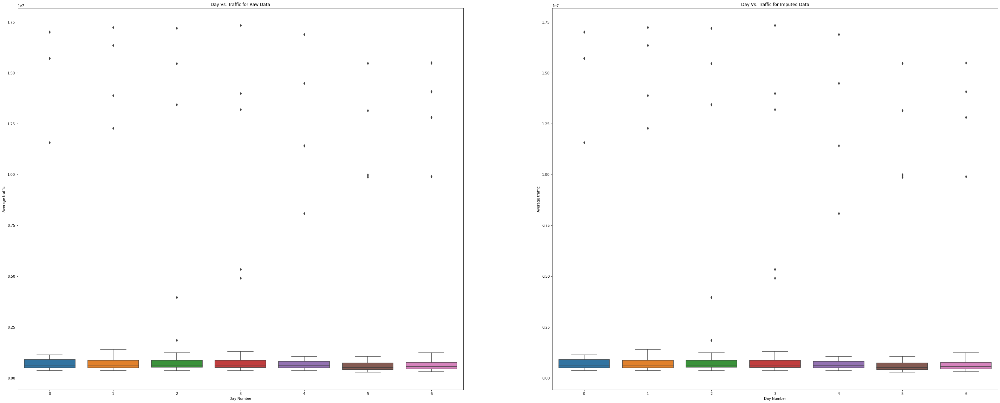

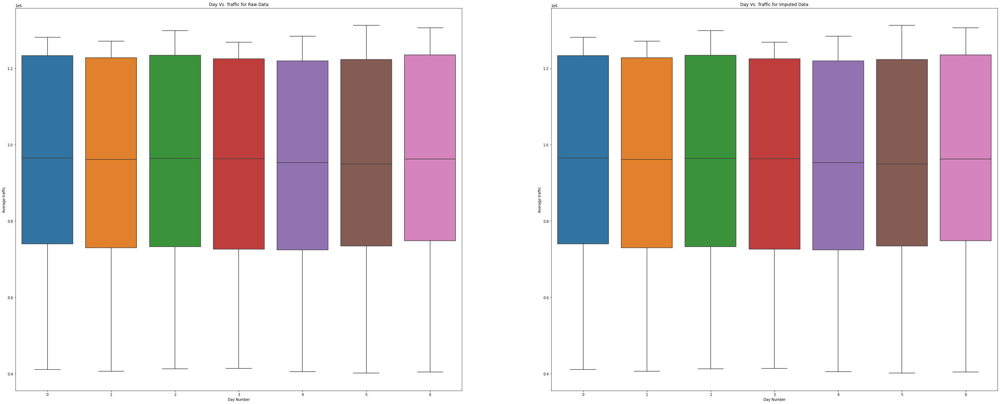

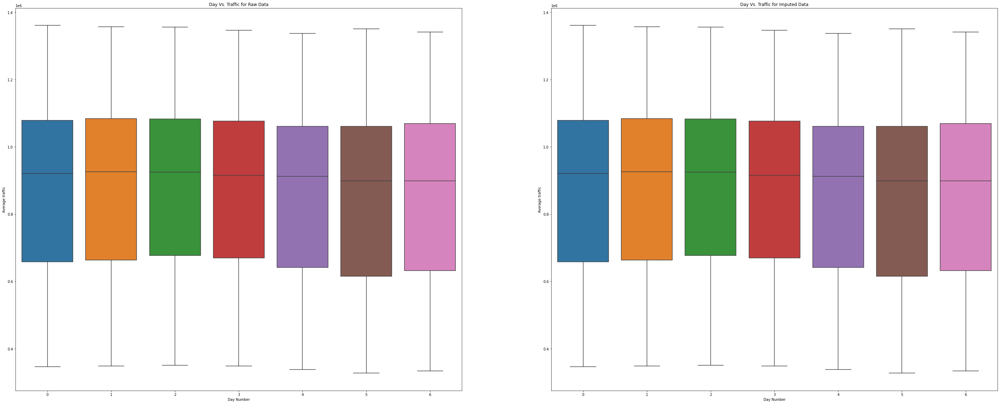

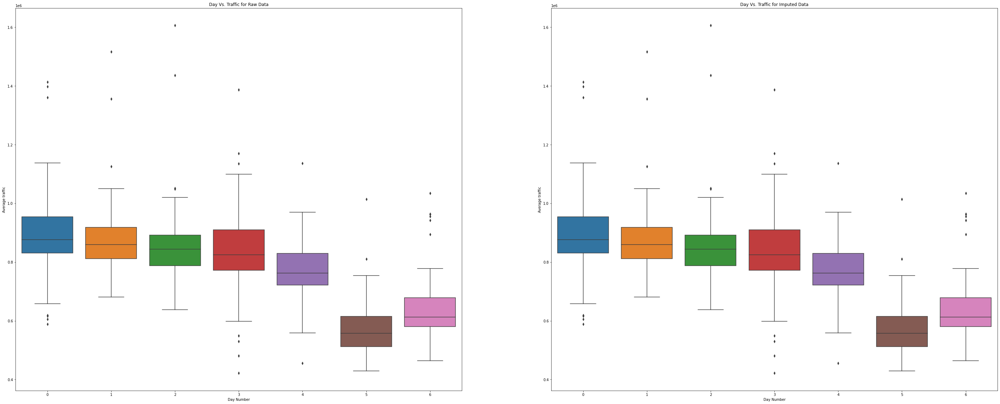

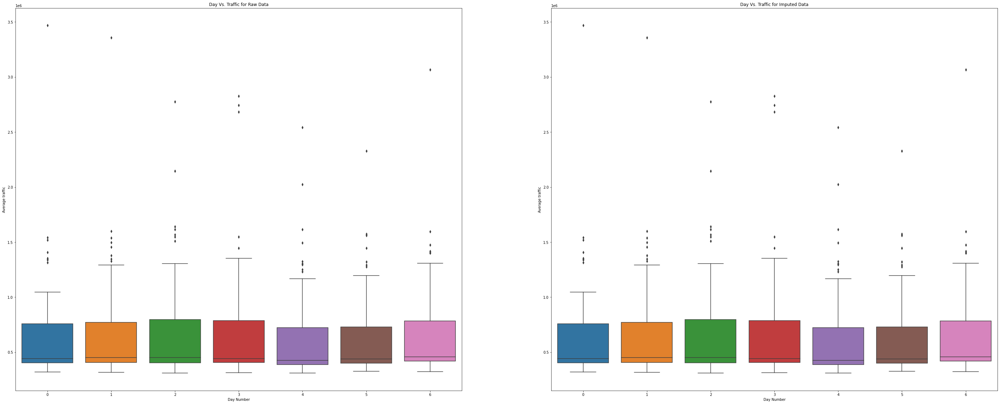

In [ ]:
# Boxplots of weekdays vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekday,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=weekday,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


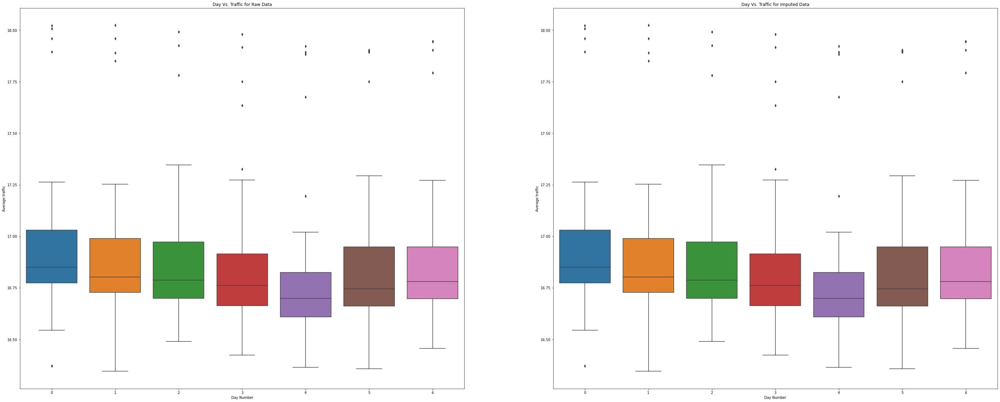

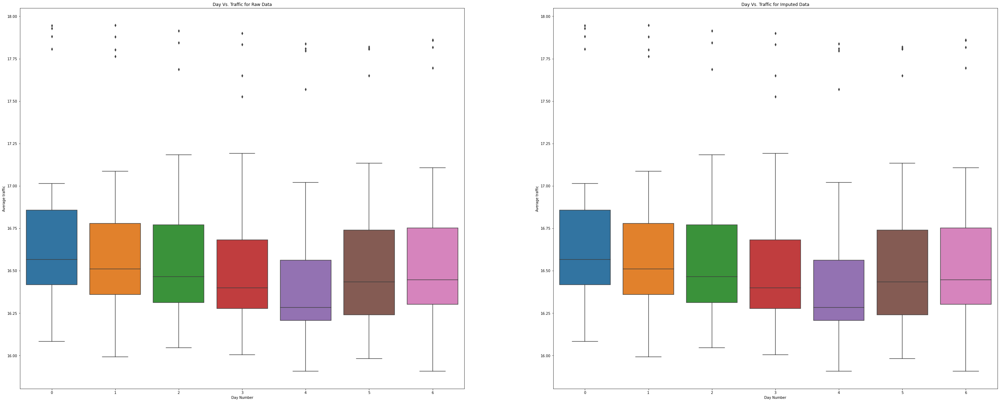

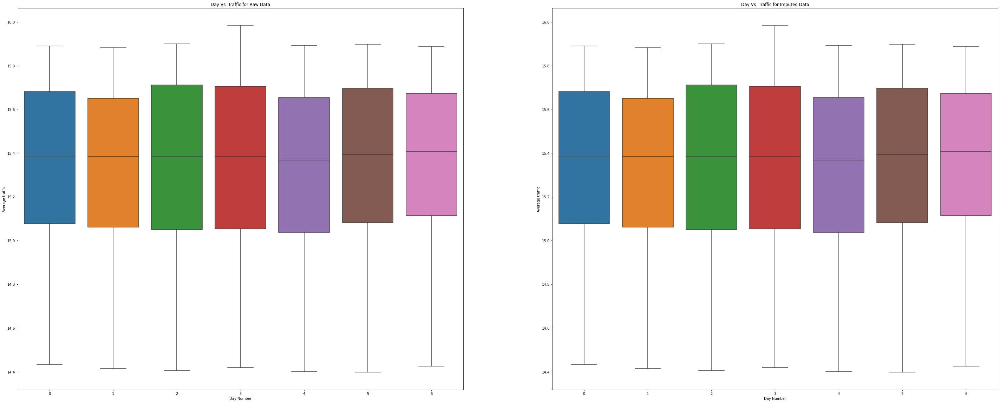

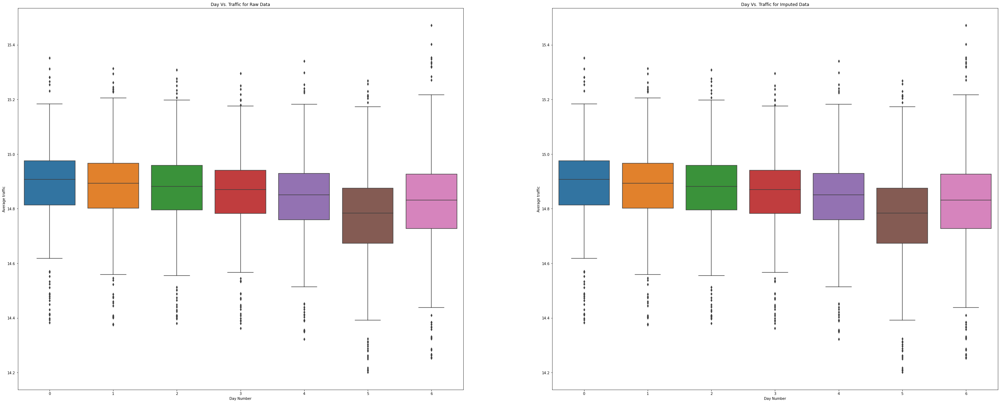

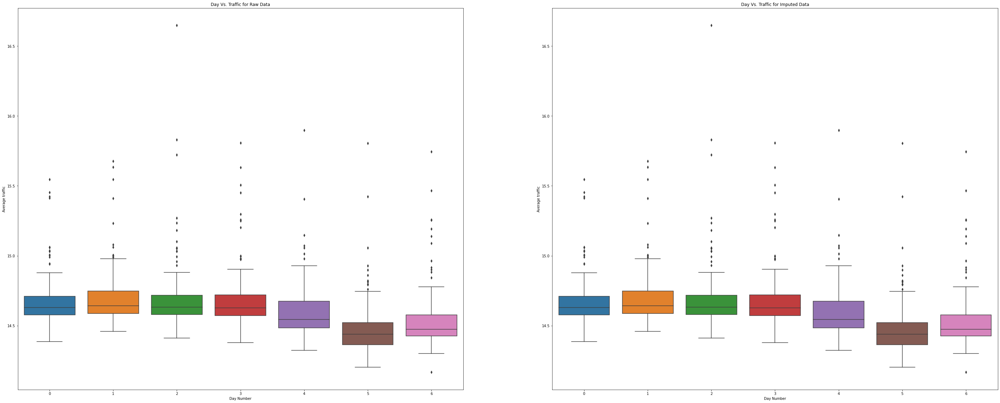

...

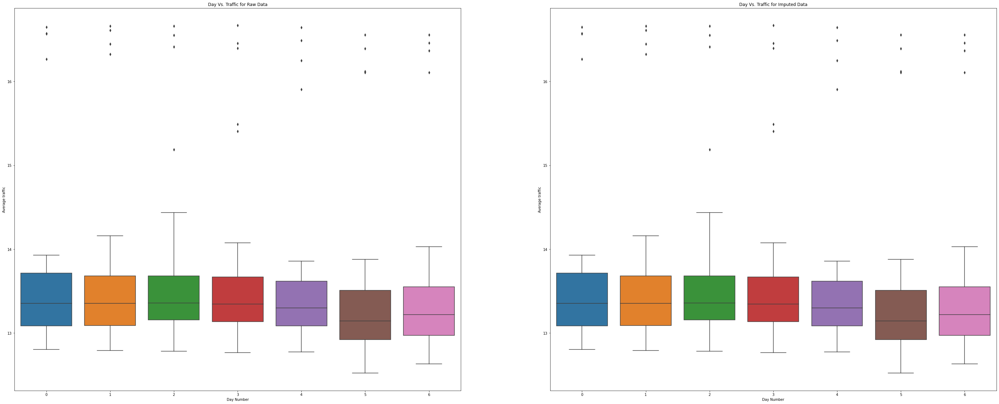

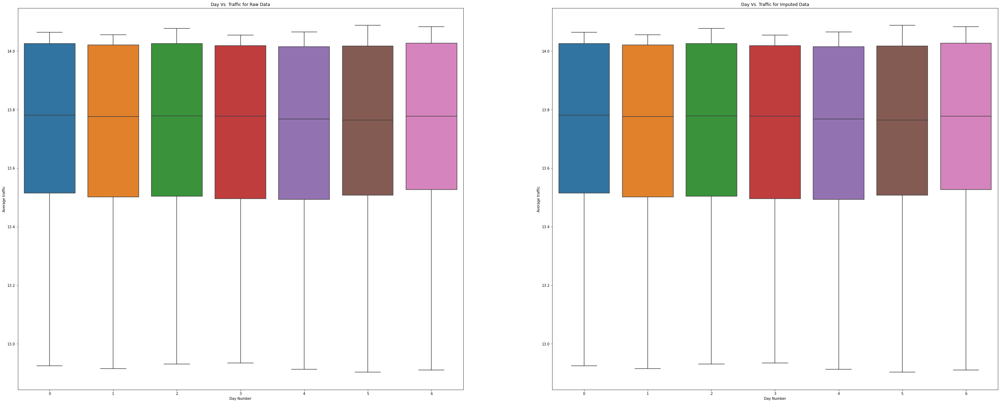

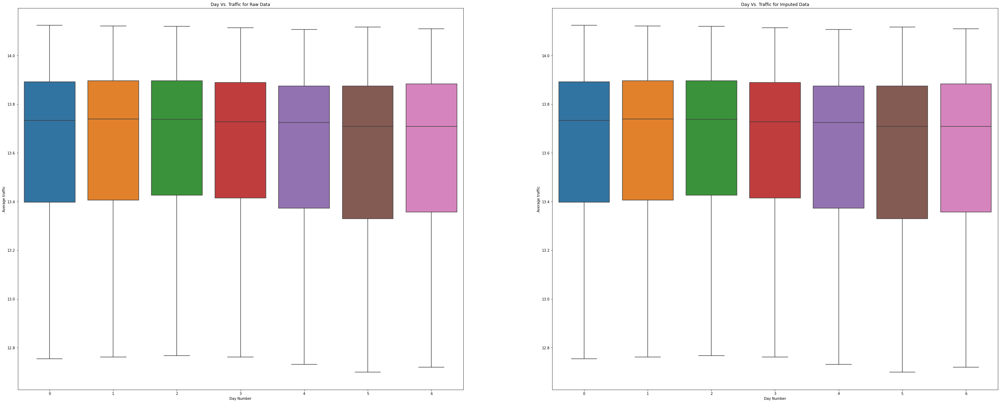

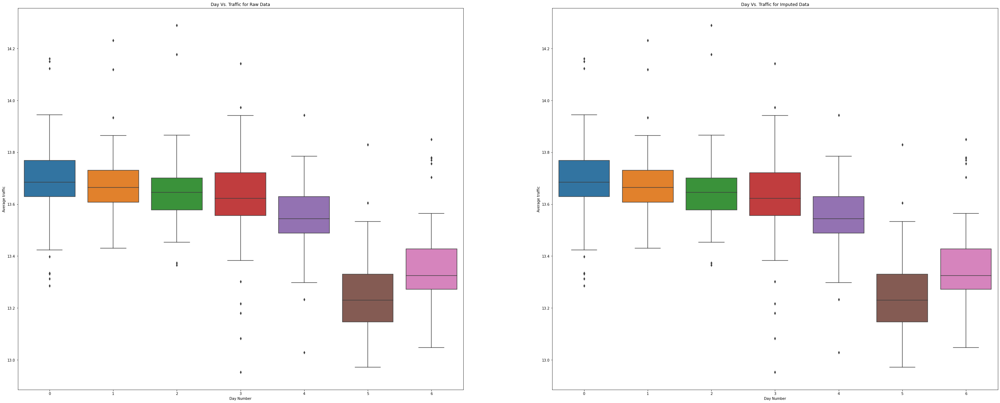

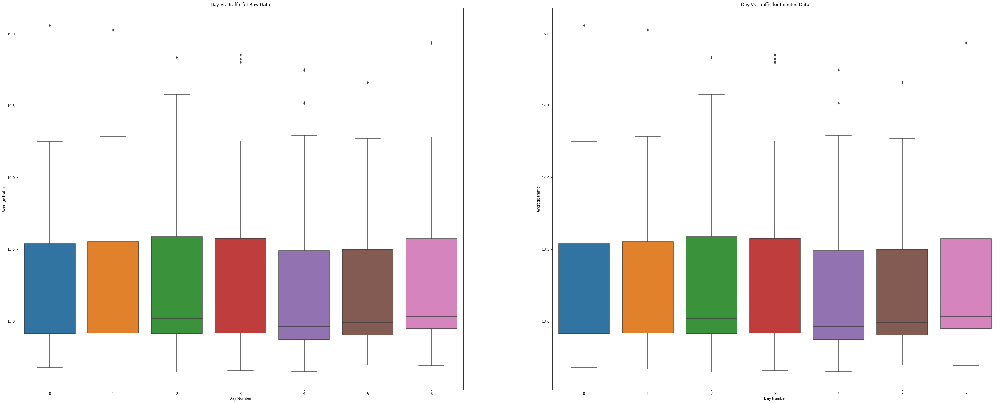

In [ ]:
# Boxplots of weekdays vs. average pagehits for log transformed data.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_log_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_log_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekday,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=weekday,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


This plot shows that on  Sunday or Monday , the average pageviews increase. Also there are differences between each weekday. In most cases there is a gradual drop in the pagehit values from Monday to Saturday and then there is an increase on Sunday which continues to Monday. So I will be including this weekday as a feature and also another feature as is_sunday_or_monday as their mean seem to be higher than the other days.

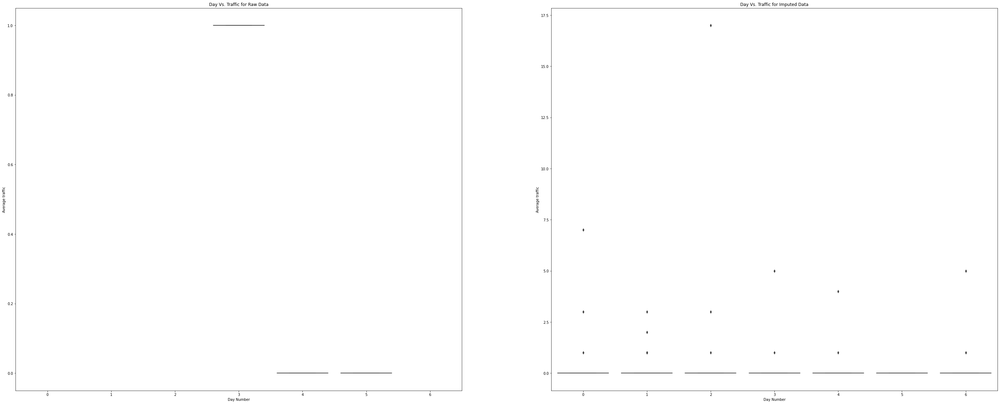

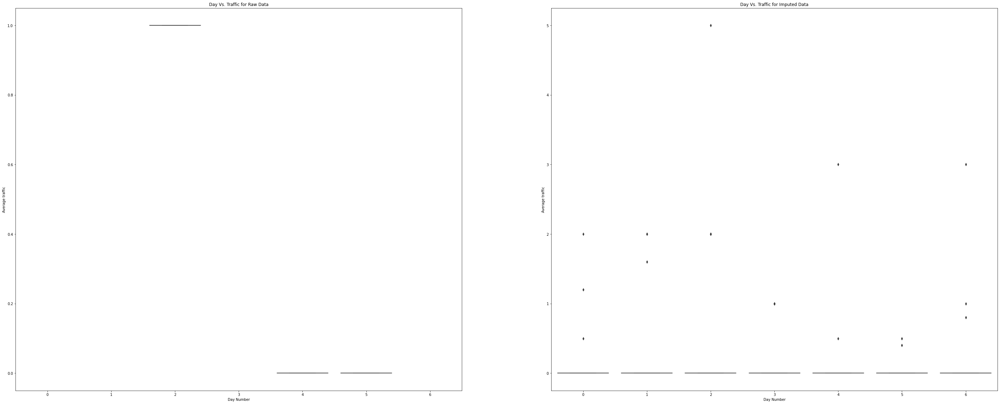

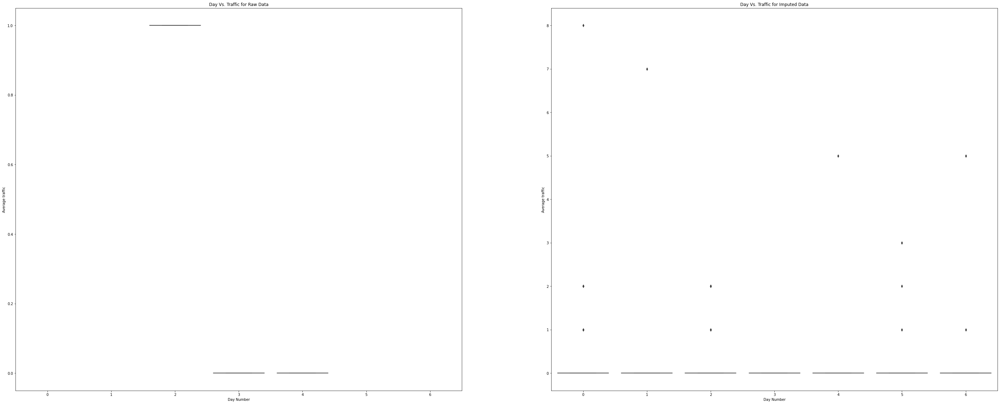

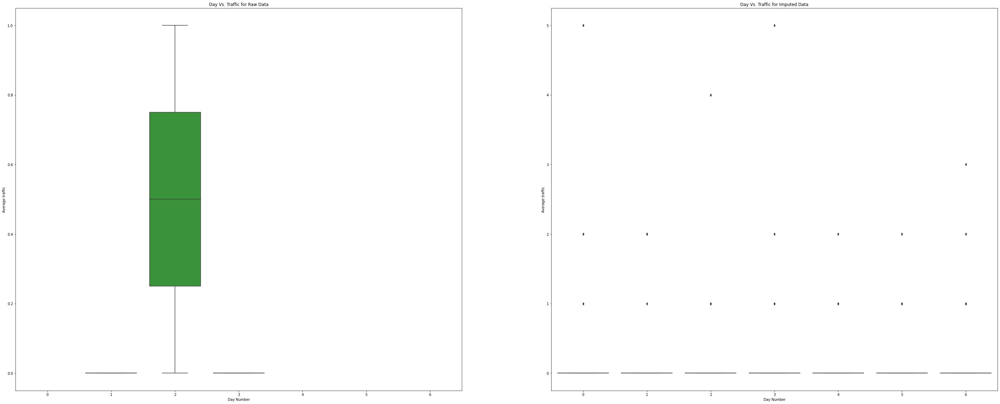

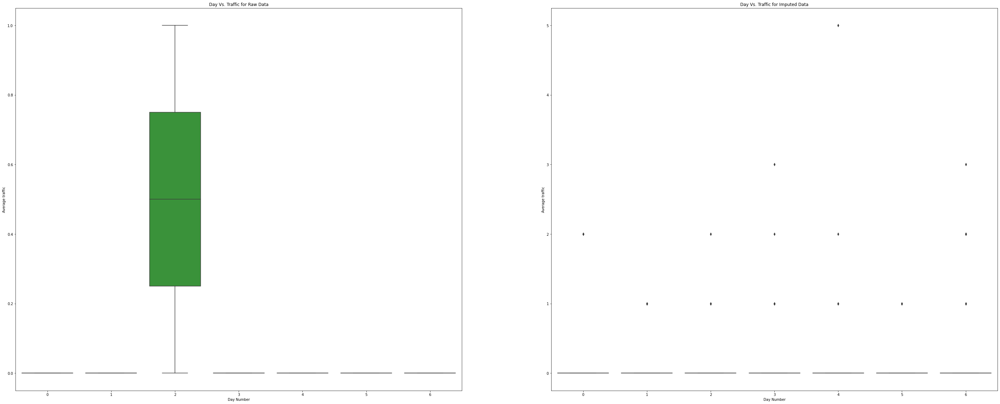

...

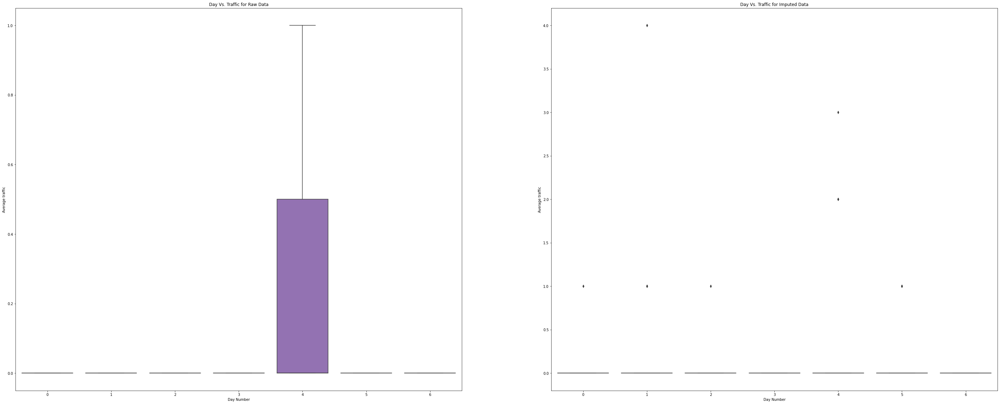

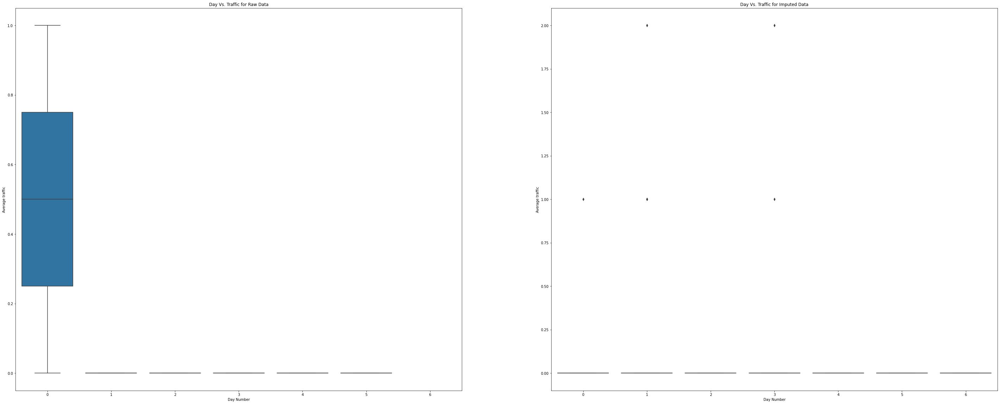

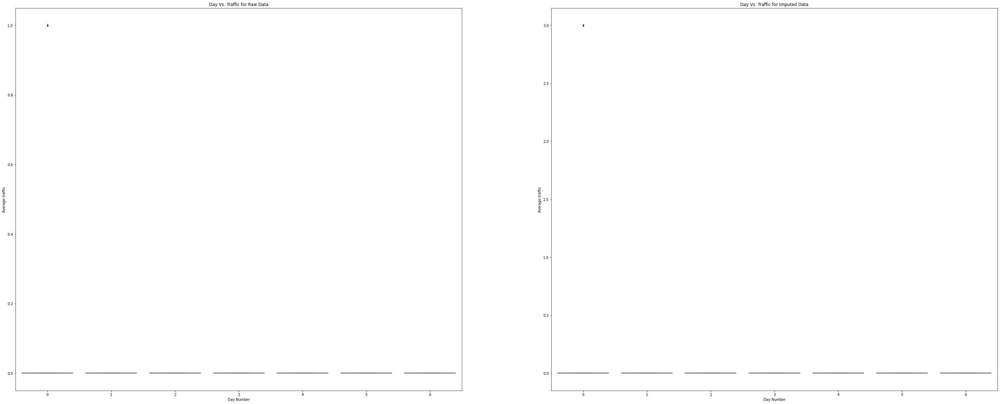

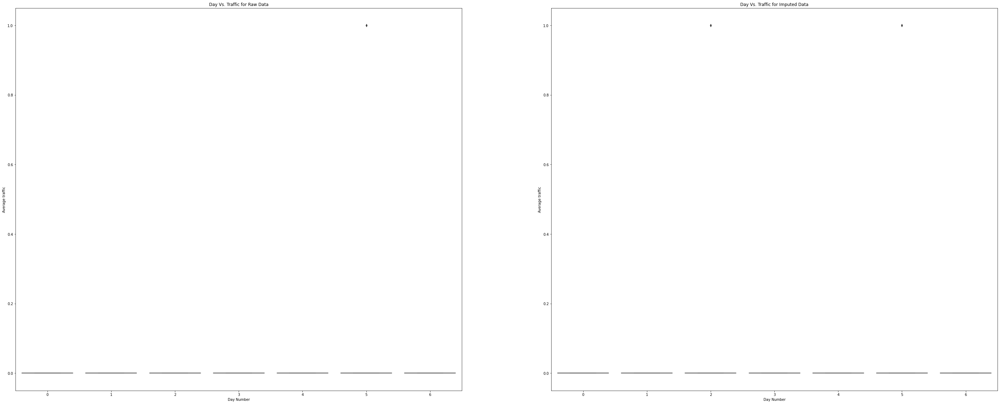

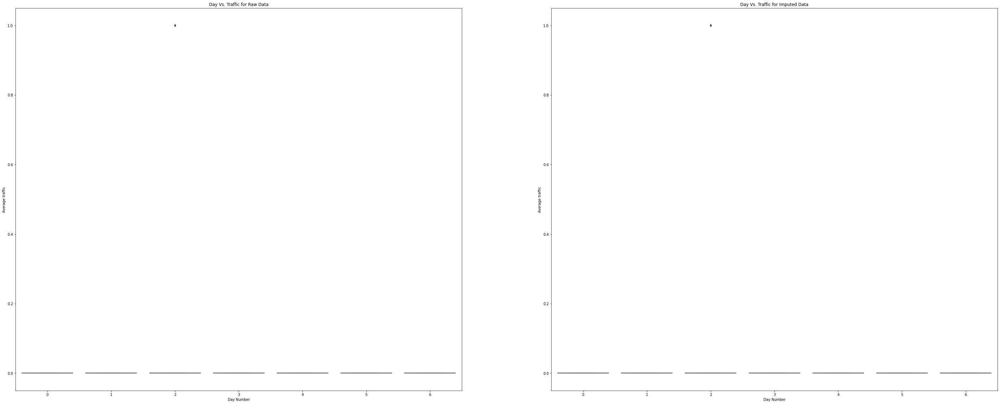

In [ ]:
# Boxplots of weekdays vs. average pagehits for last 15 pages.
import seaborn as sns
for i in range(0,15):
    rawhits=last_15_raw.iloc[i,1:train.shape[1]].values
    imphits=last_15_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekday,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=weekday,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


I could not derive anything meaningful from these plots as the view percentage is too less

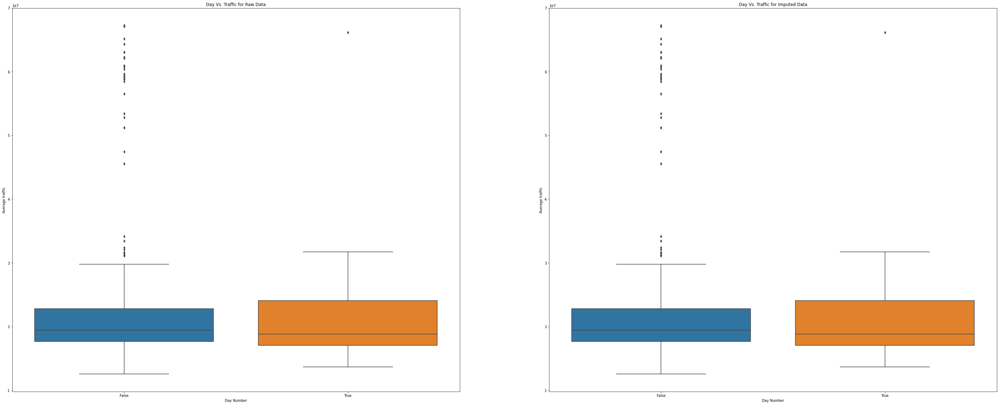

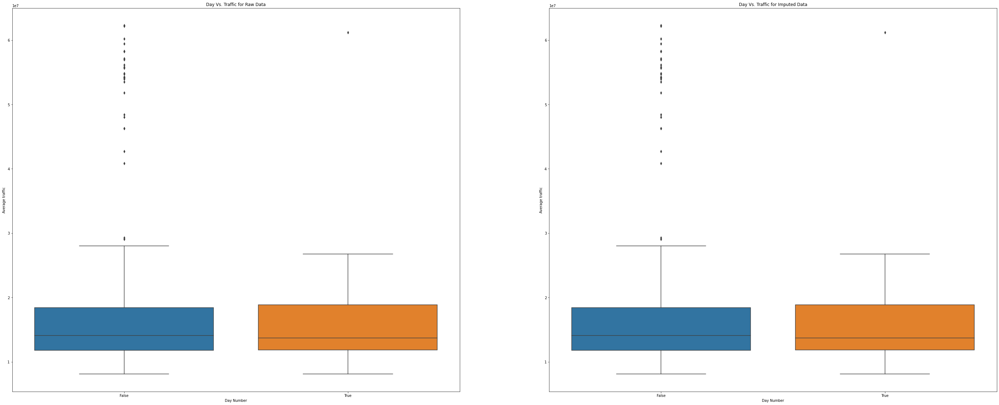

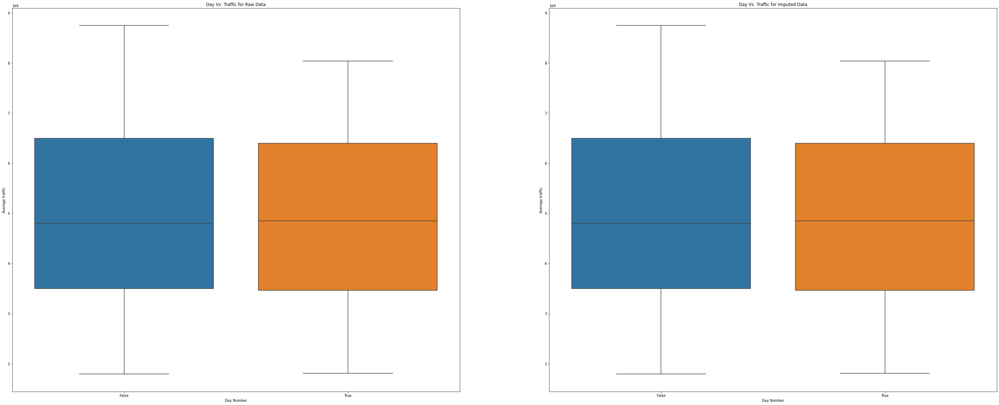

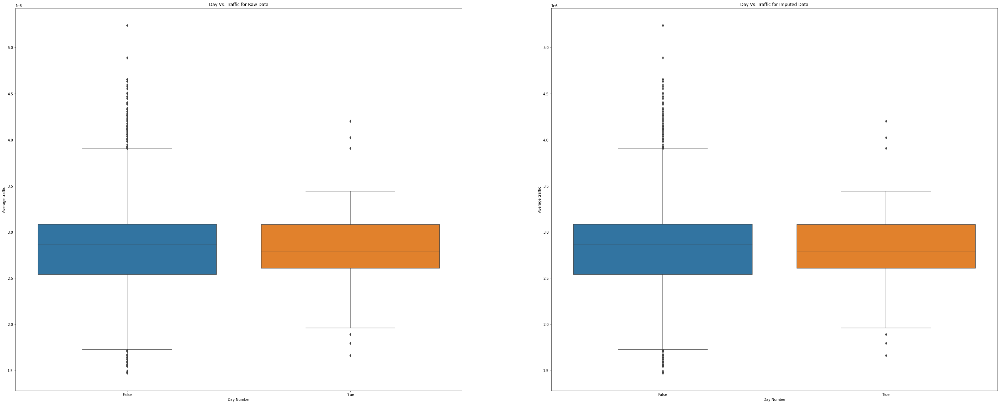

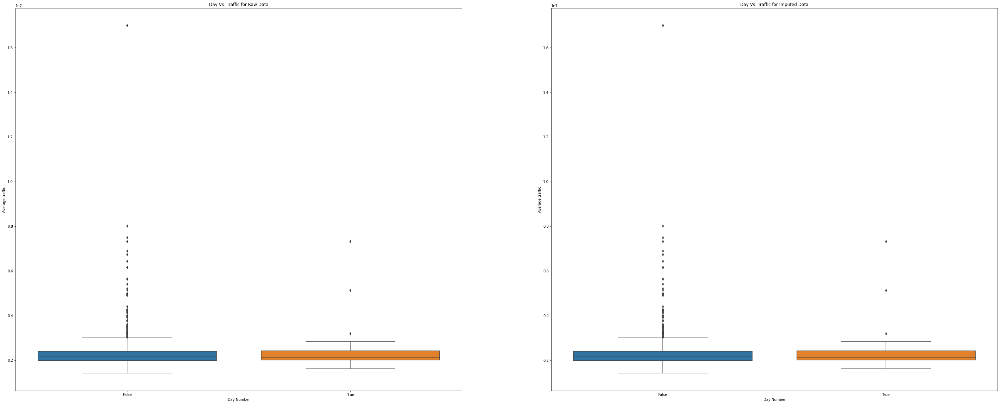

...

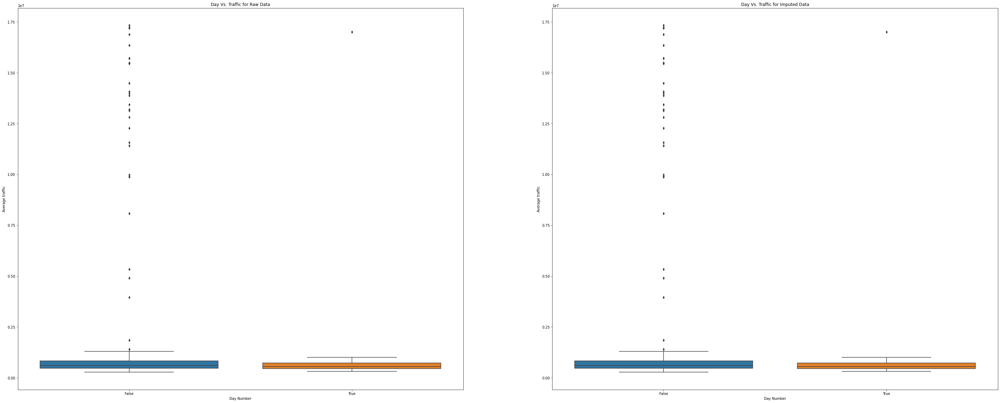

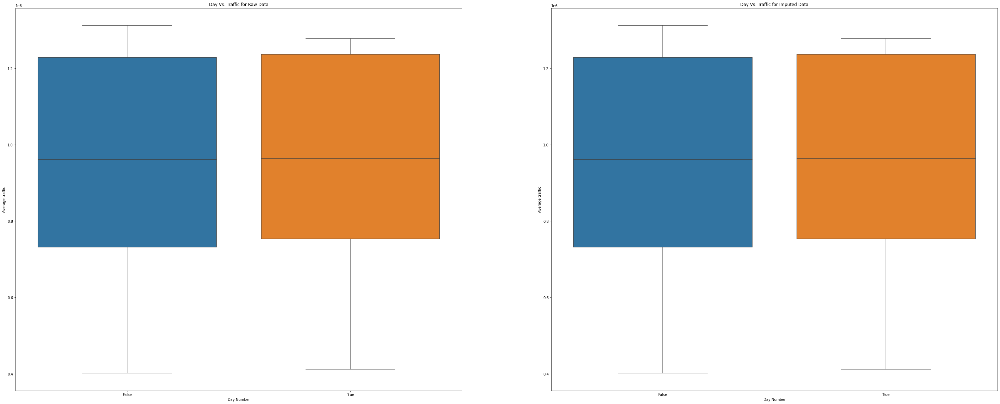

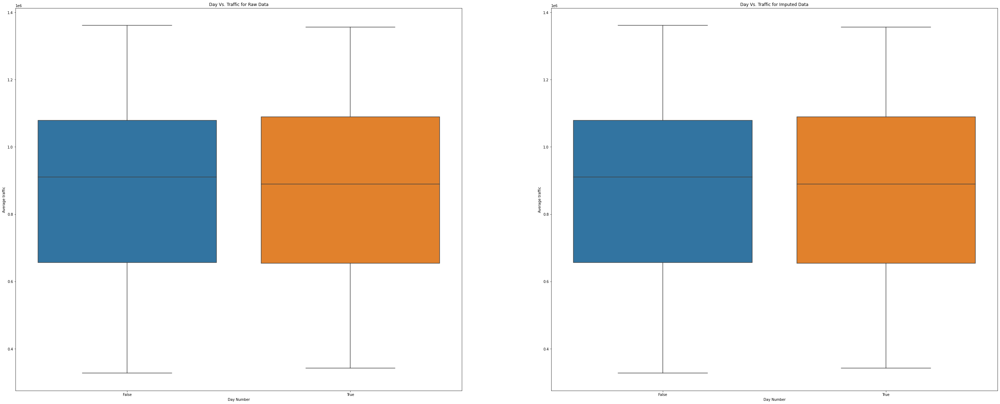

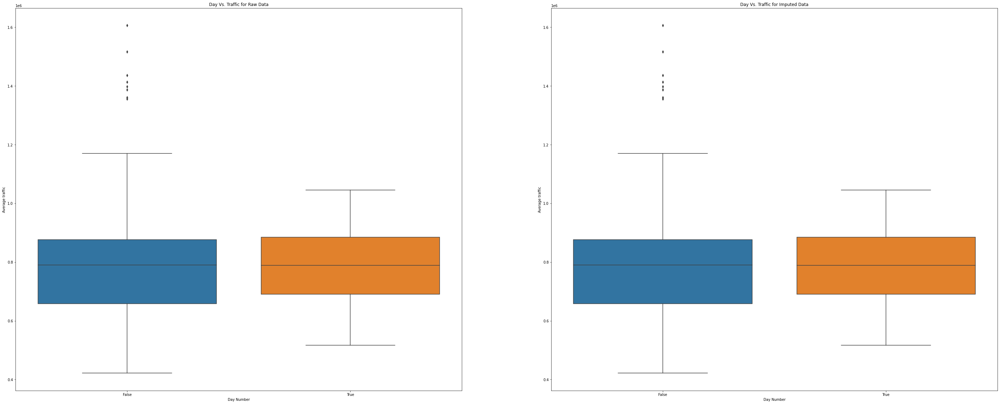

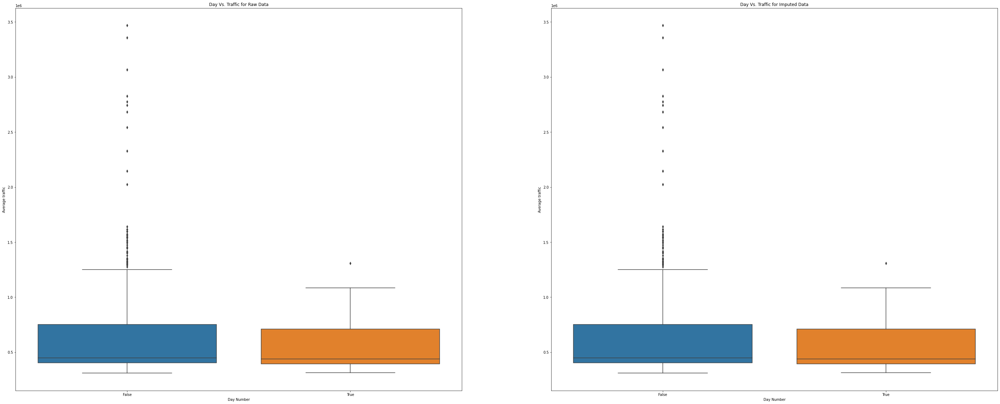

In [ ]:
# Boxplots of month_start vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month_start,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=month_start,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


There are very few days that fall on the first day of the month , but we see that the boxplot mean and  IQR is aprroximately same for both the month starting days and other ones.This suggests that the traffic on month start is quite high as compared to other days . So it is important to include this as a feature .

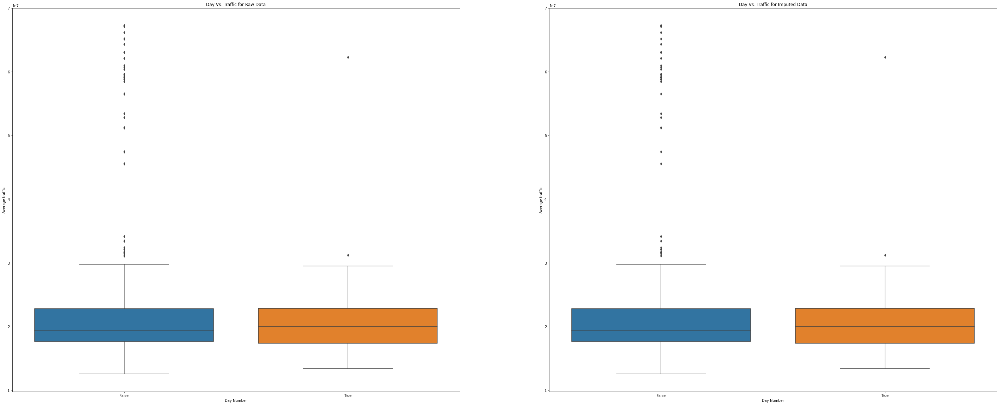

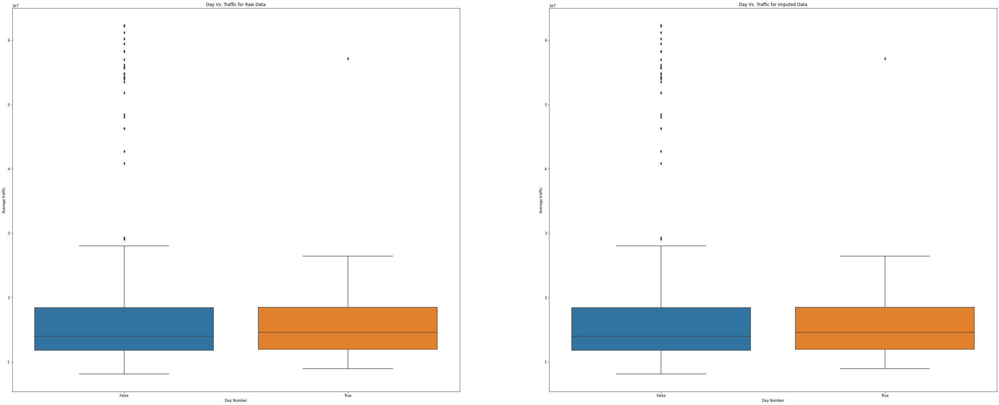

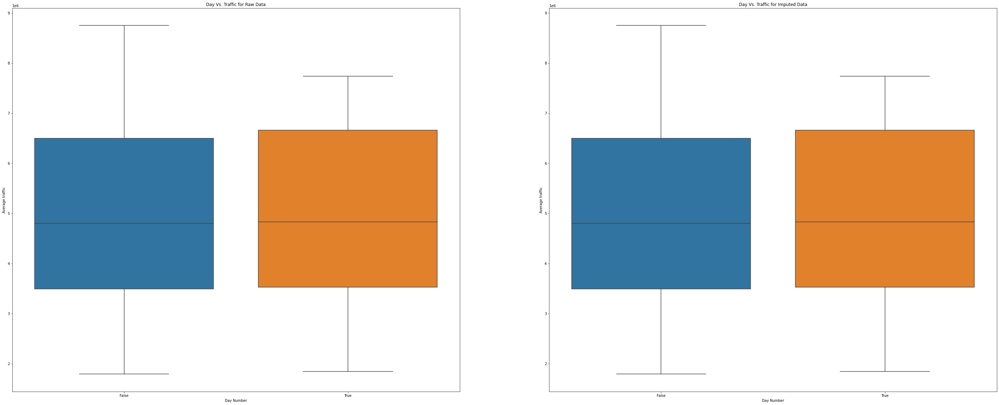

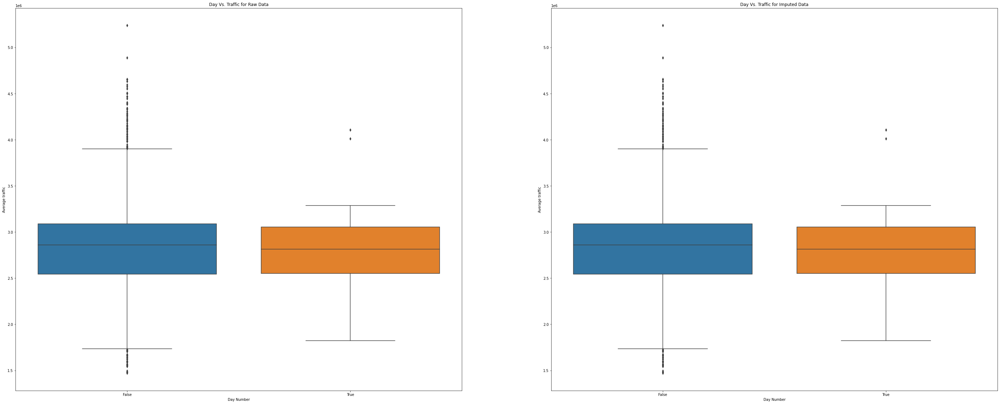

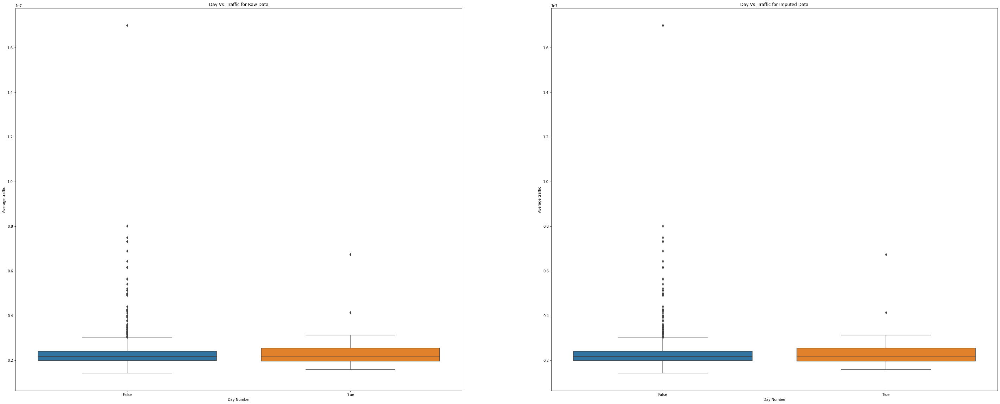

...

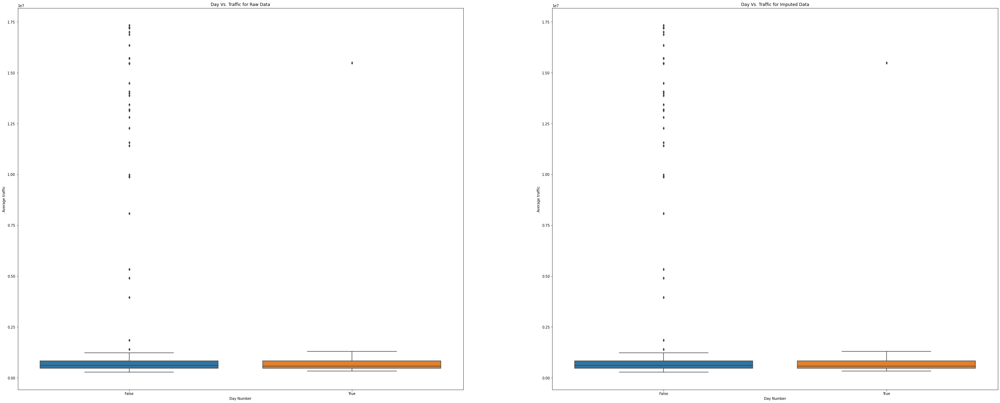

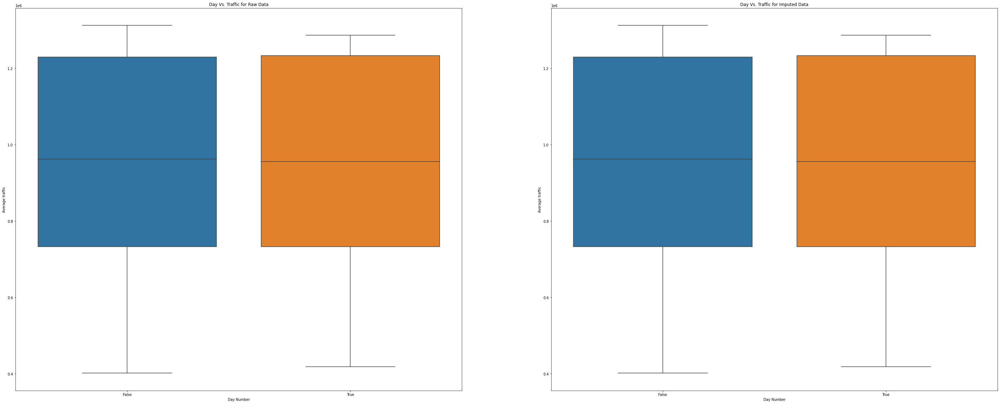

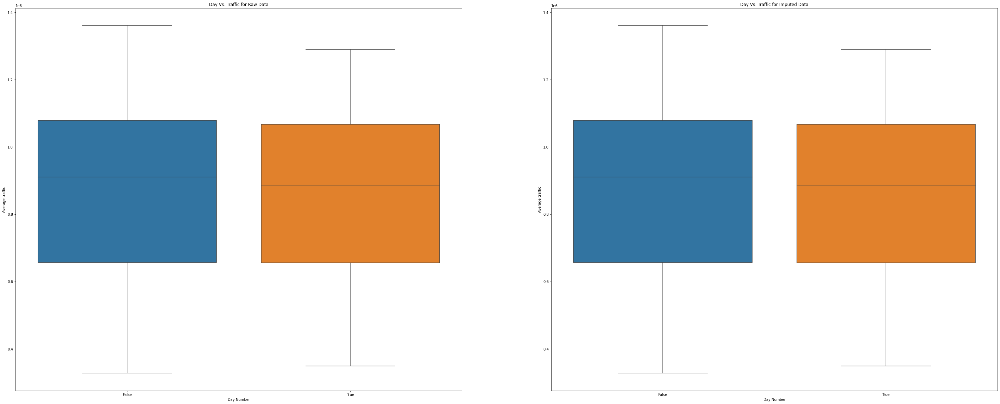

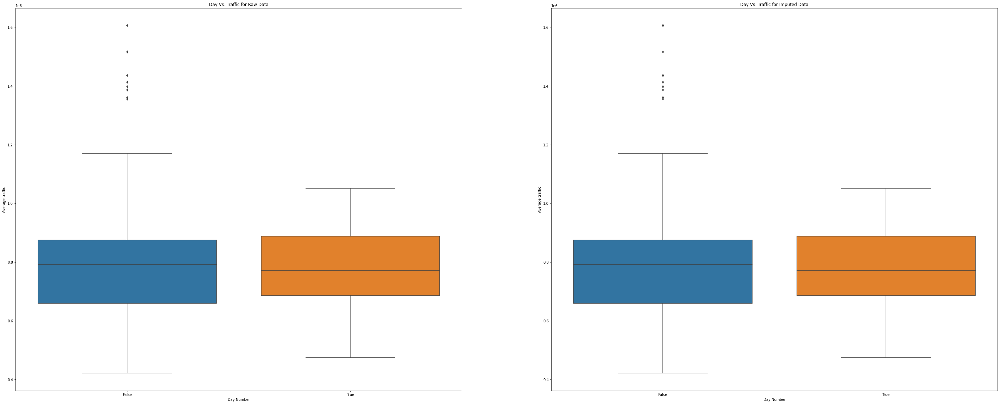

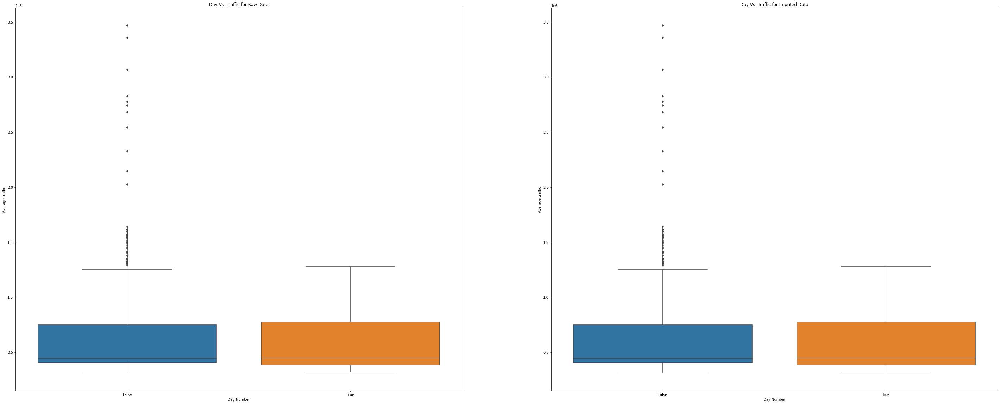

In [ ]:
# Boxplots of month_end vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month_end,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=month_end,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- I see a similar trend as the month_start feature 
- The boxplot for month_end days is in fact has higher IQR and similar median value as other days
- This tells us that the days conecting the months have significantly higher traffic as compared to other days.

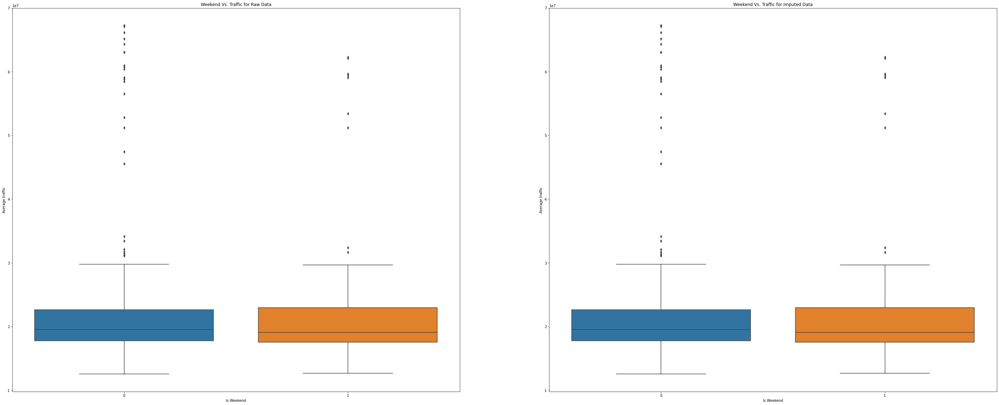

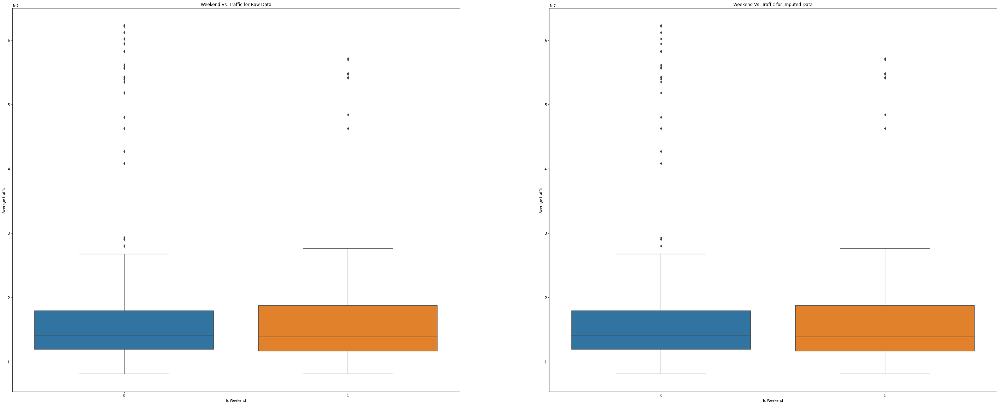

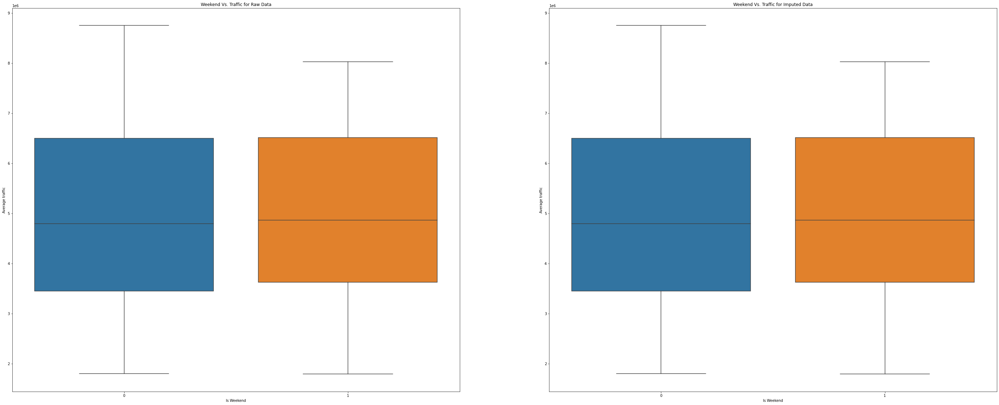

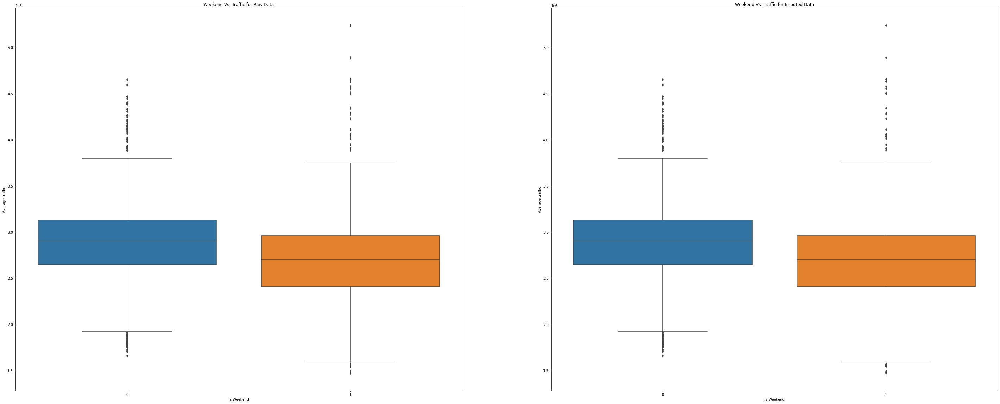

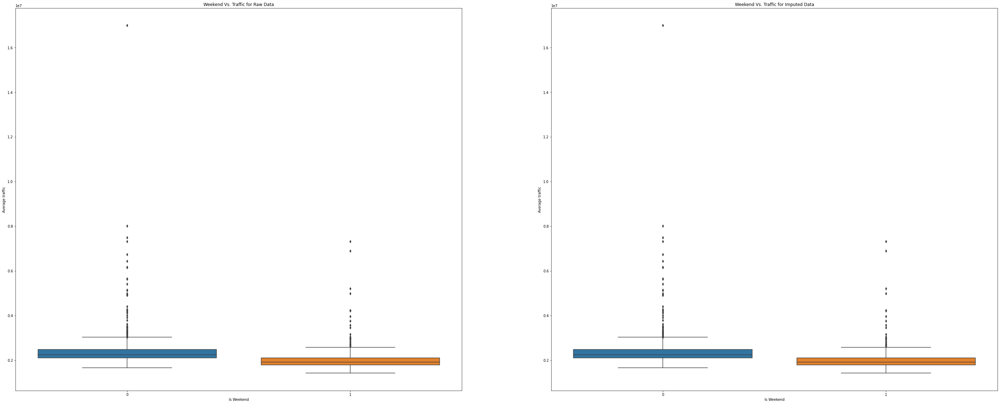

...

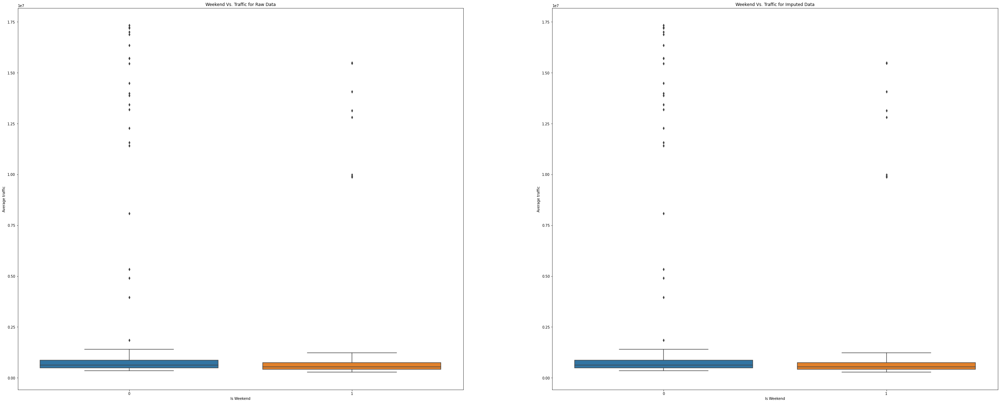

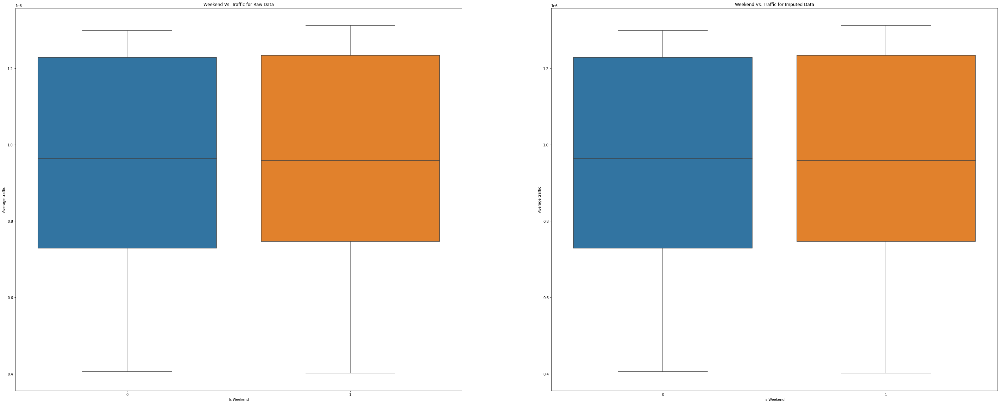

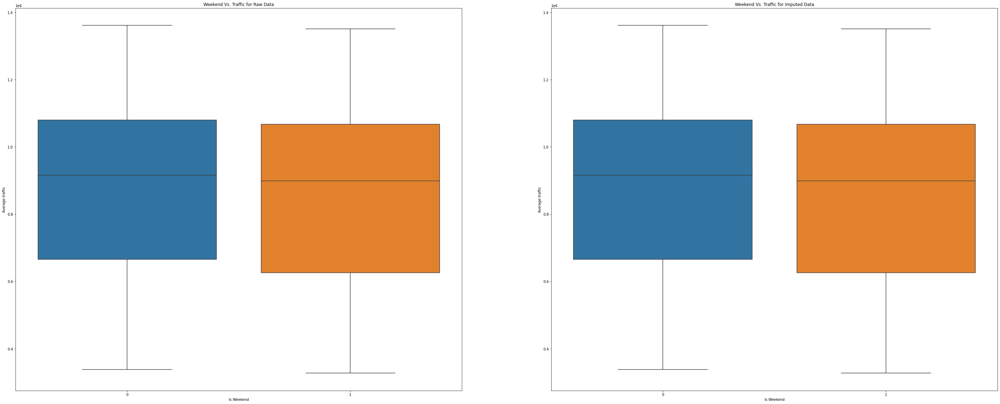

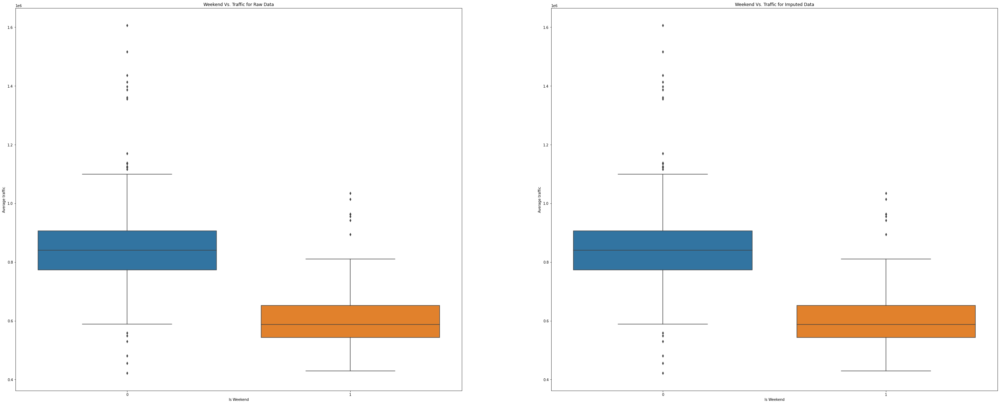

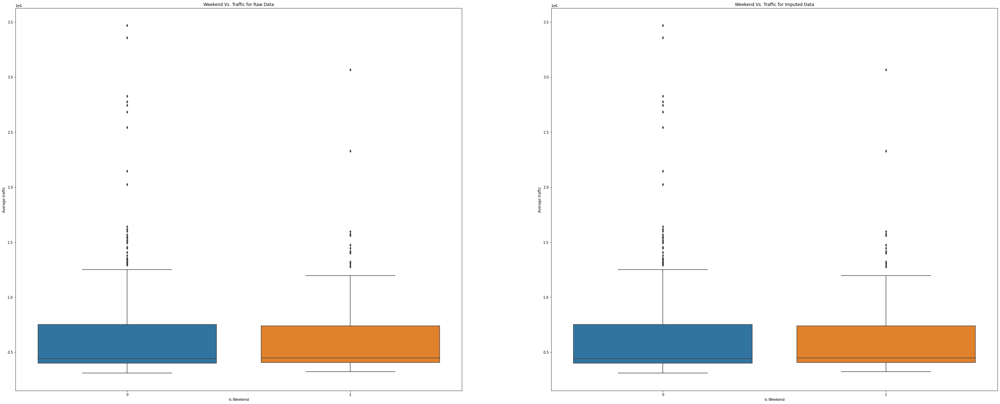

In [ ]:
# Boxplots of is_weekend vs. average pagehits.

import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekend,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Is Weekend')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Weekend Vs. Traffic for Raw Data')
    sns.boxplot(x=weekend,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Is Weekend')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Weekend Vs. Traffic for Imputed Data')
    
    plt.show()


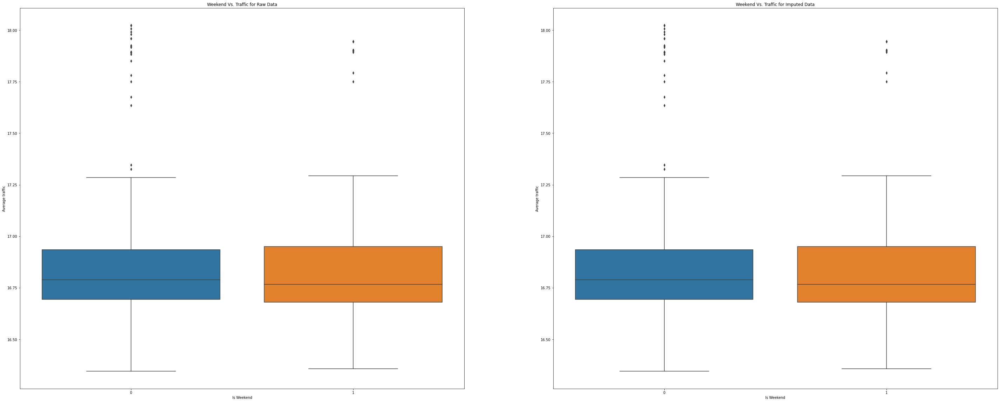

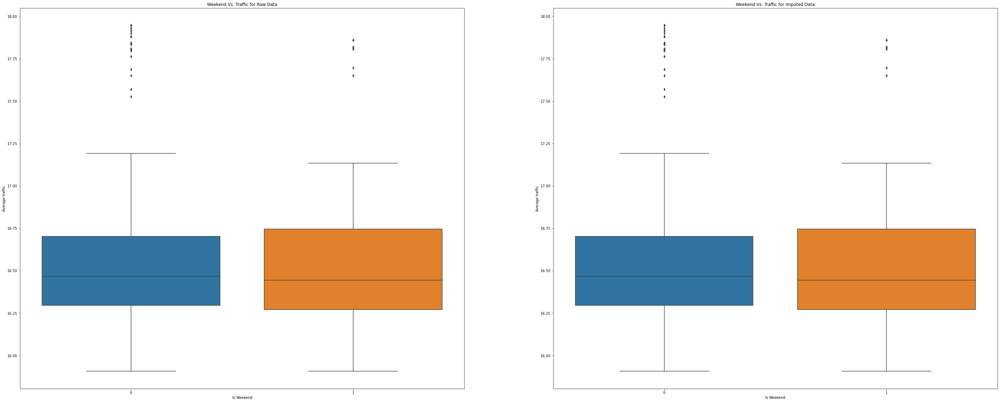

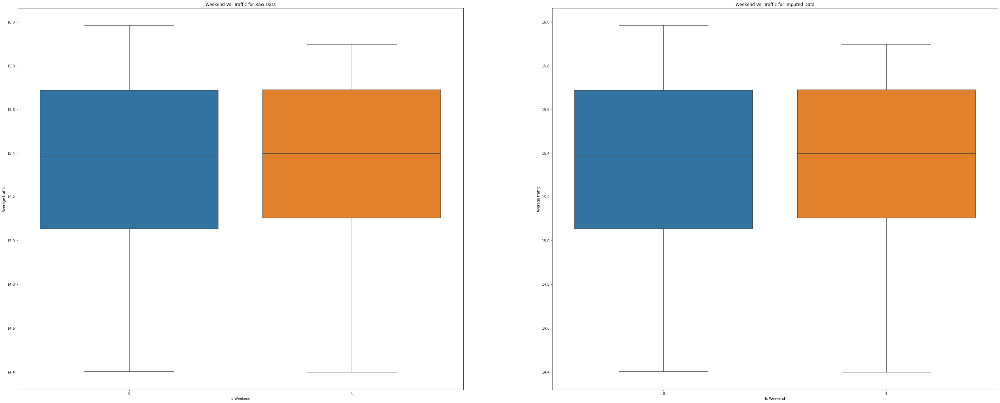

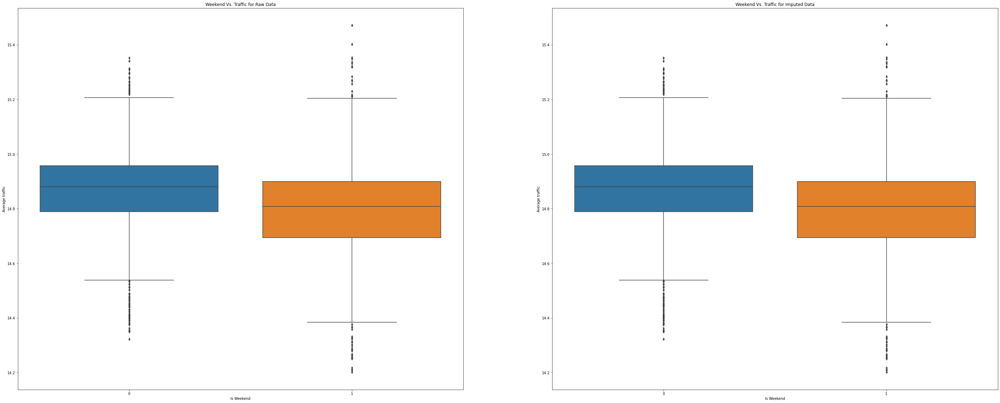

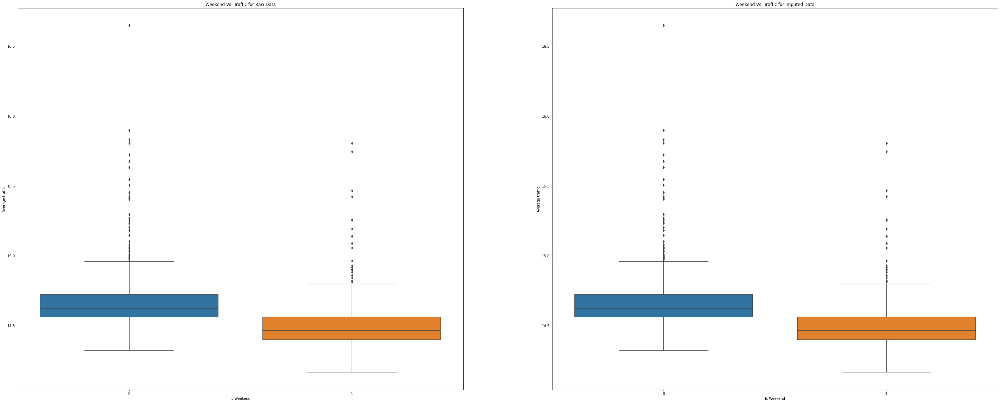

...

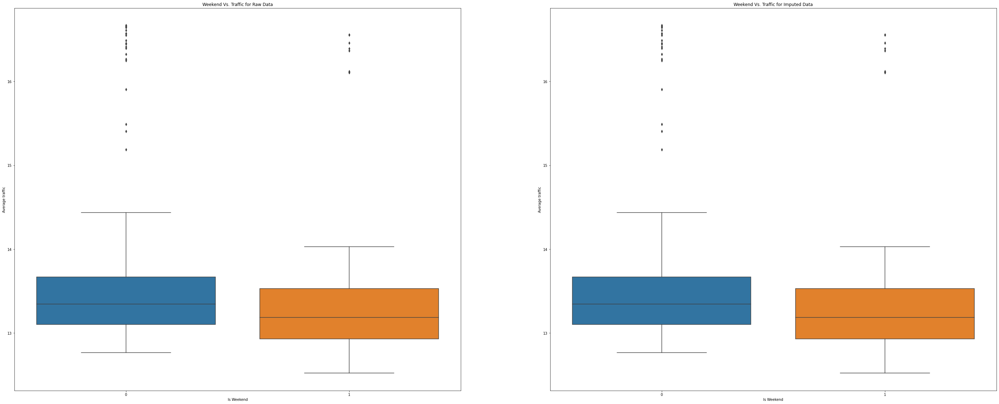

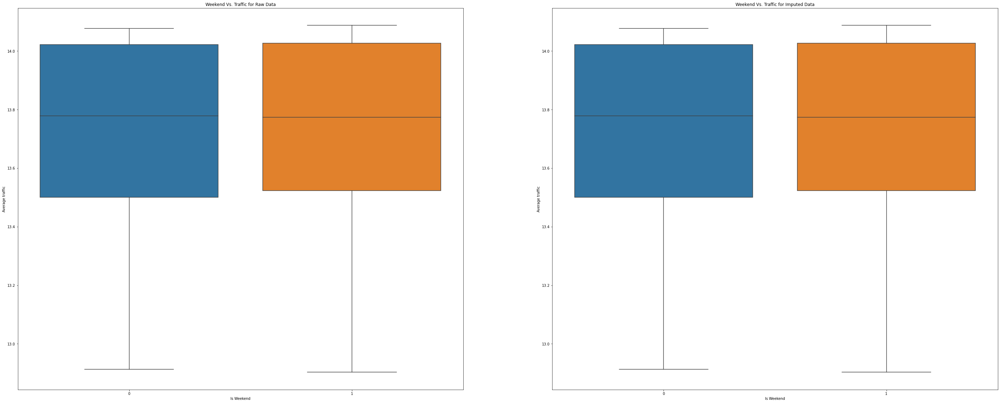

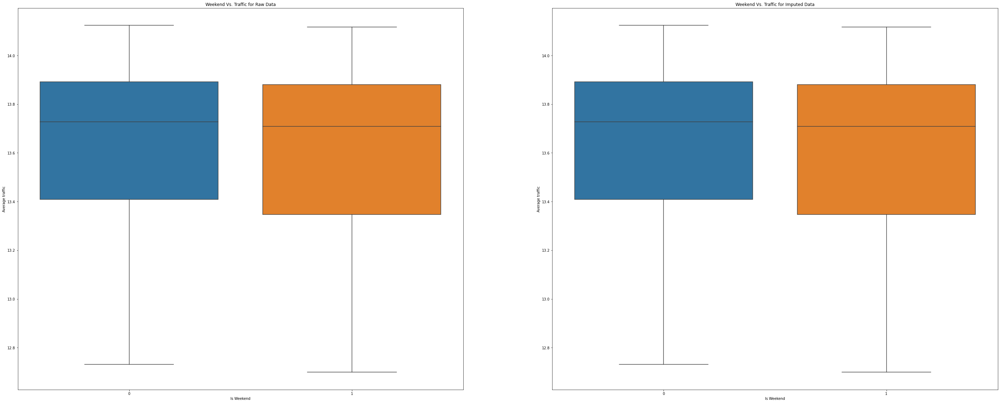

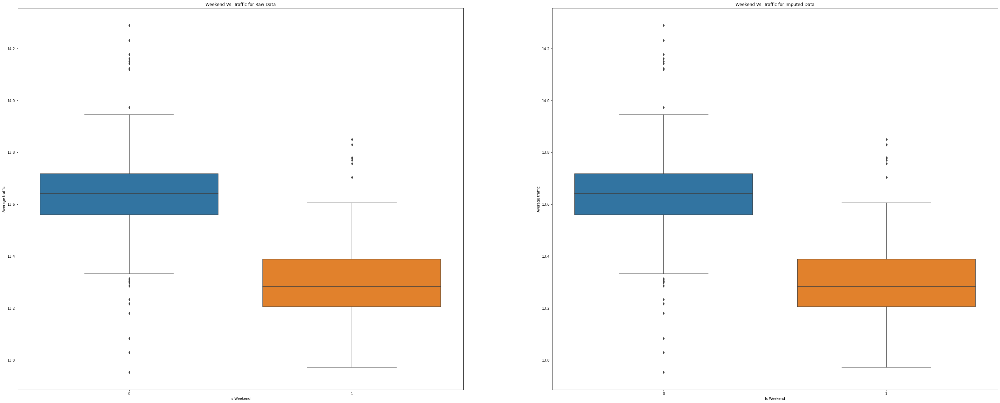

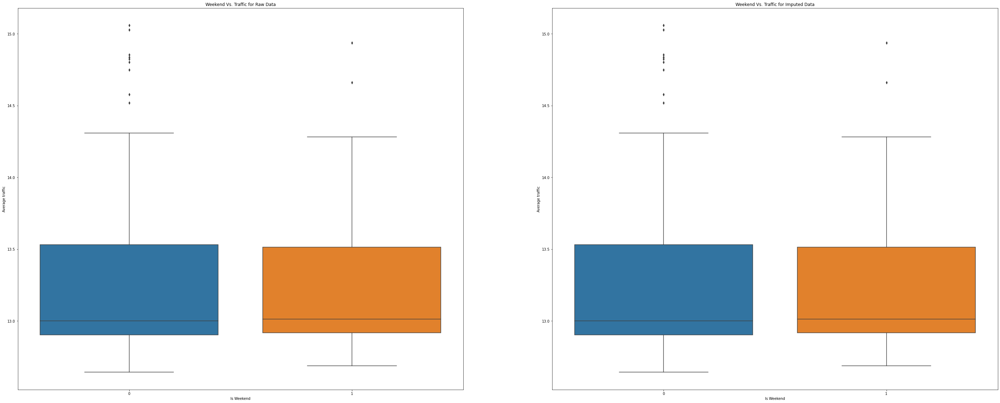

In [ ]:
# Boxplots of is_weekend vs. average pagehits  for transformed data

import seaborn as sns
for i in range(0,15):
    rawhits=eda_log_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_log_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=weekend,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Is Weekend')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Weekend Vs. Traffic for Raw Data')
    sns.boxplot(x=weekend,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Is Weekend')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Weekend Vs. Traffic for Imputed Data')
    
    plt.show()


- There is not much difference in boxplots of weekdays and weekends .
- IQR is approximately same and the median is higher for weekends in some cases.
- But there are less number of days in weekends so the IQR and median should have been less than weekdays.
- This suggests that the traffic is higher on weekends as compared to weekdays.

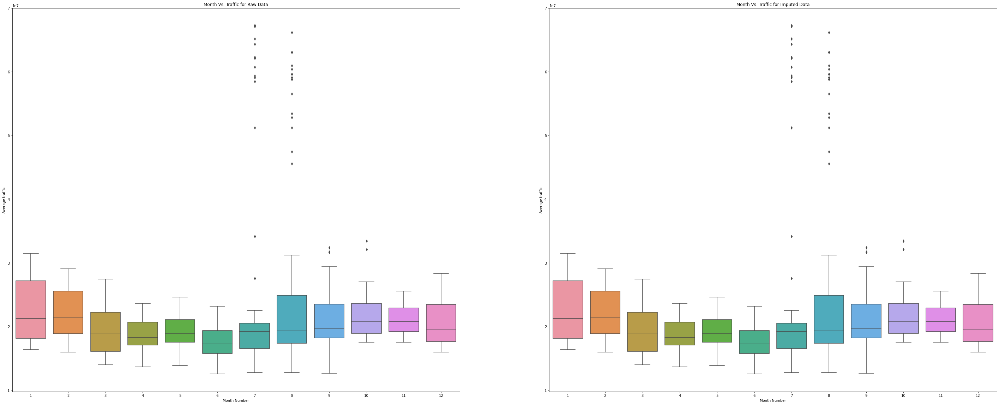

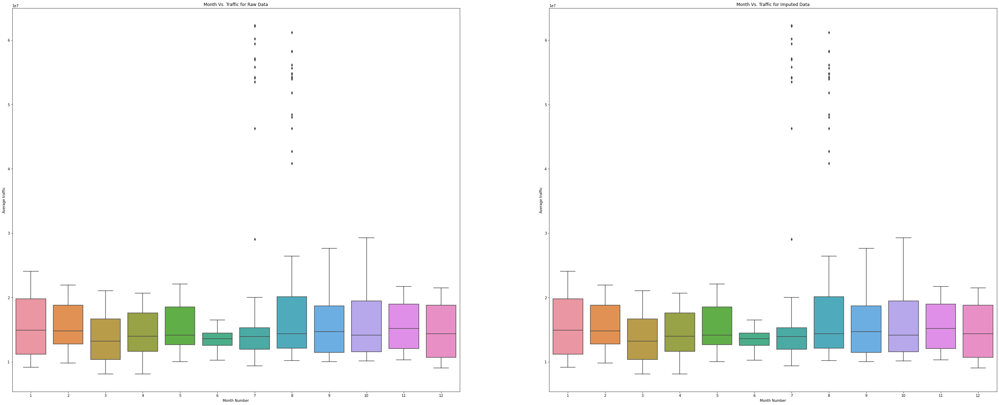

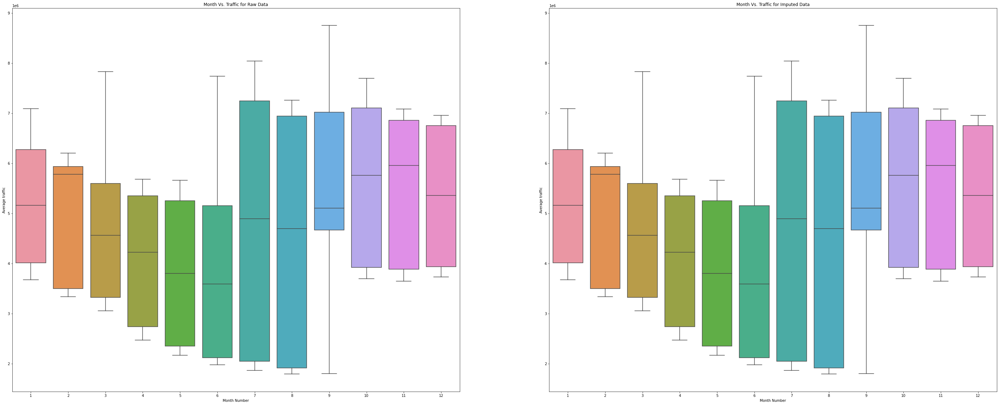

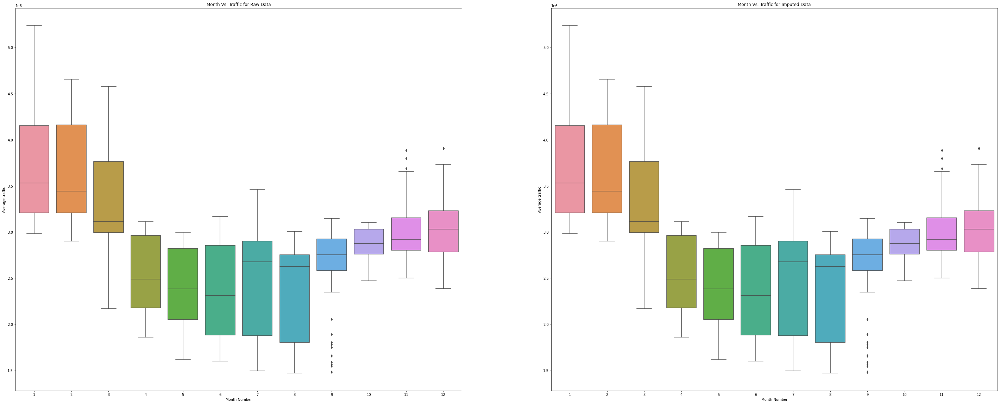

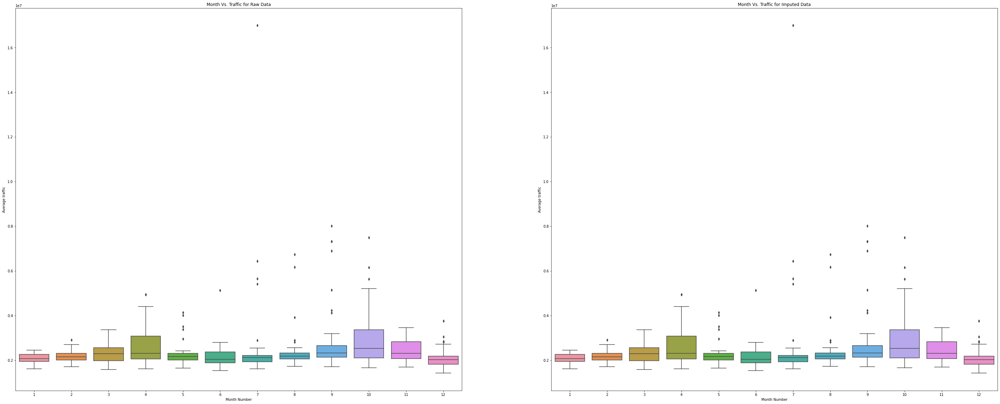

...

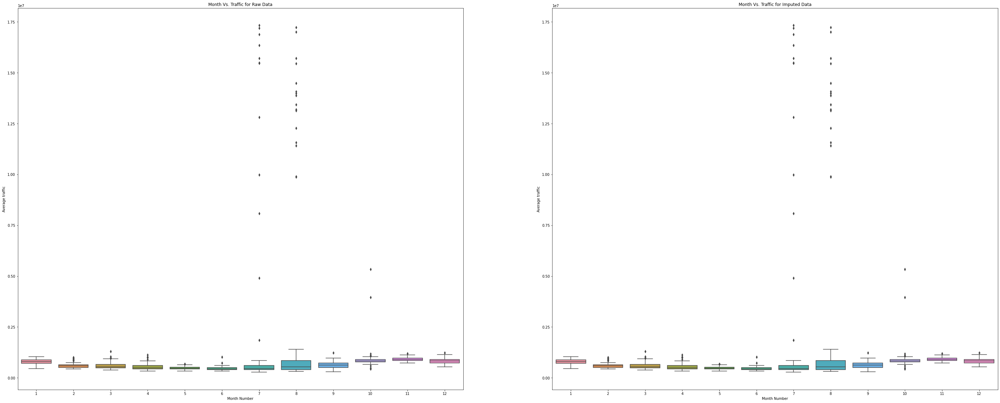

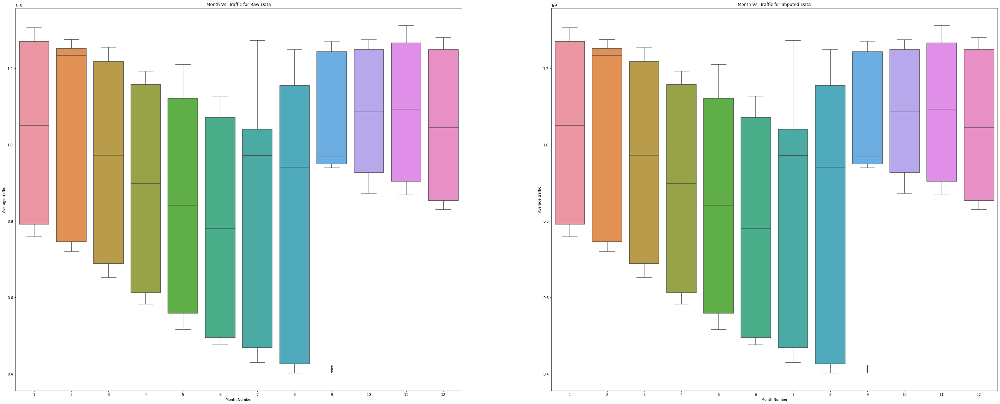

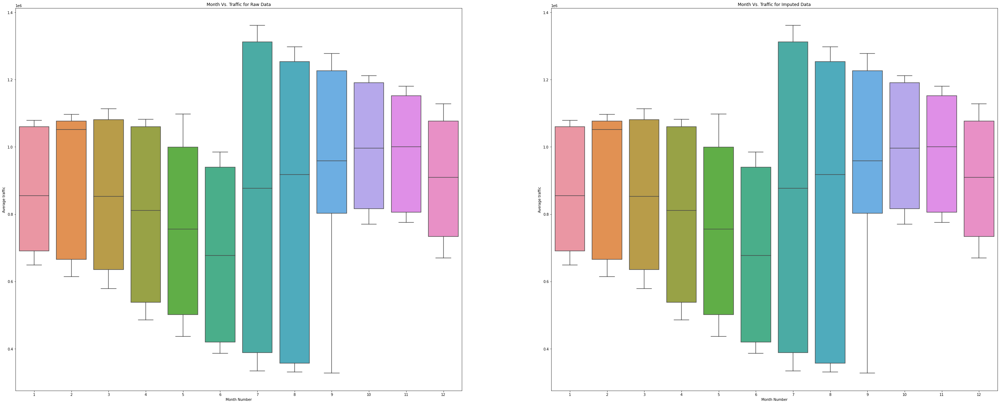

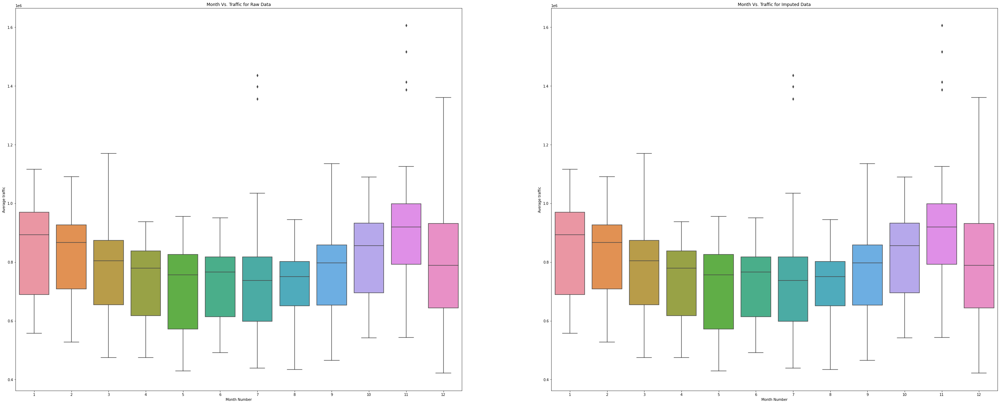

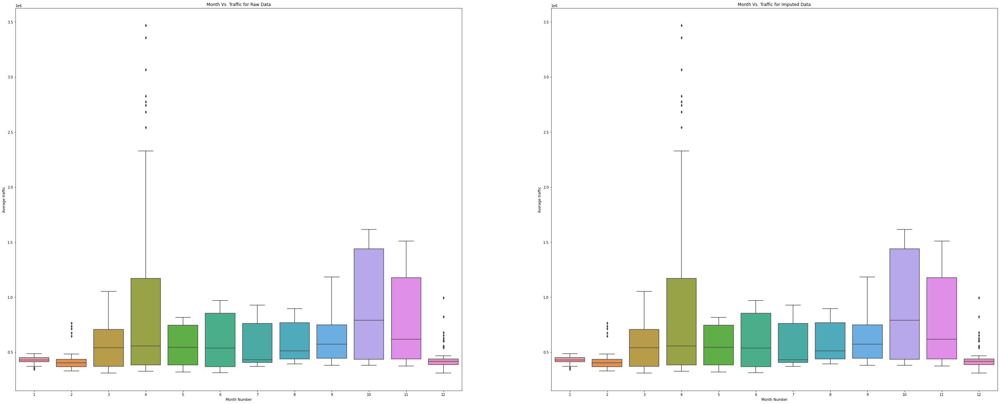

In [ ]:
# Boxplots of month vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=month,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


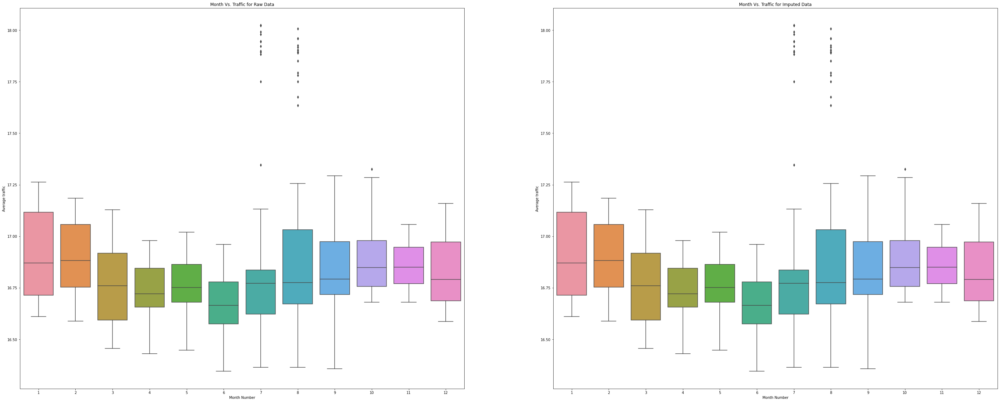

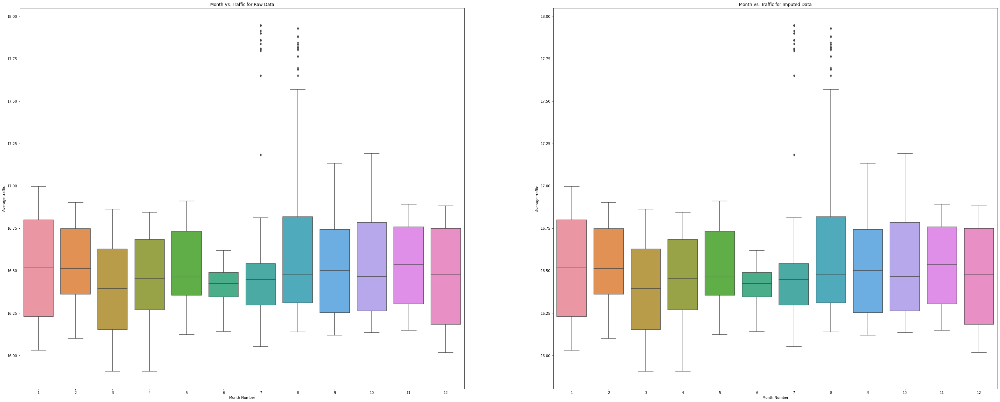

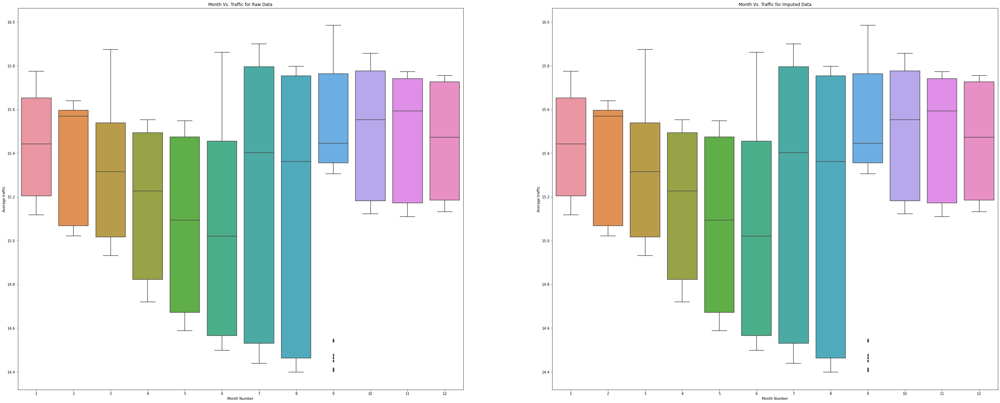

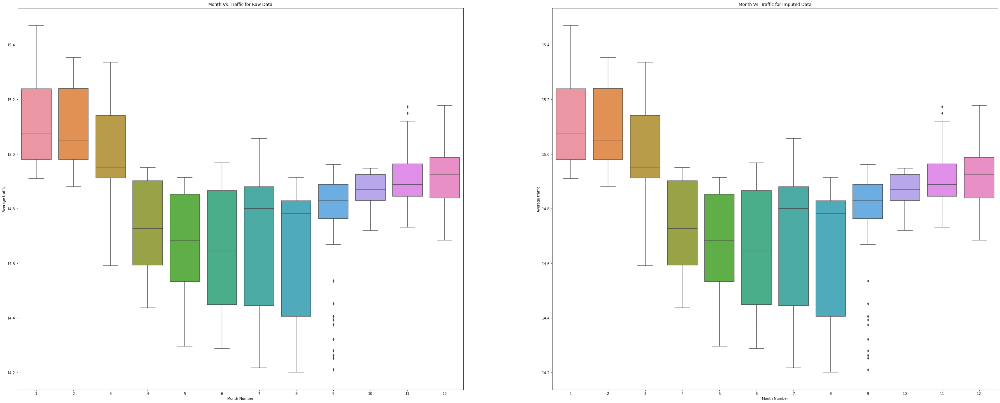

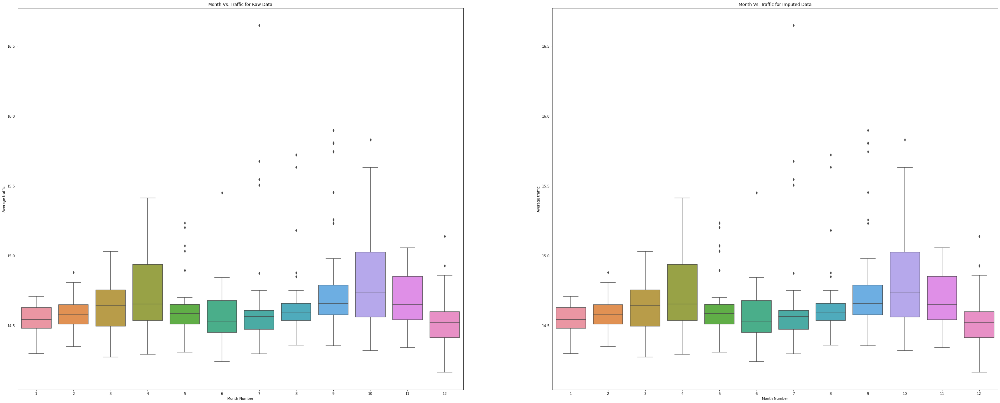

...

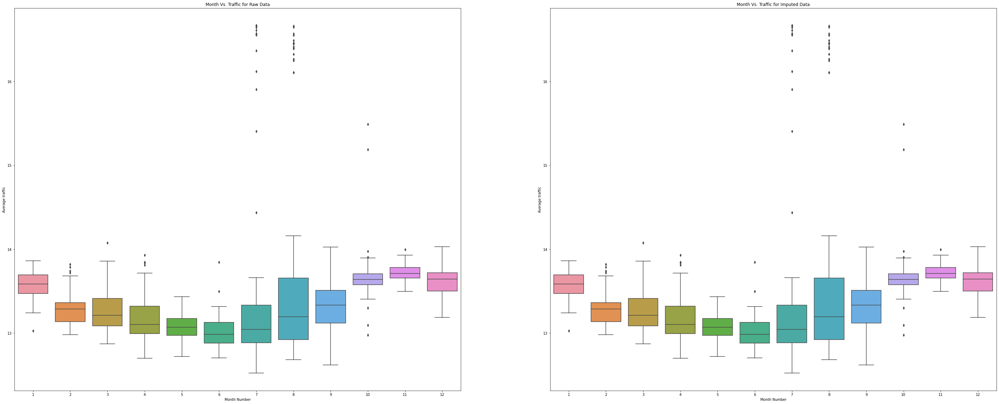

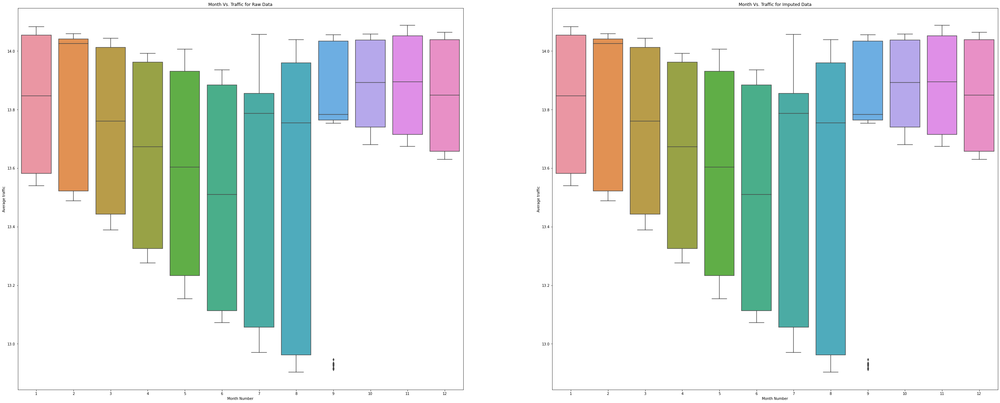

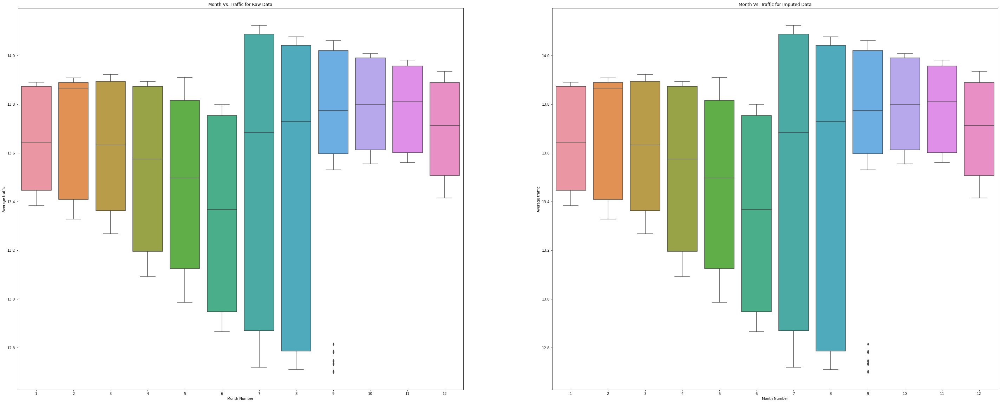

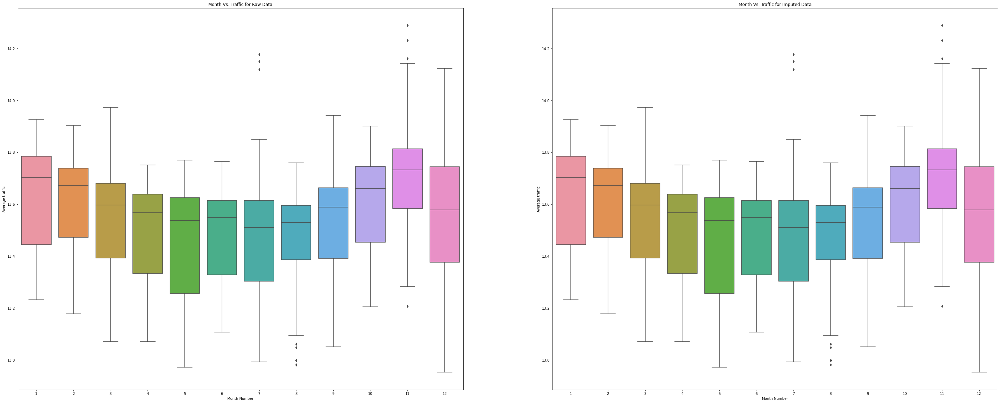

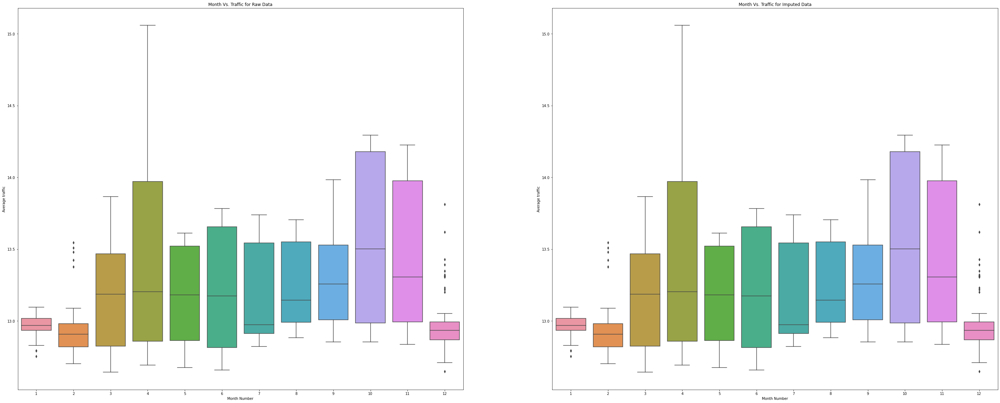

In [ ]:
# Boxplots of month vs. average pagehits for transformed data
import seaborn as sns
for i in range(0,15):
    rawhits=eda_log_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_log_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=month,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


- The boxplots of each month are somewhat different from one another. 
- The IQR is much smaller for much smaller for months in first half of the year and quite high in the second half. 
- In some cases the IQR for August is much high 
- So month number and year half can be used as a feature . 

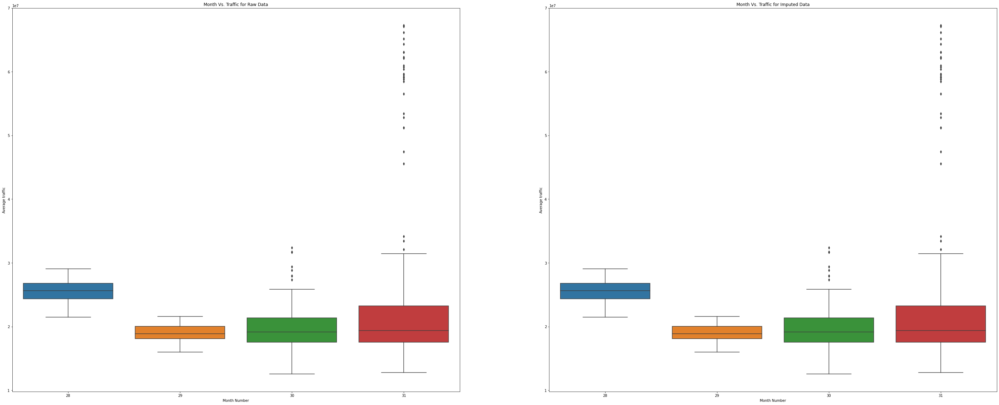

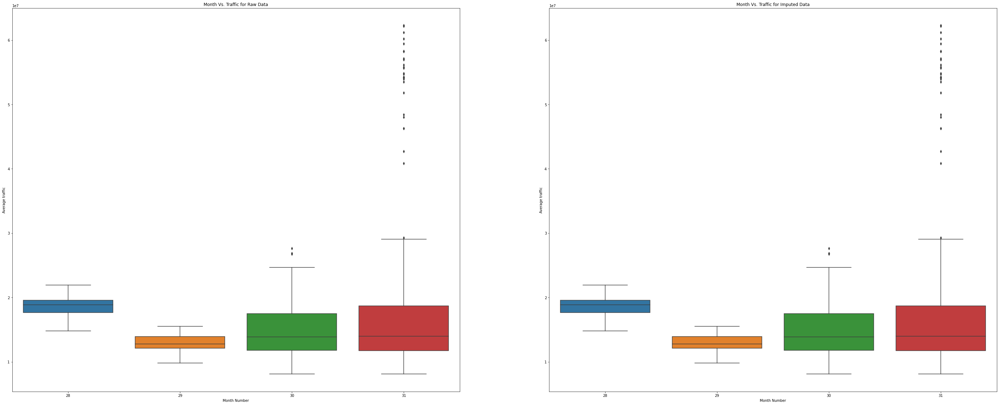

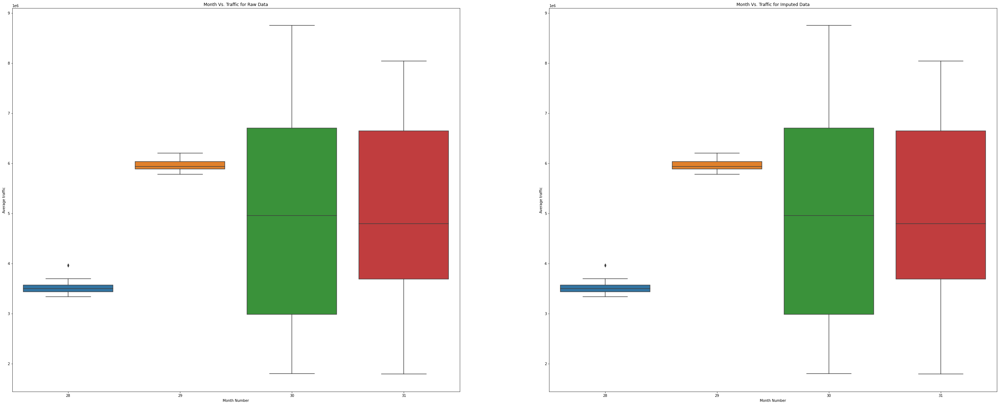

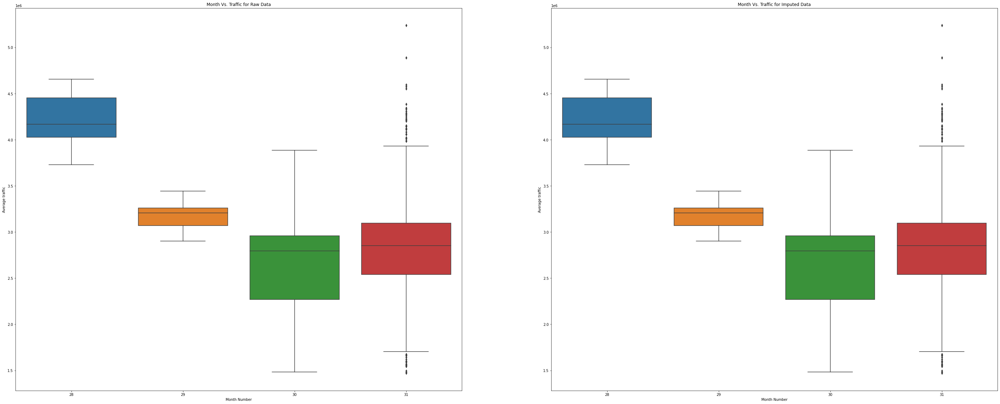

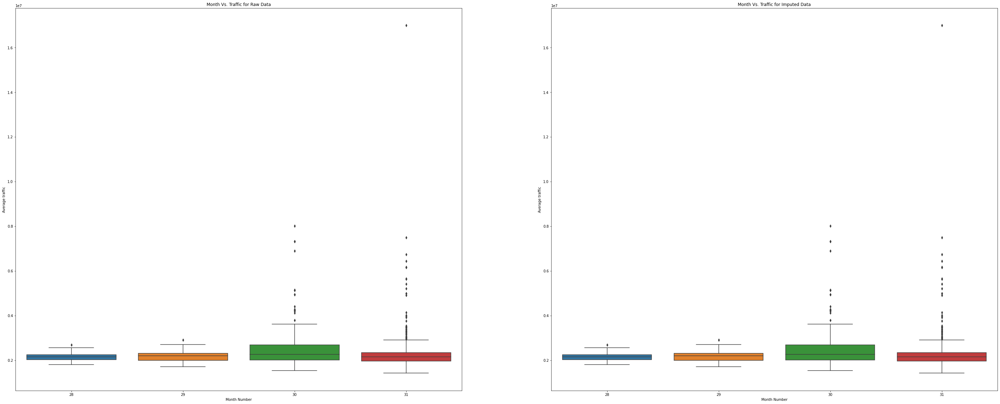

...

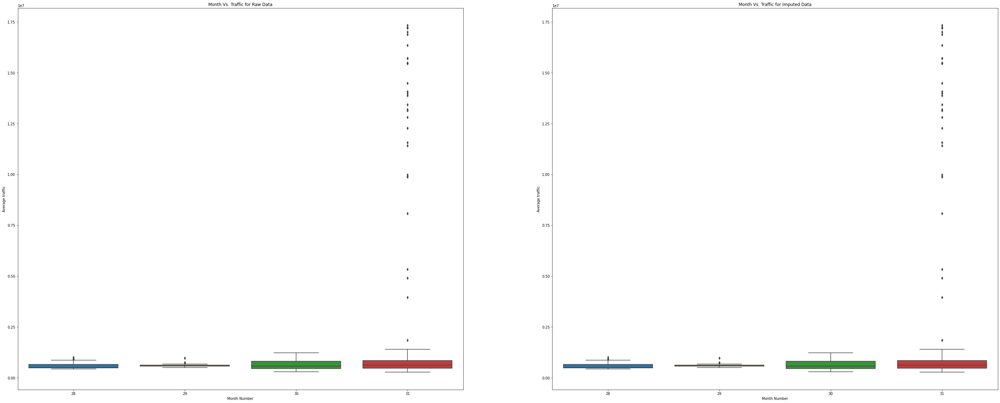

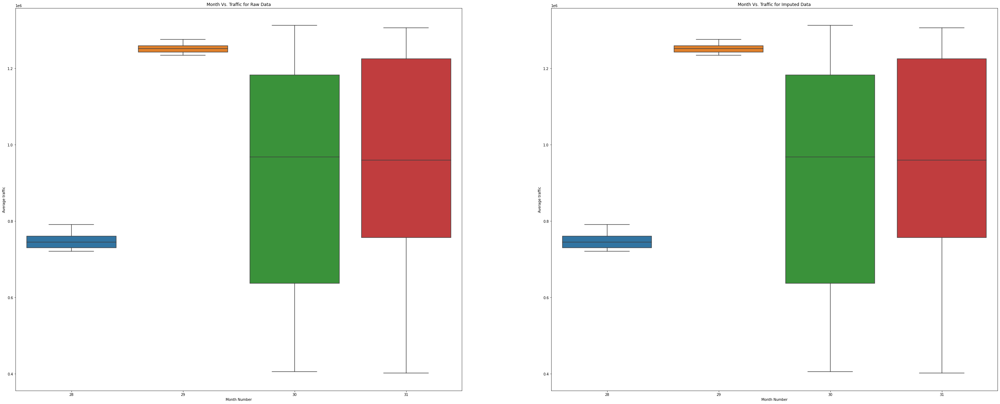

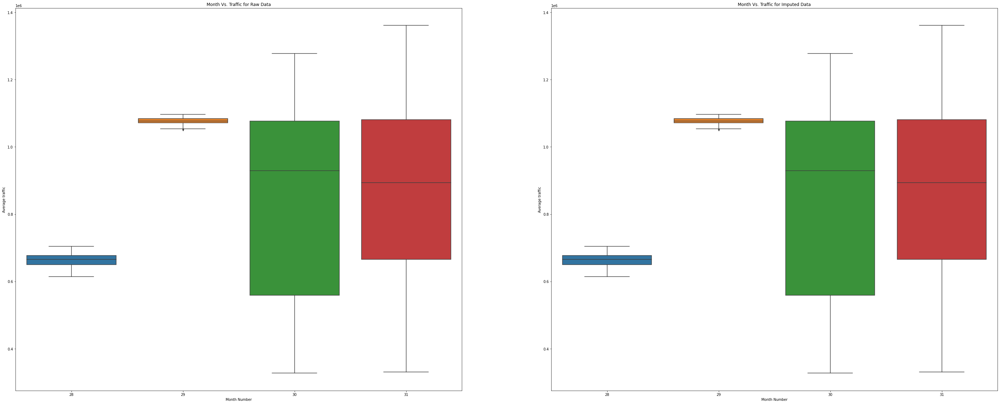

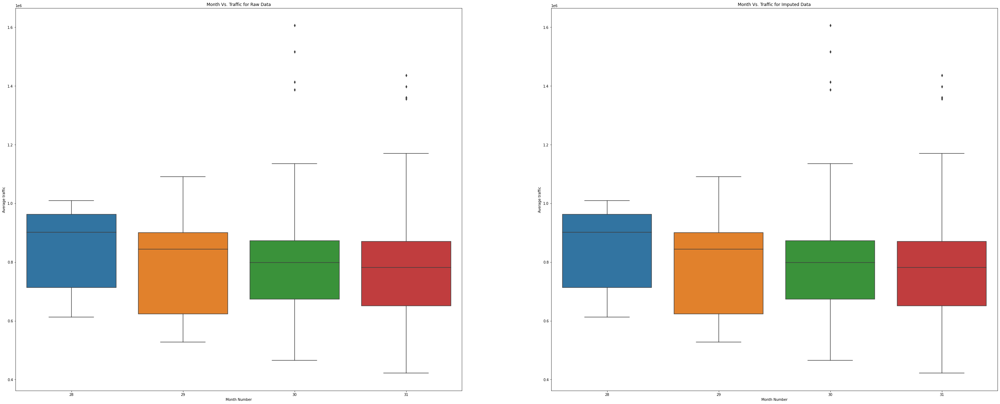

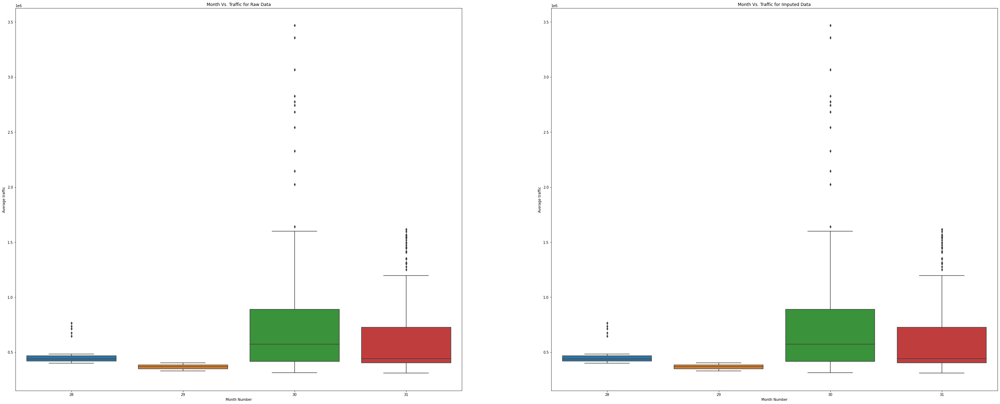

In [ ]:
# Boxplots of number of days in a month vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=days_in_month,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=days_in_month,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


- In some cases February is having much higher pagehit values as compared to other months.

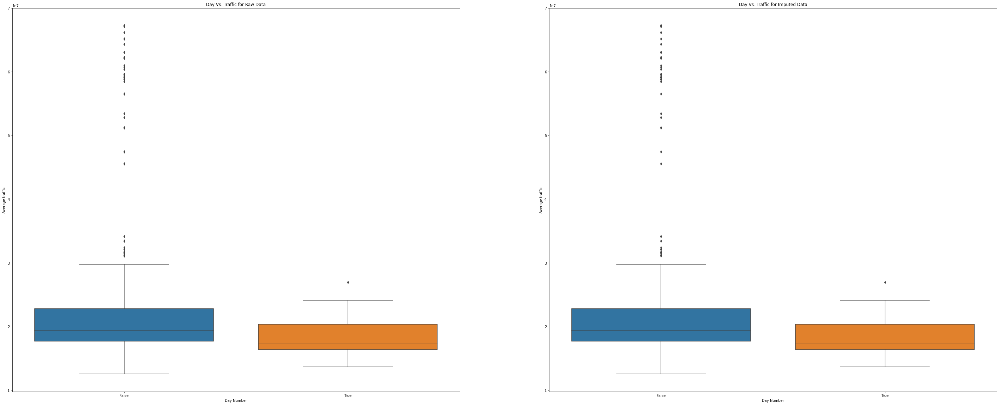

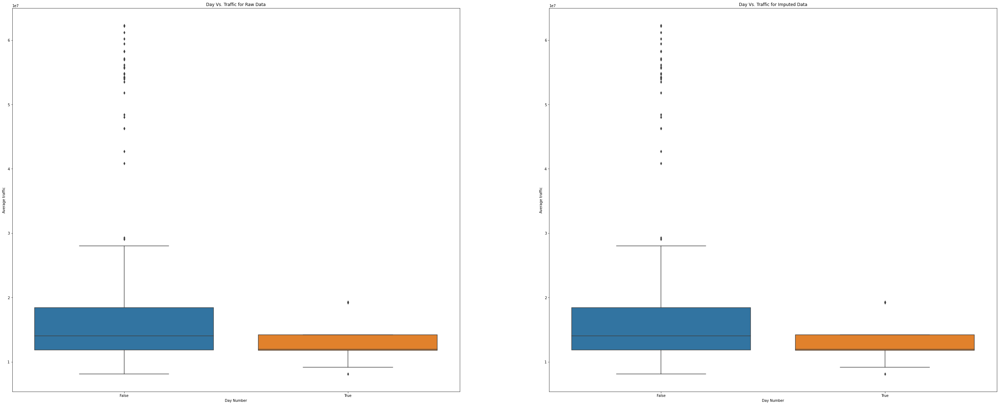

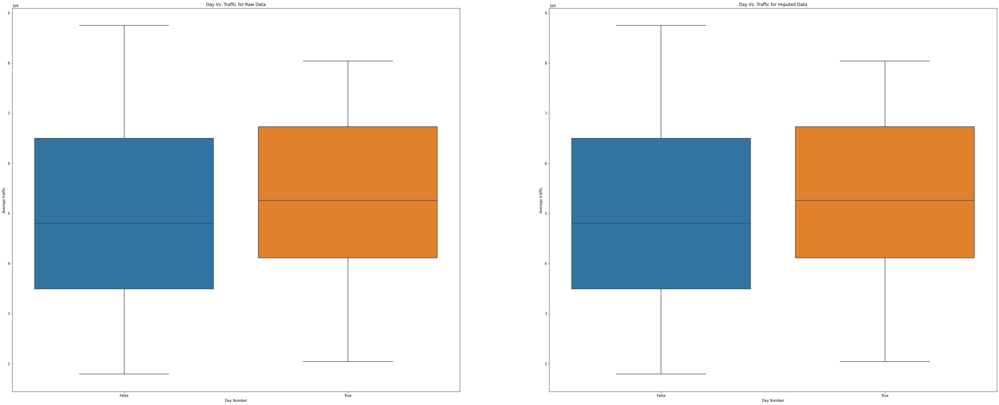

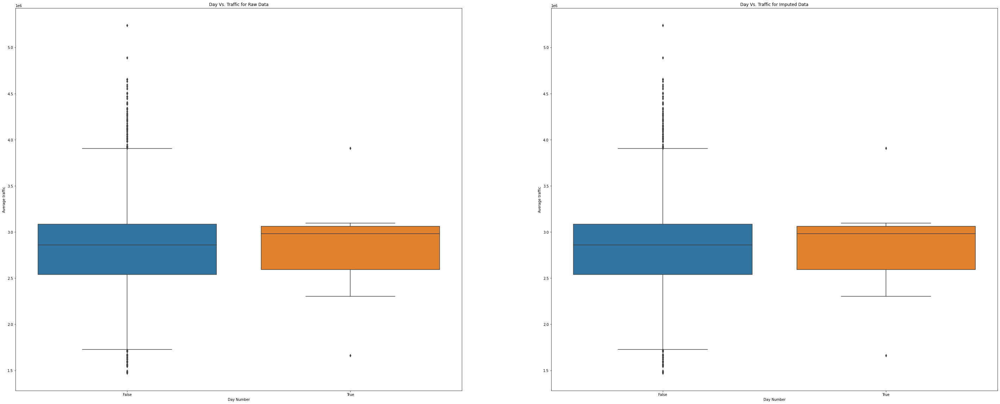

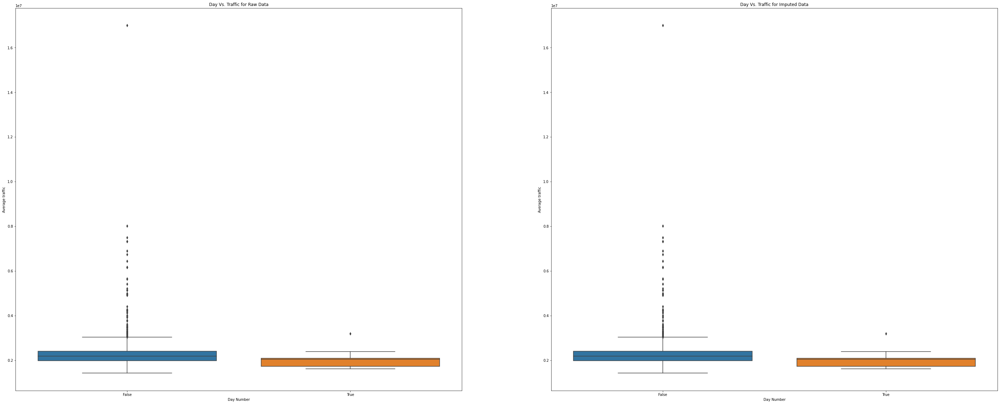

...

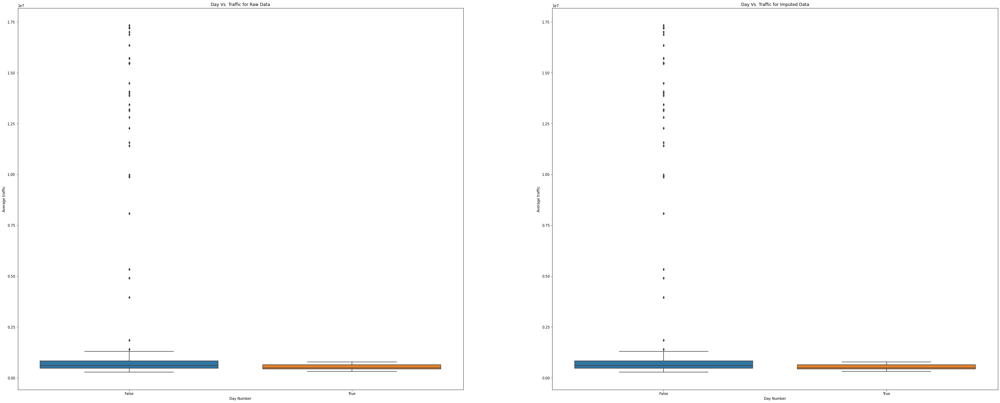

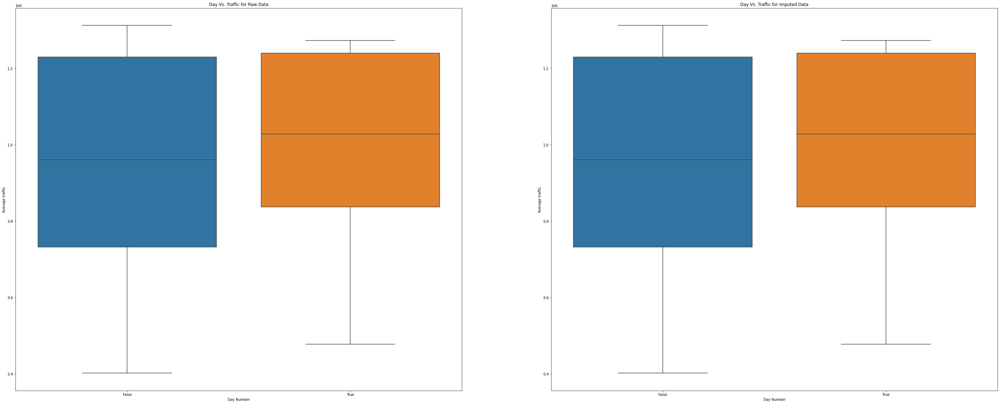

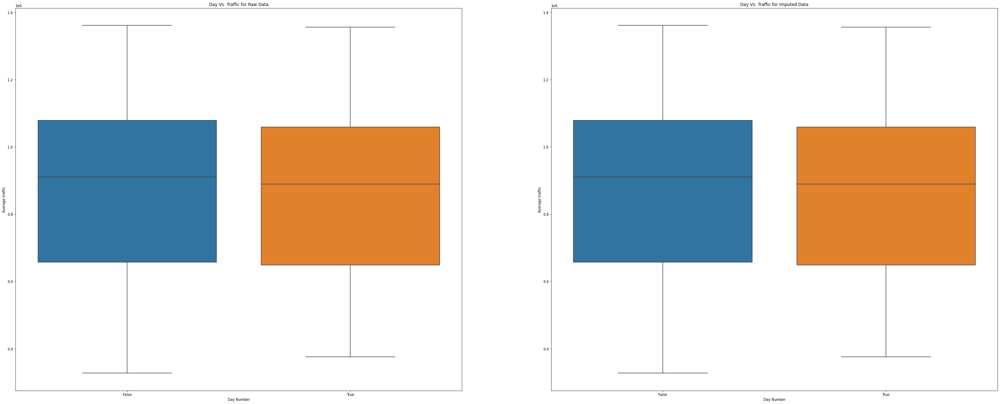

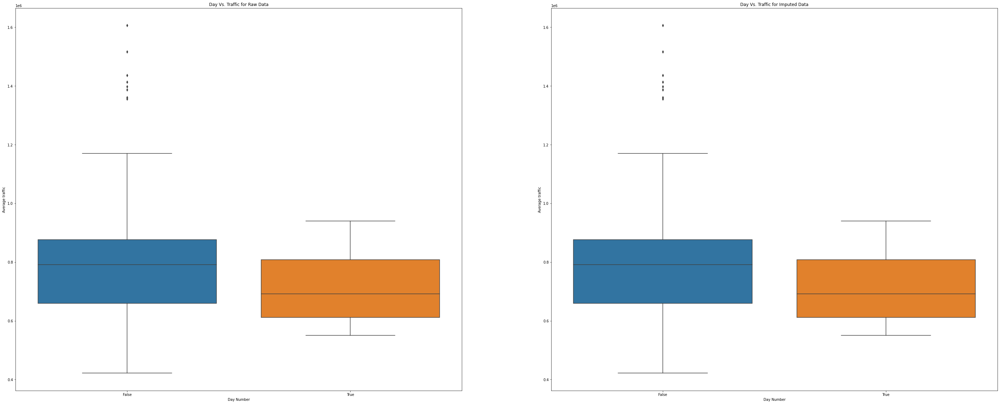

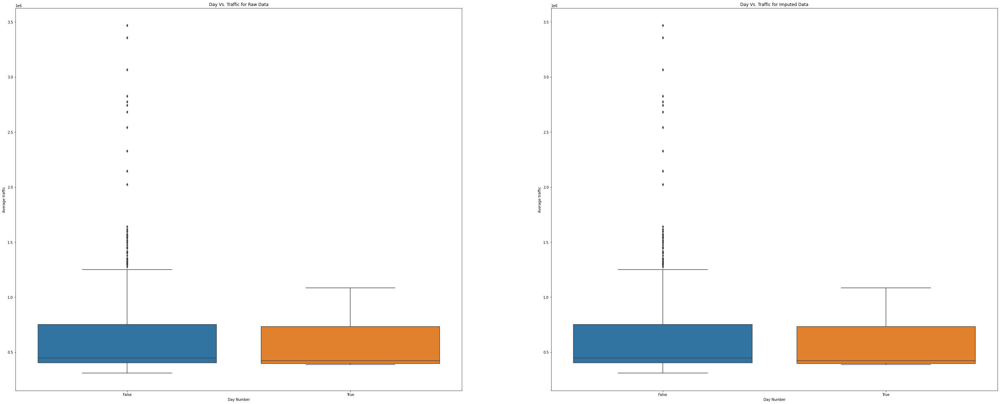

In [ ]:
# Boxplots of month_start vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=quarter_start,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=quarter_start,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


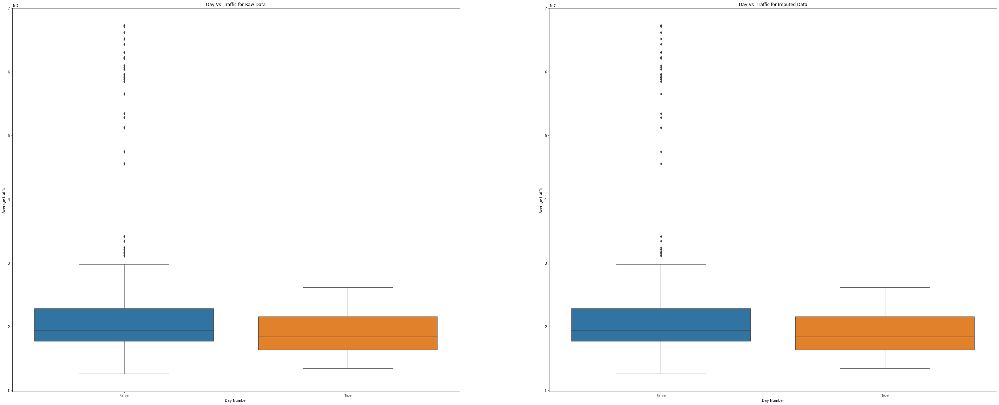

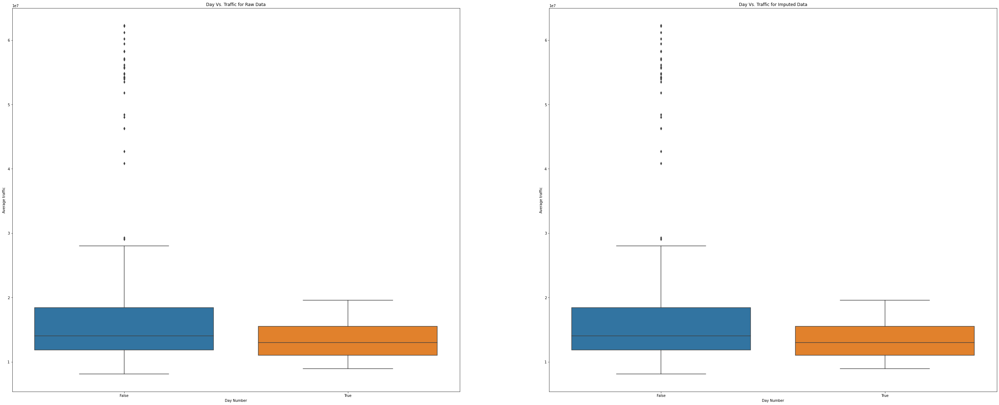

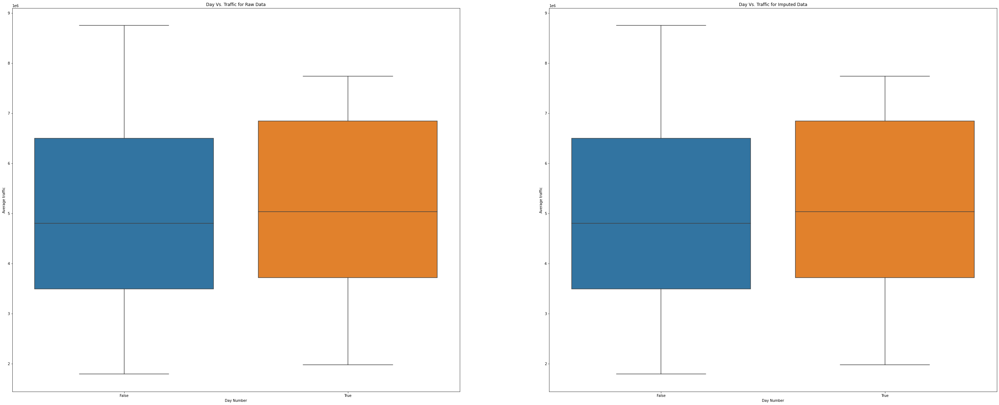

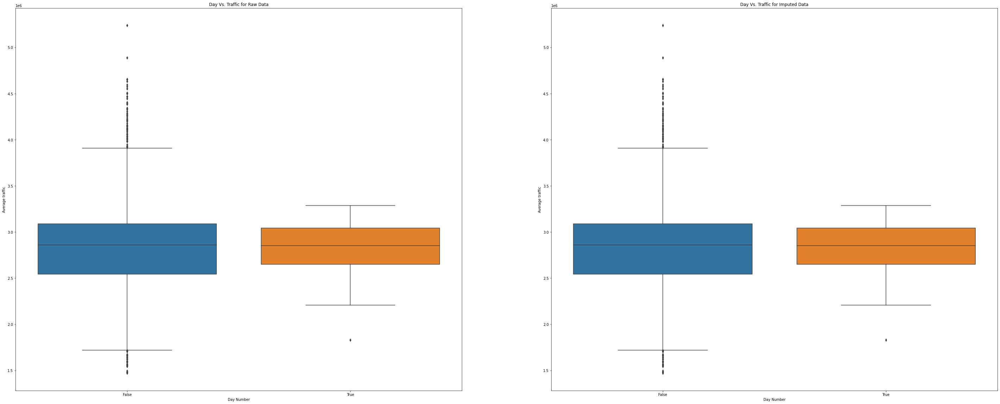

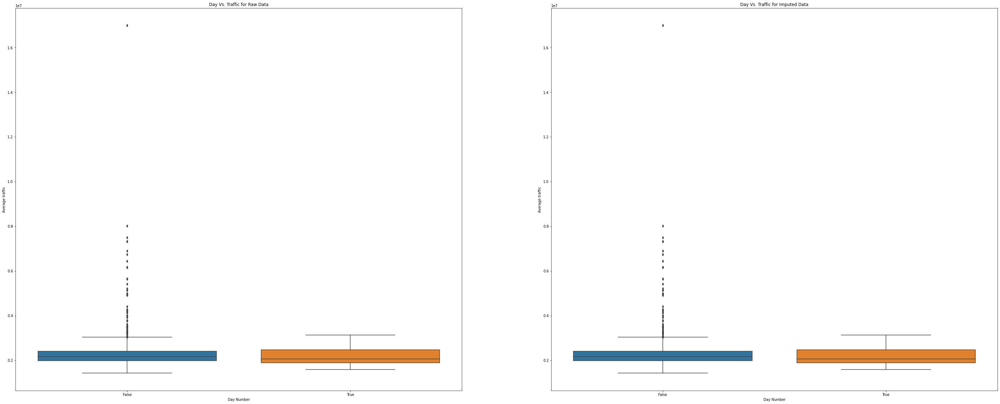

...

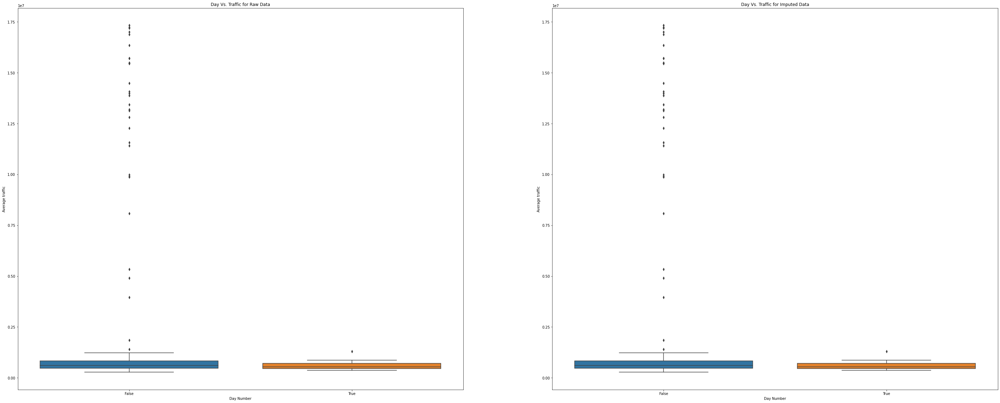

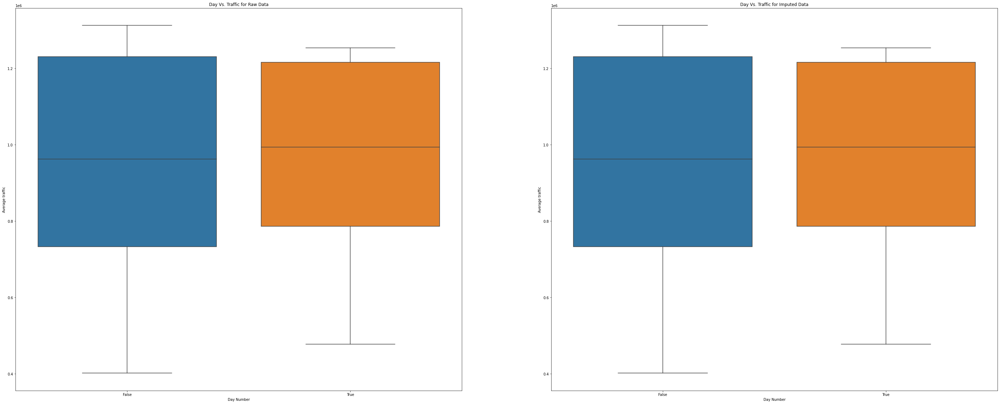

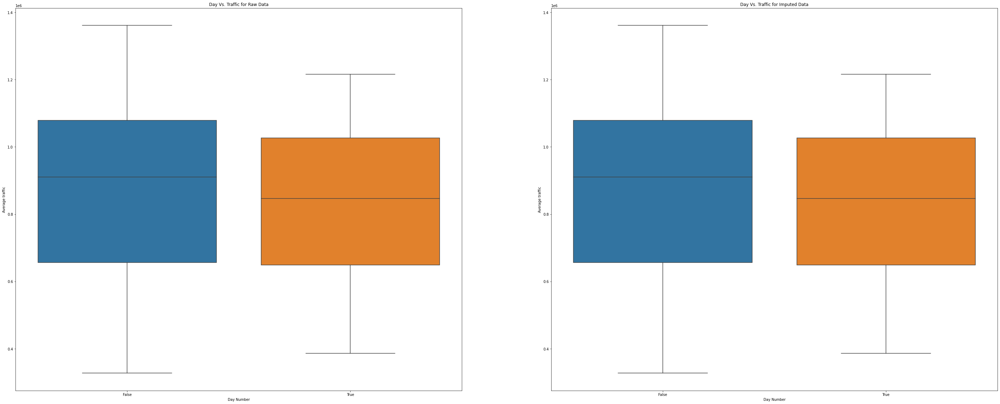

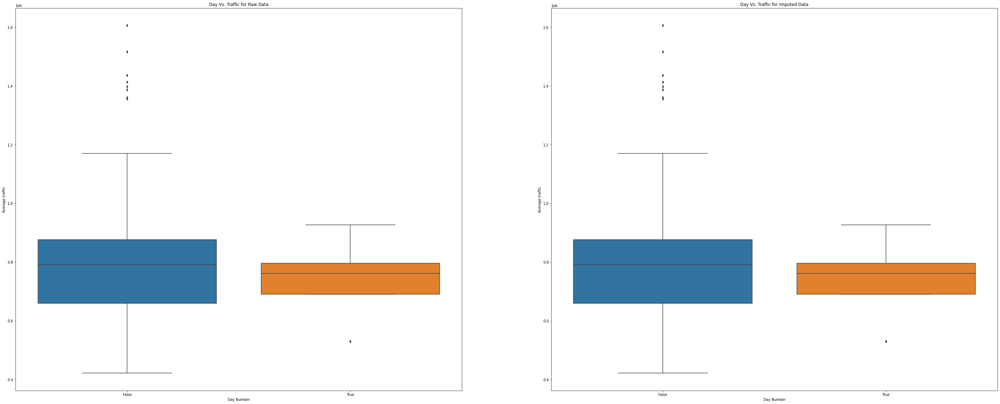

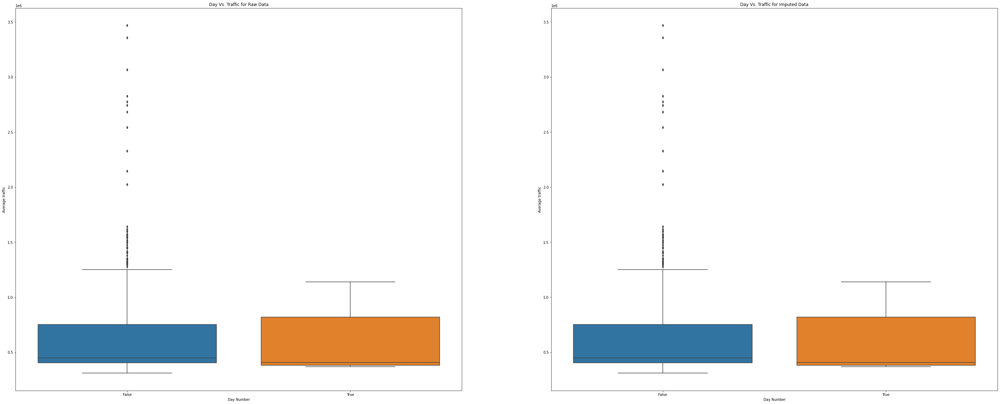

In [ ]:
# Boxplots of quarter_end vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=quarter_end,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=quarter_end,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- As Quarter_start and  quarter_end are parts of month_start and month_end there are similarities in the boxplots.

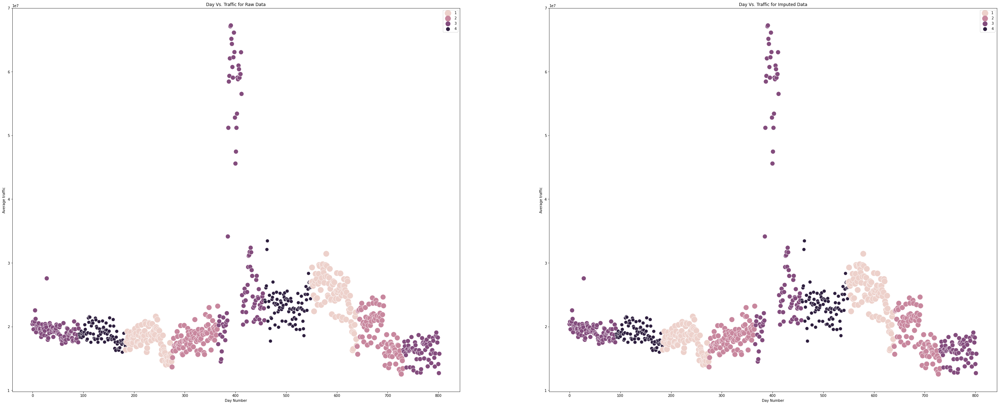

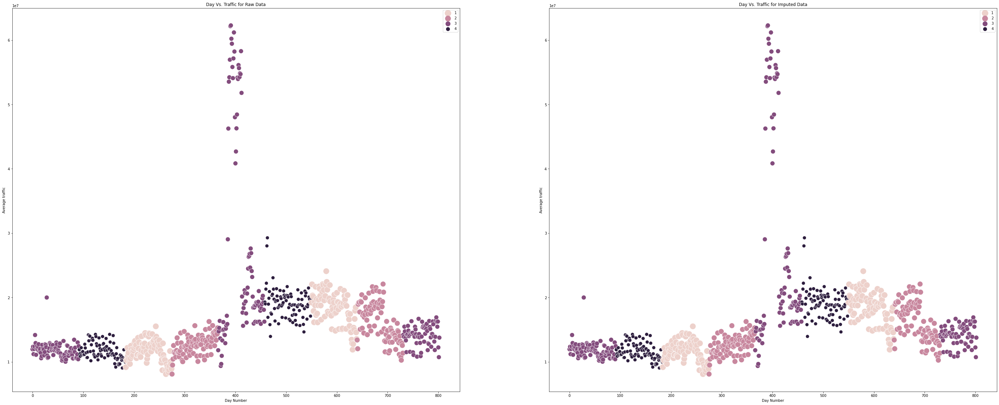

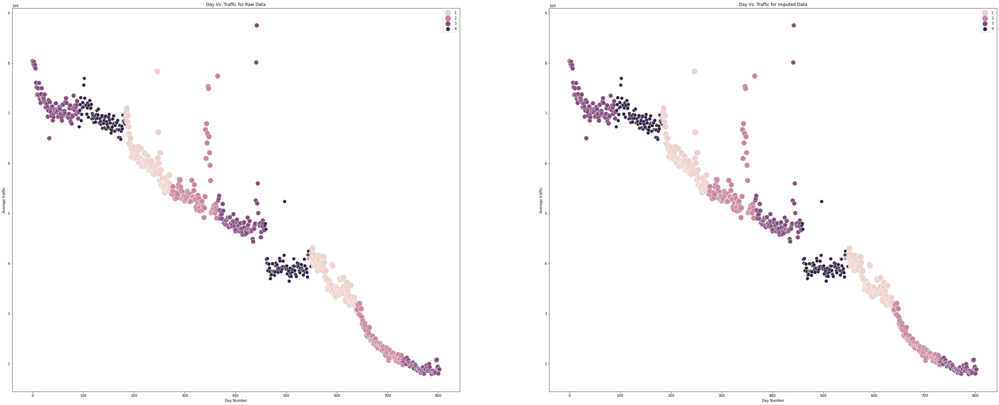

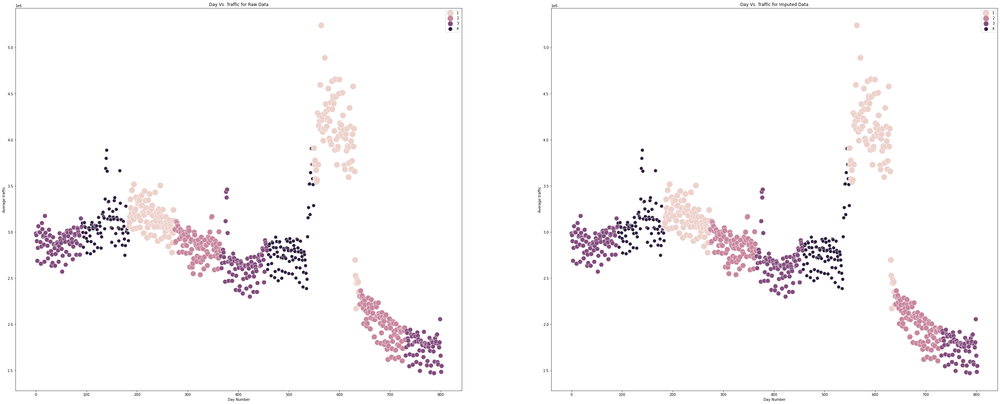

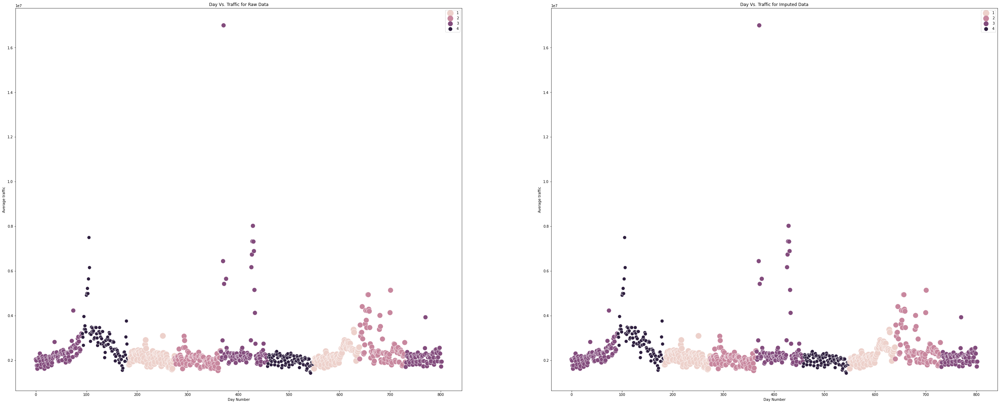

...

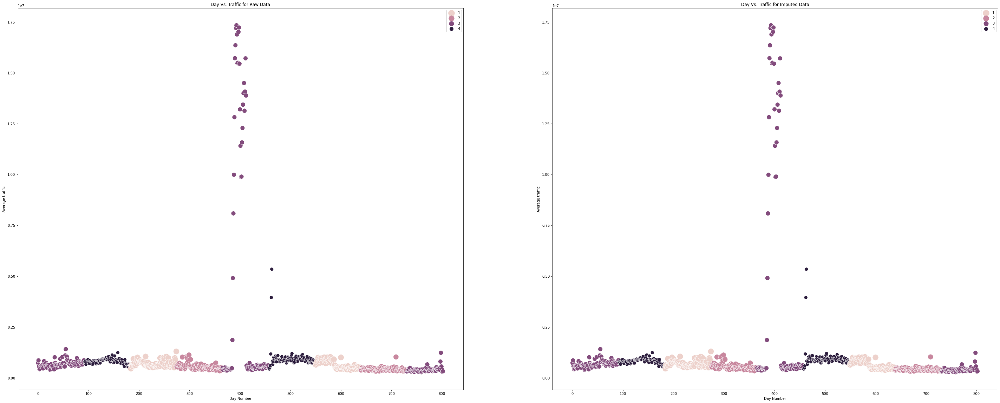

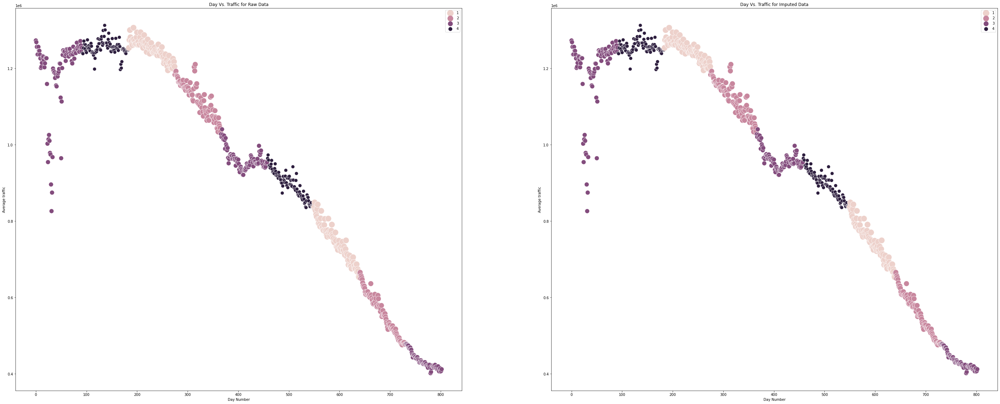

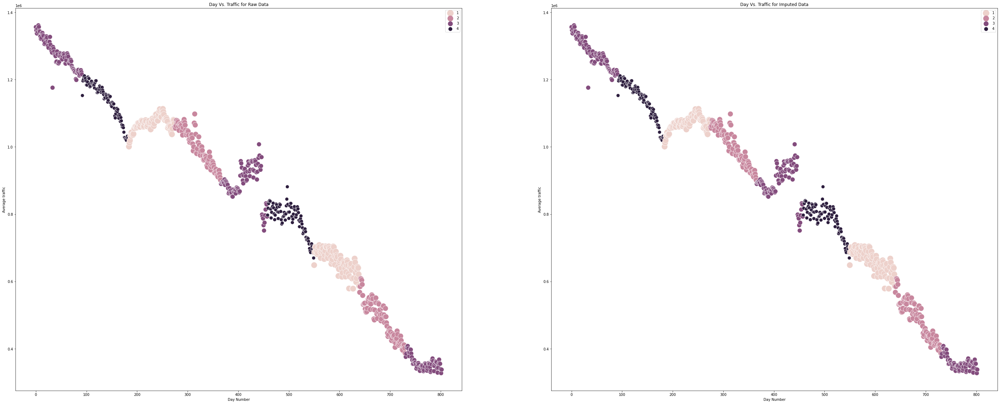

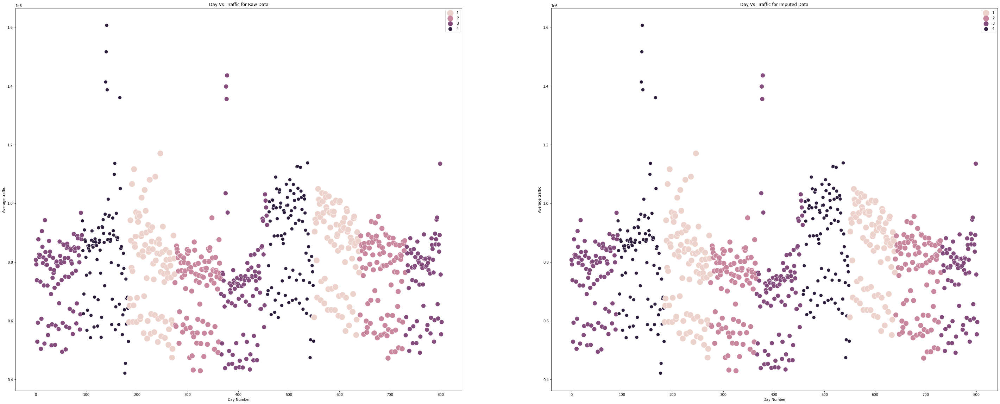

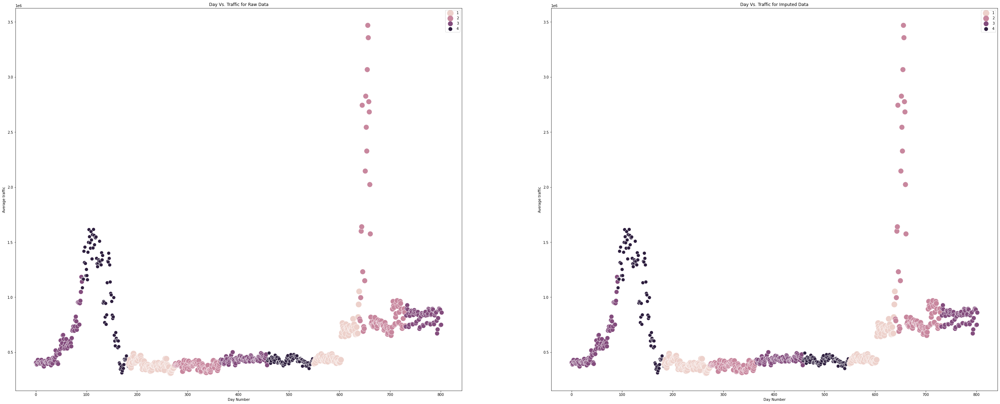

In [ ]:
# Boxplots of quarter vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.scatterplot(x=range(len(date_list)),y=rawhits,hue=quarter,ax=axes[0],sizes=(300,100),size=quarter)
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.scatterplot(x=range(len(date_list)),y=imphits,hue=quarter,ax=axes[1],sizes=(300,100), size=quarter)
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- For different quarters the pagehit values are different.
- This along with quarter start and quarter end feature can give me accurate idea of traffic

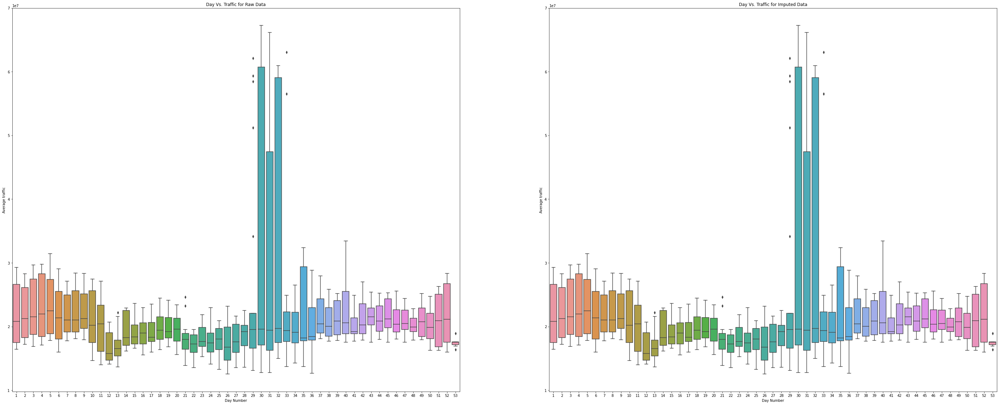

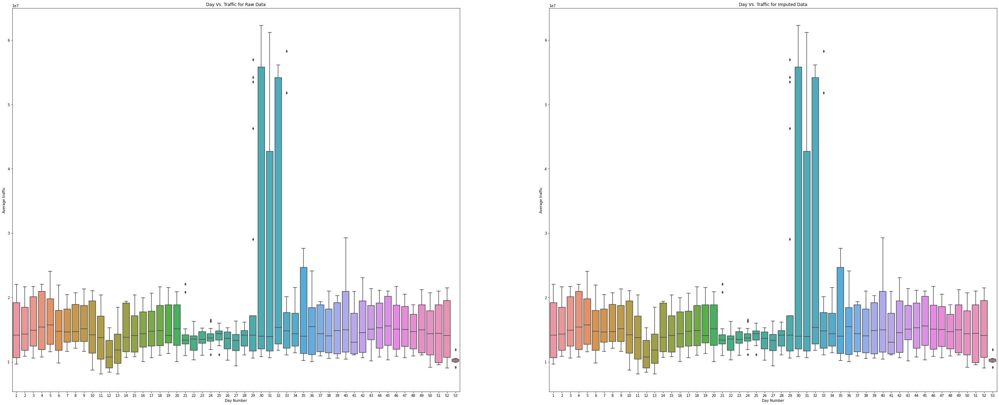

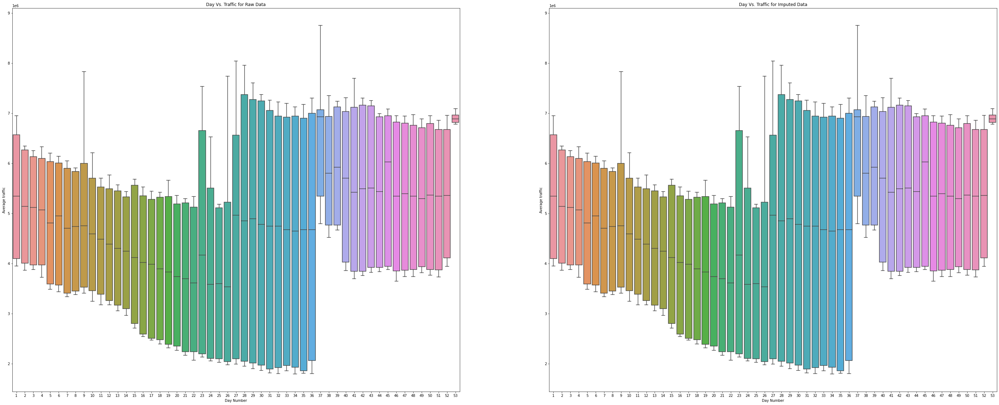

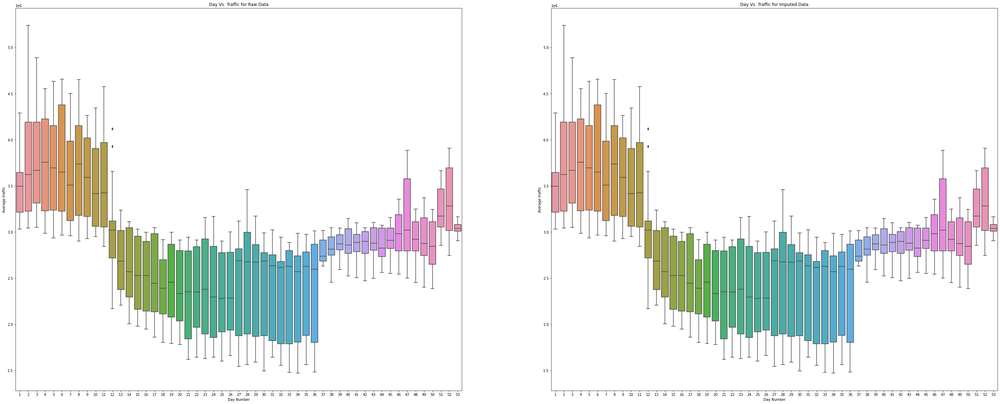

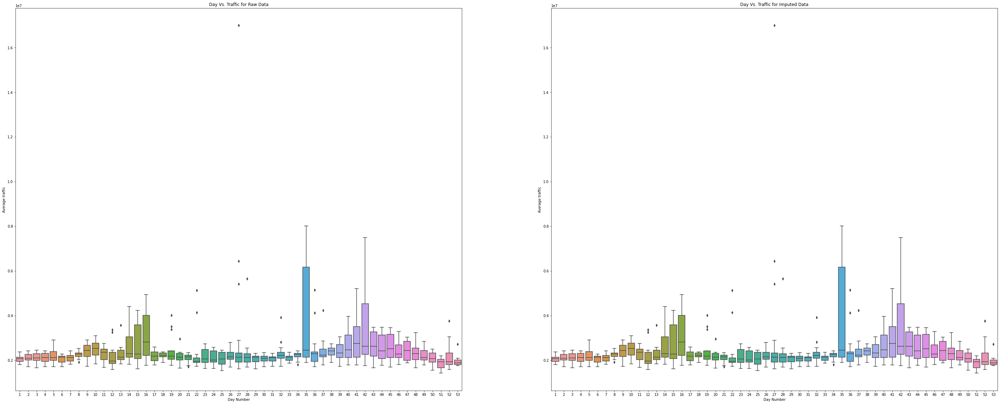

...

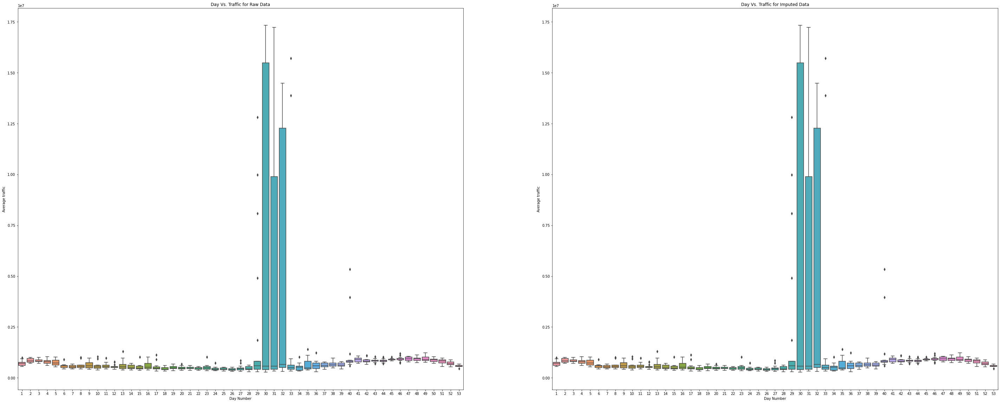

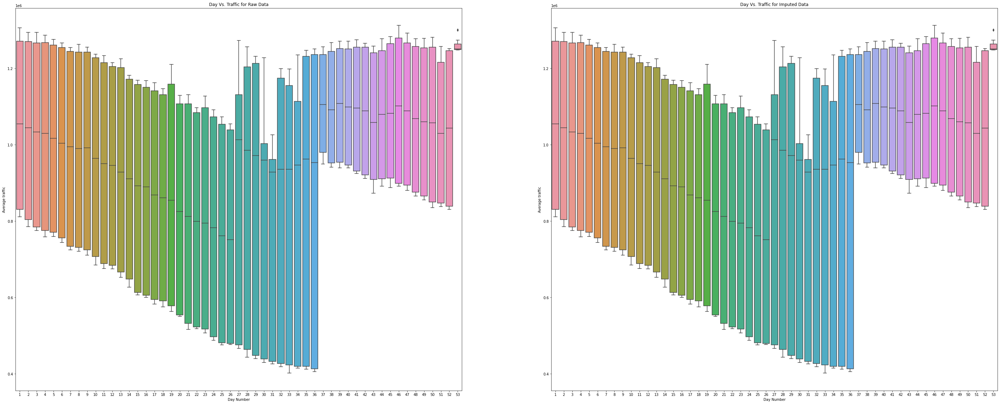

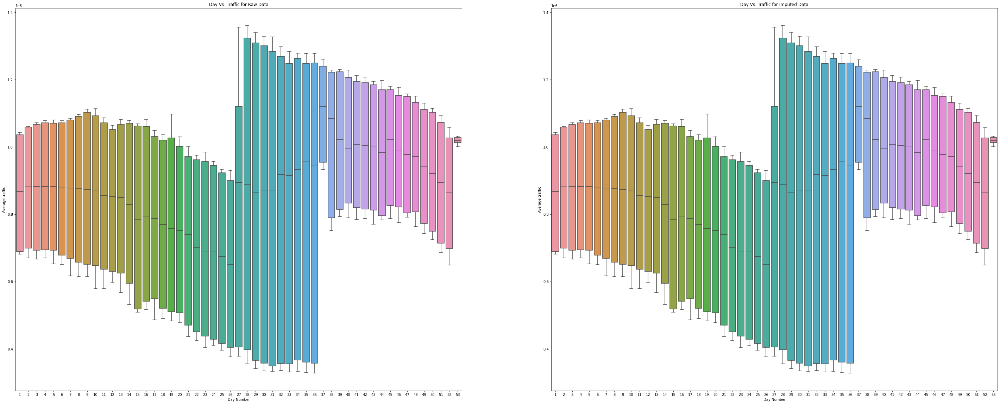

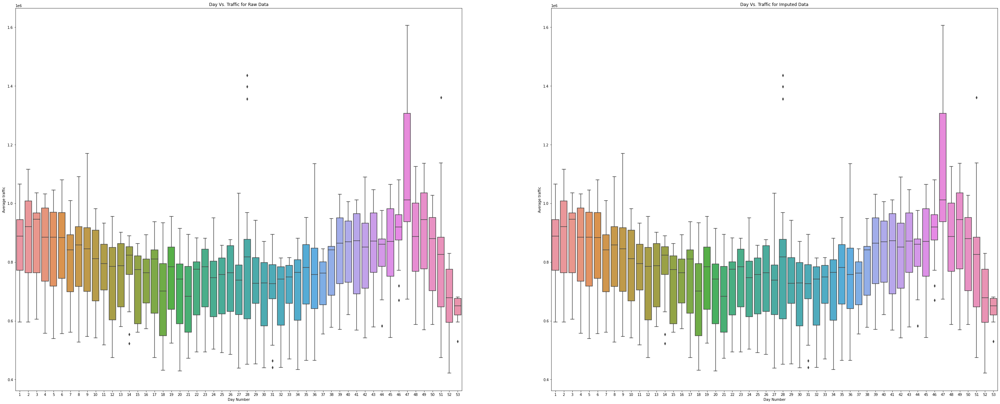

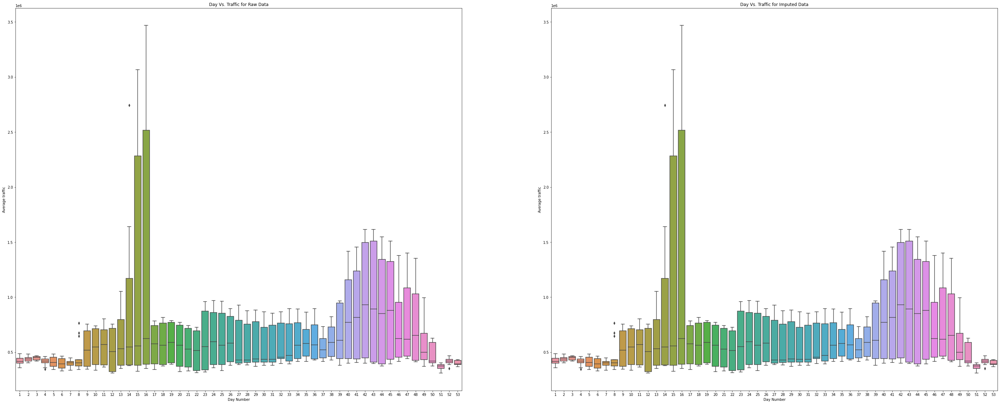

In [ ]:
# Boxplots of week vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=week,y=rawhits,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=week,y=imphits,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- As seen earlier the second half of the year has higher pagehit values.
- Similarly here the weeks in the second half of the year shows the same pattern.

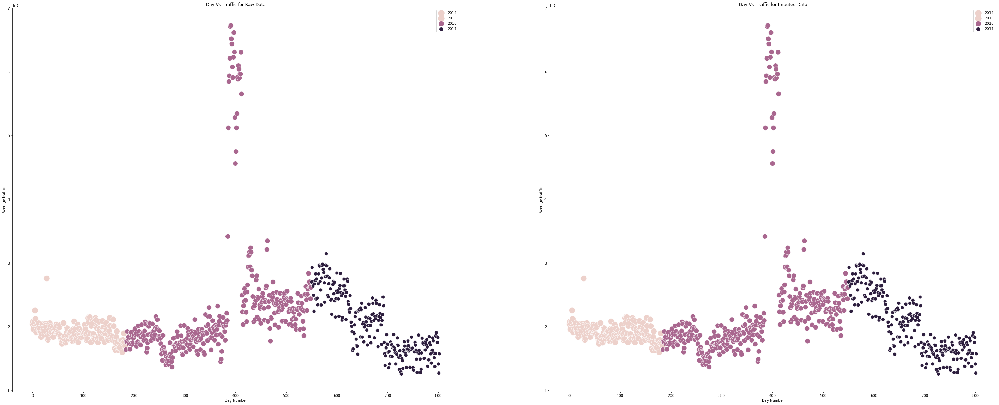

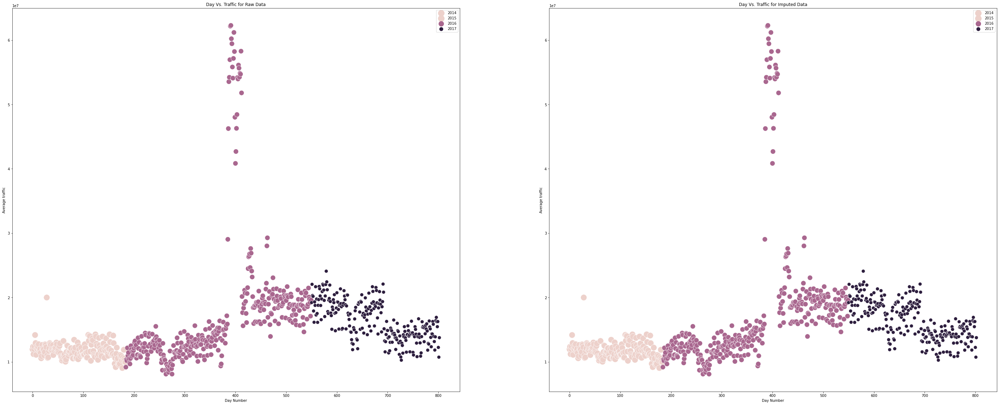

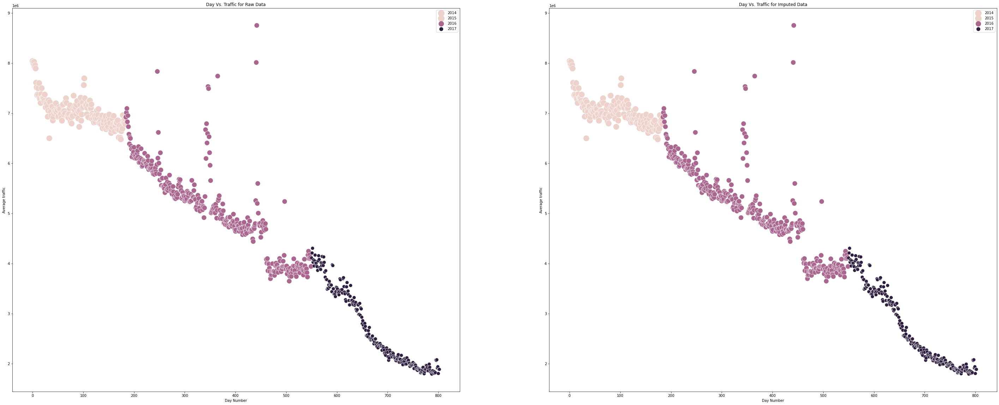

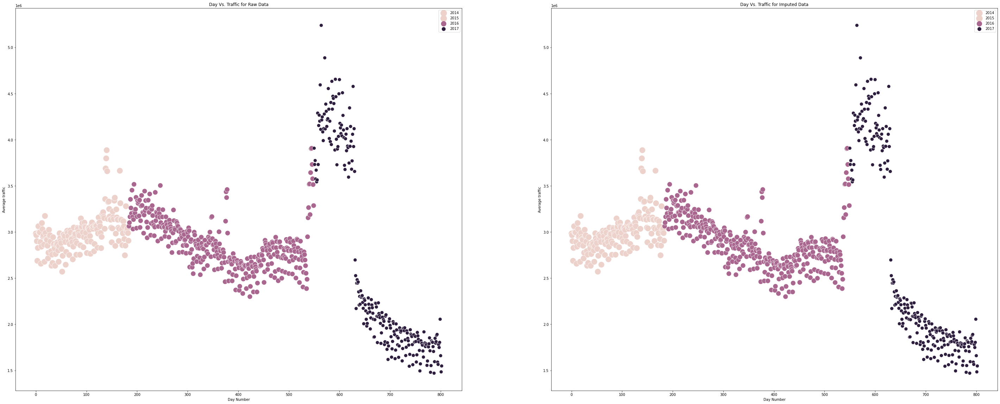

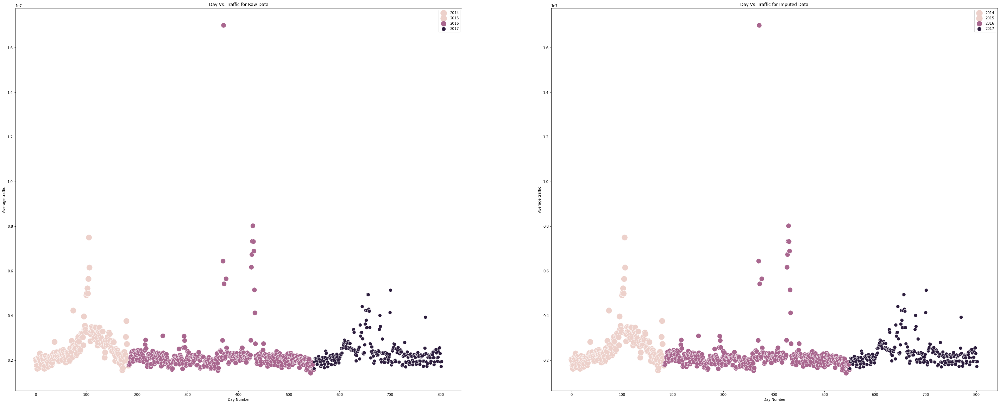

...

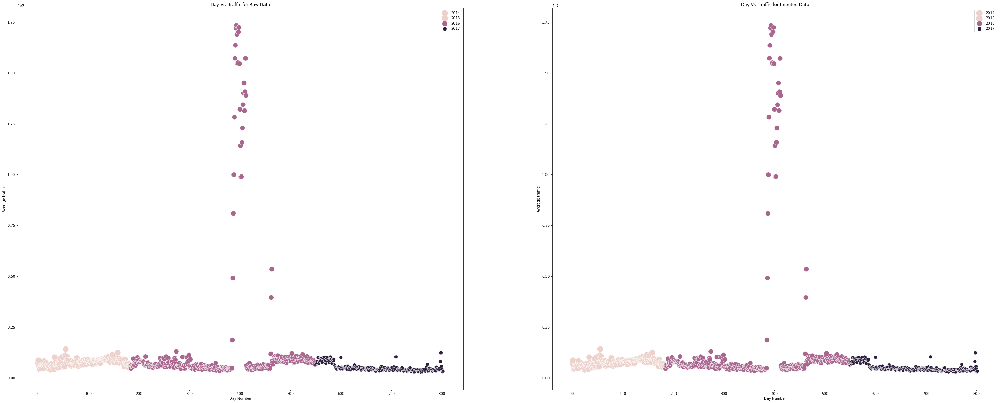

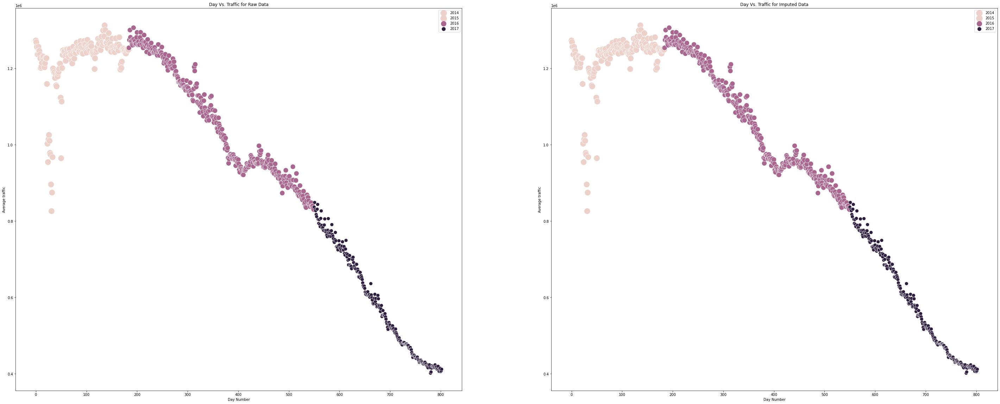

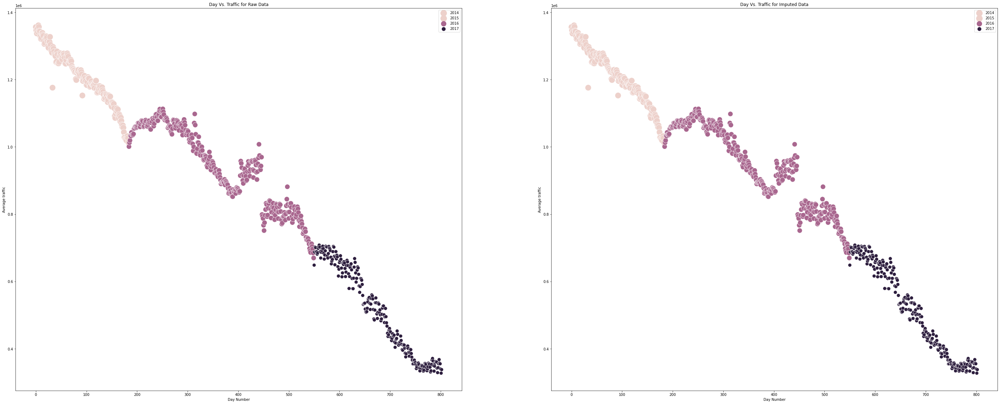

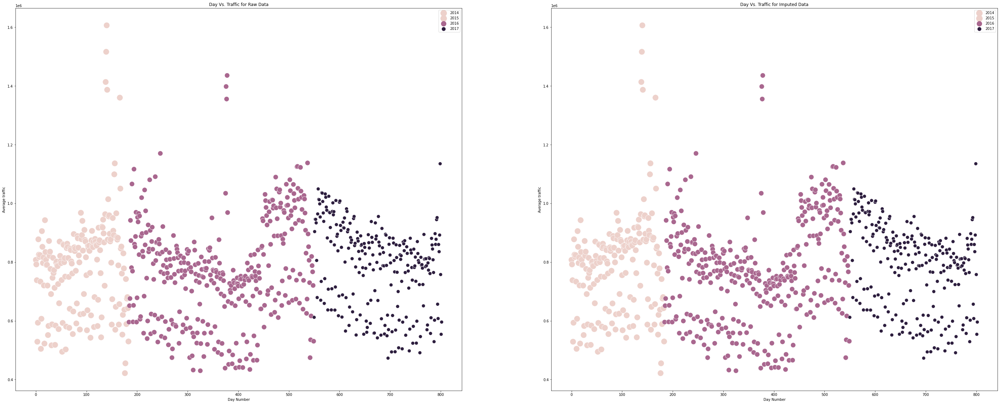

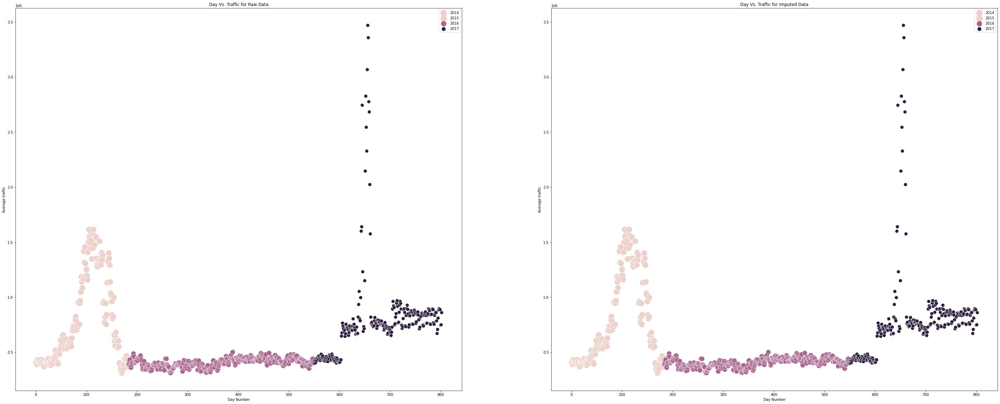

In [ ]:
# Scatterplot of year vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.scatterplot(x=range(len(date_list)),y=rawhits,hue=year,ax=axes[0],sizes=(300,100),size=year)
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.scatterplot(x=range(len(date_list)),y=imphits,hue=year,ax=axes[1],sizes=(300,100), size=year)
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- In most of the cases there is an increase in pagehit values in 2015 and decrease in 2016
- Again there is a downward trend from 2015 which continues to 2016

### Bivariate Analysis

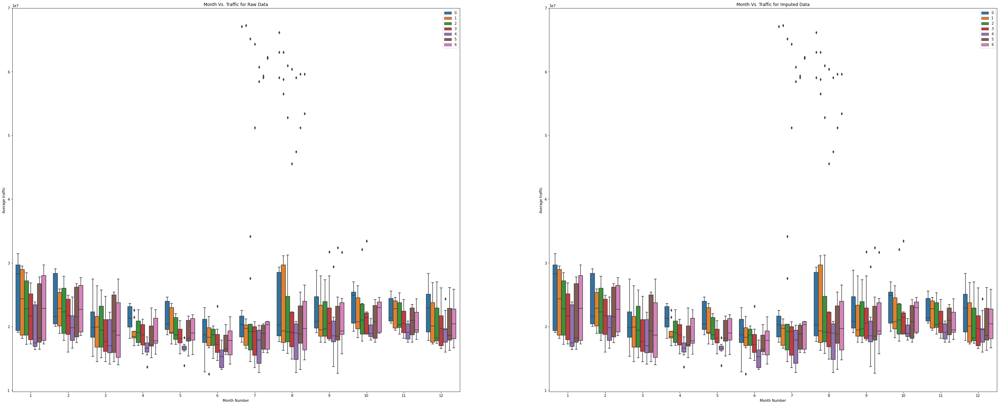

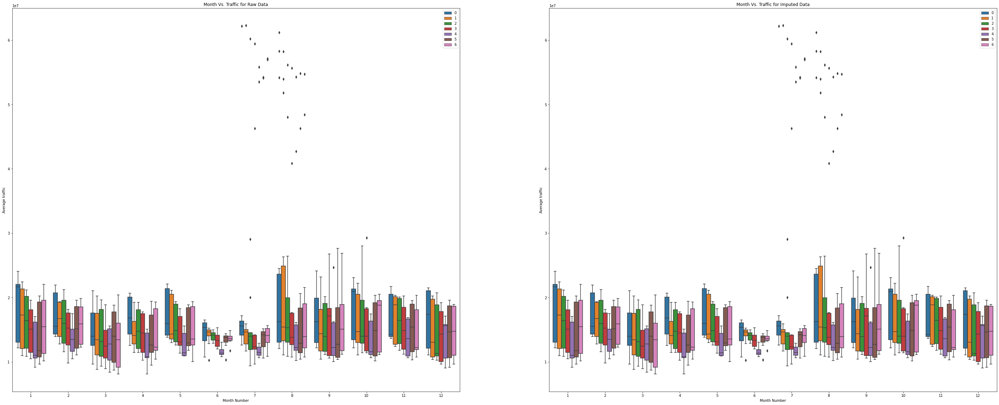

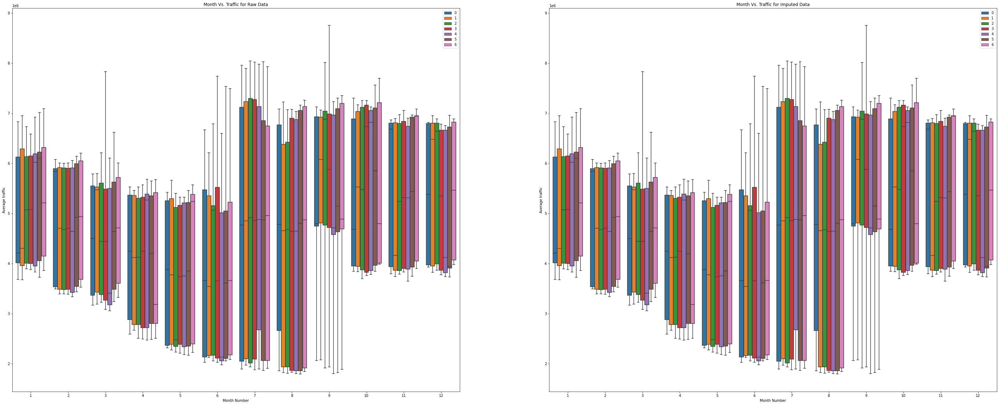

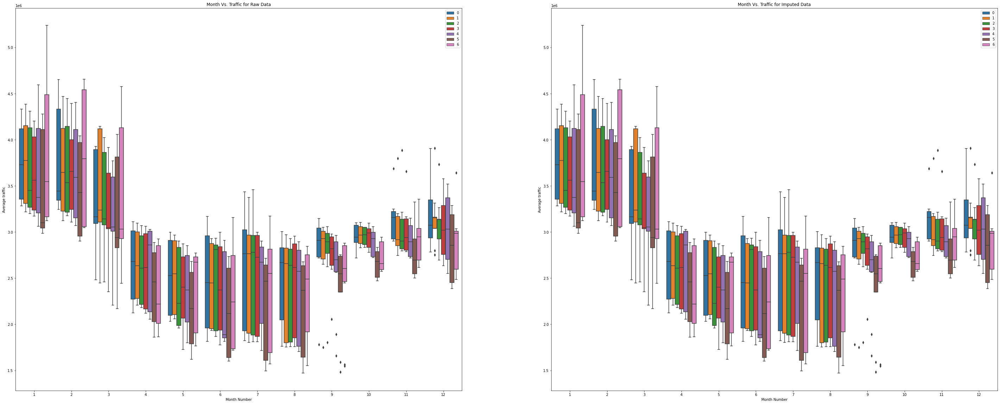

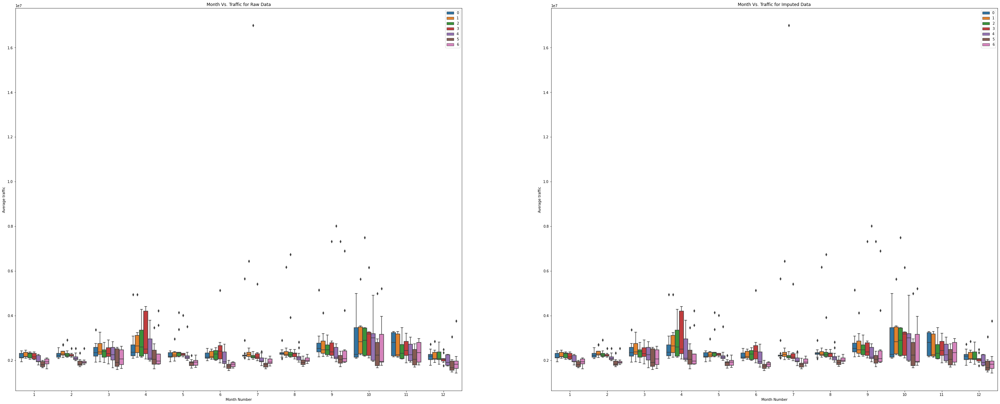

...

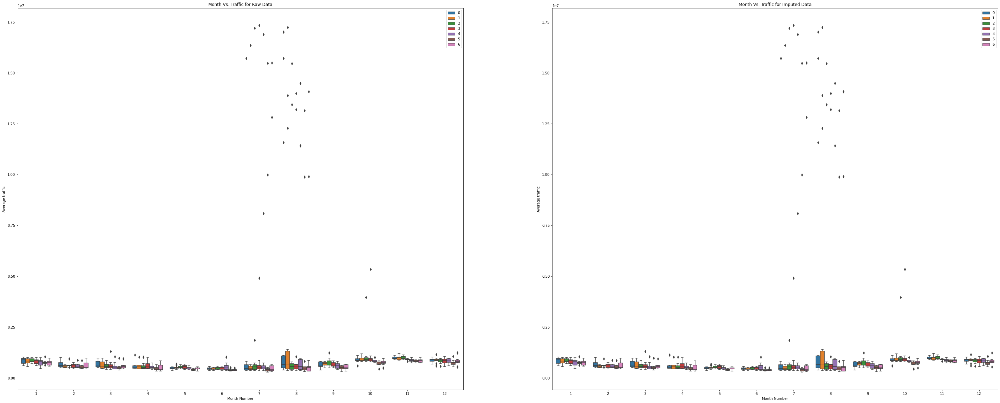

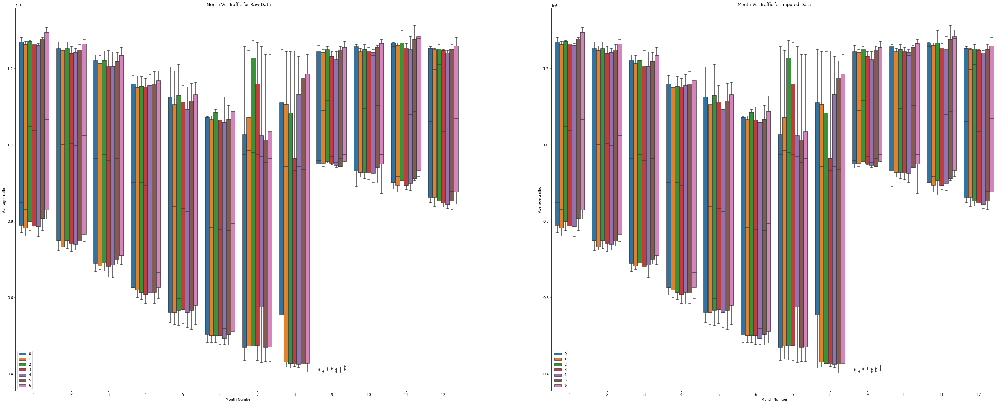

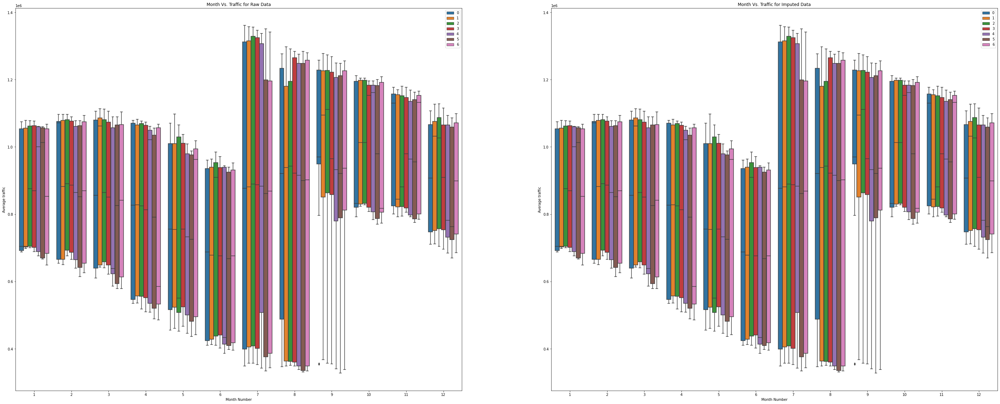

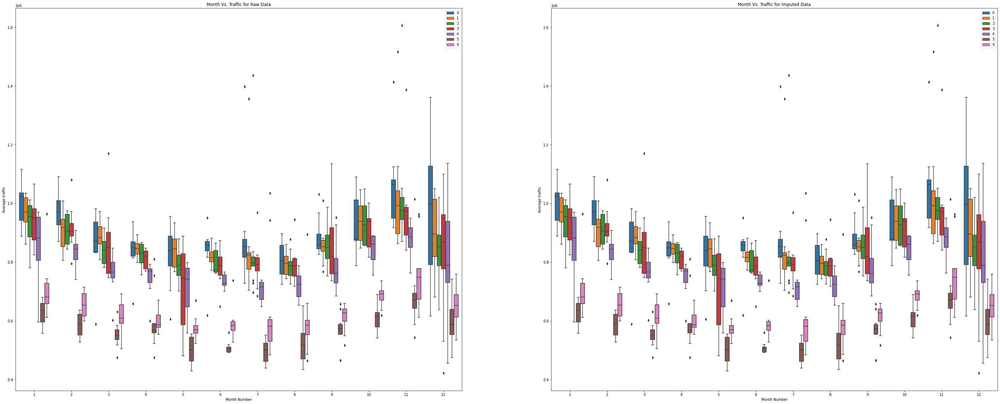

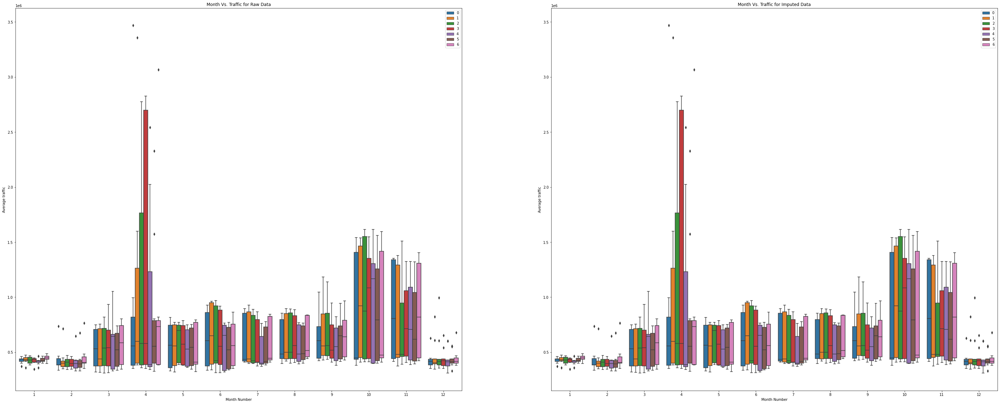

In [ ]:
 # Boxplots of weekdays vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=month,y=rawhits,ax=axes[0],hue=weekday)
    axes[0].set_xlabel('Month Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Month Vs. Traffic for Raw Data')
    sns.boxplot(x=month,y=imphits,ax=axes[1],hue=weekday)
    axes[1].set_xlabel('Month Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Month Vs. Traffic for Imputed Data')
    
    plt.show()


This plot shows how the traffic changes on days of each month. From this I understand the span of traffic values is less in 1st half of the year than in the second half . So I can create a feature as year_half with values as 1 or 2 for 1st and 2nd half respectively. Also I will create another feature is_august because for the IQR for August is high for most pages. 

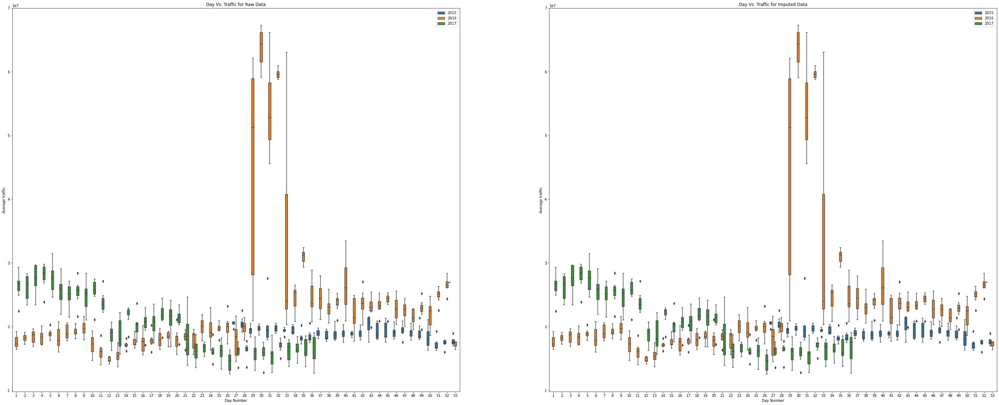

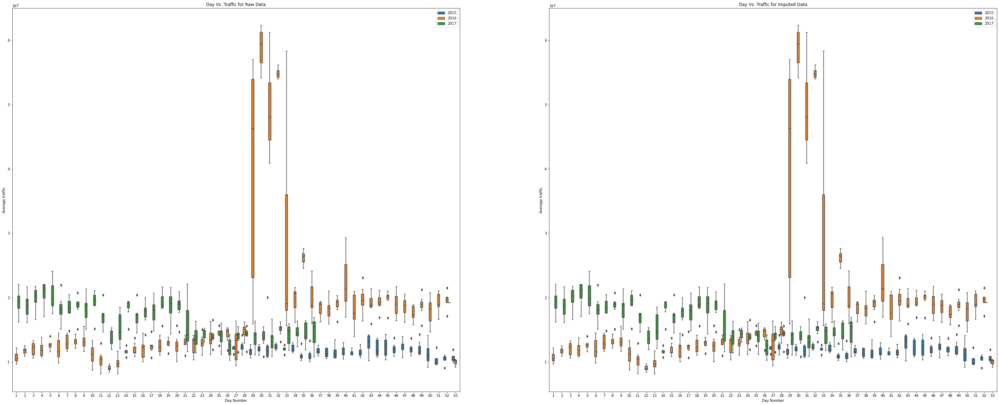

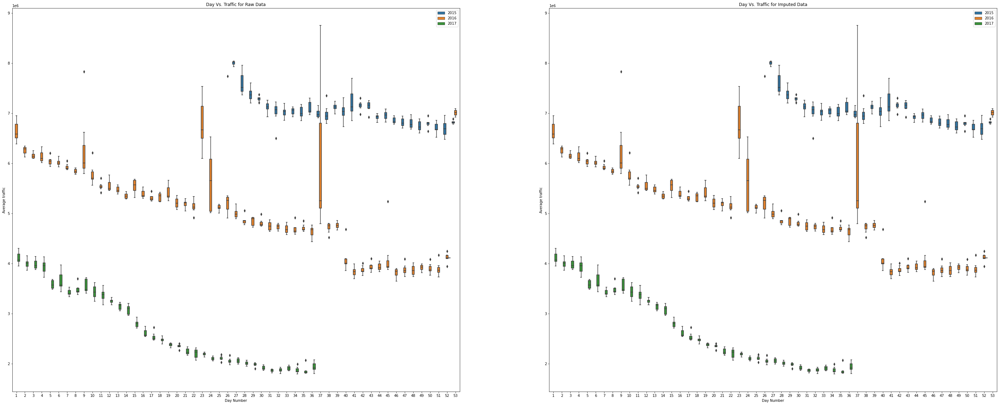

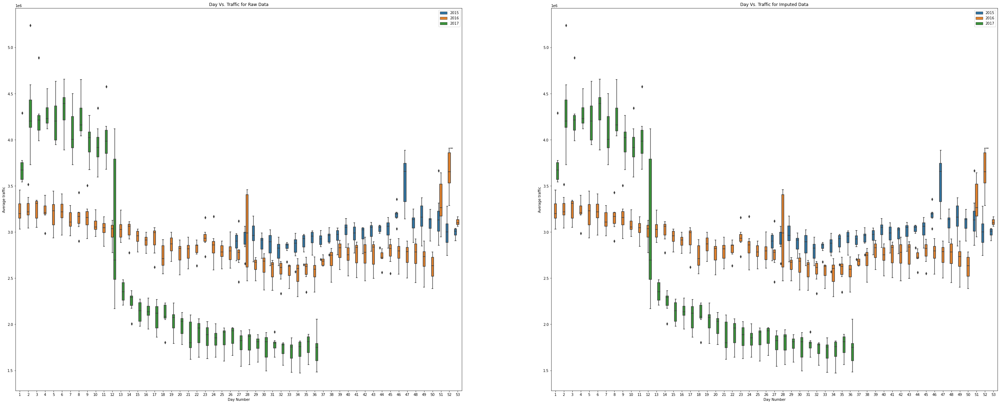

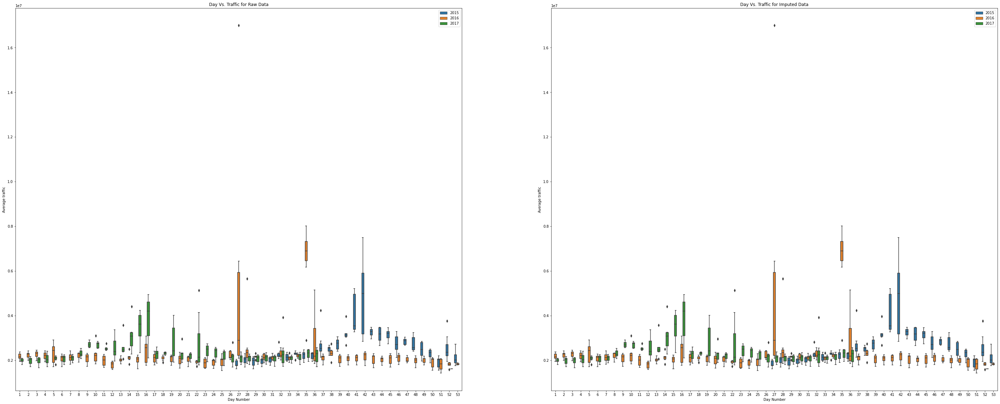

...

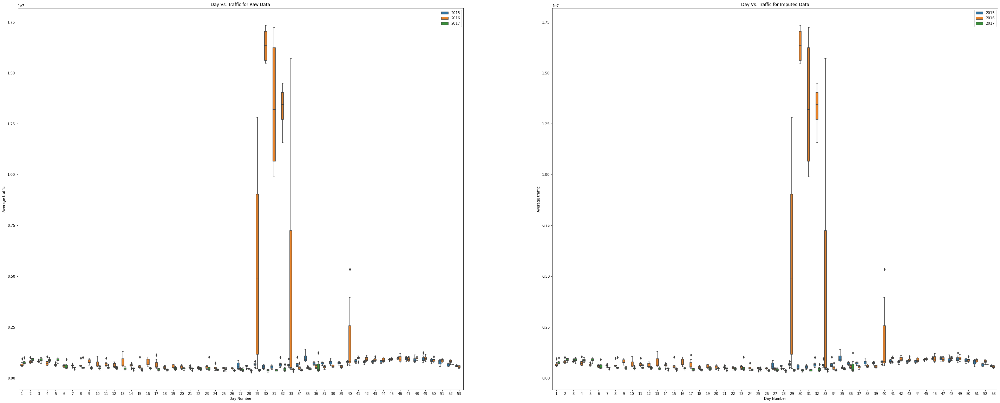

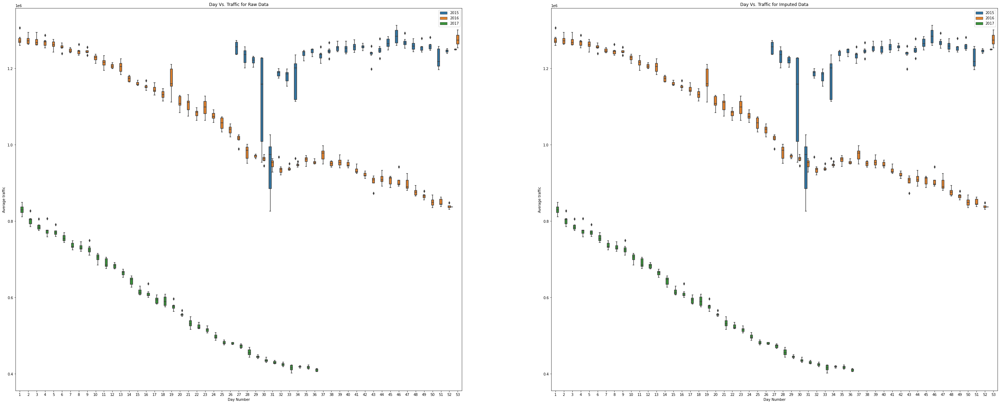

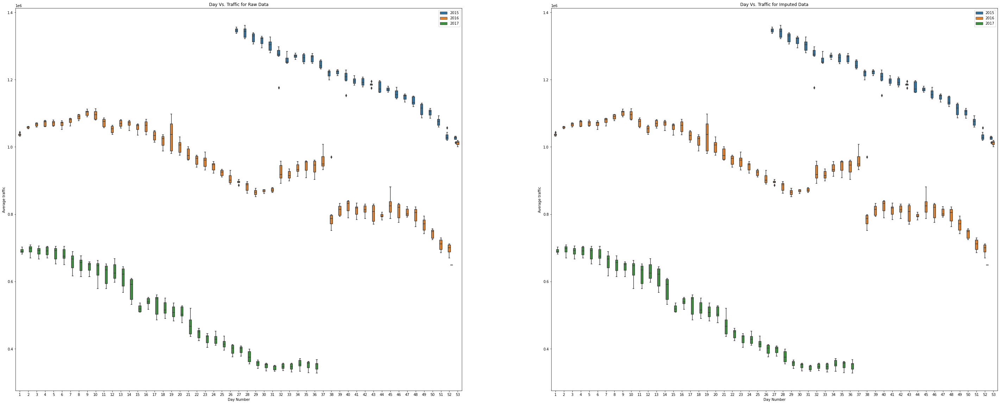

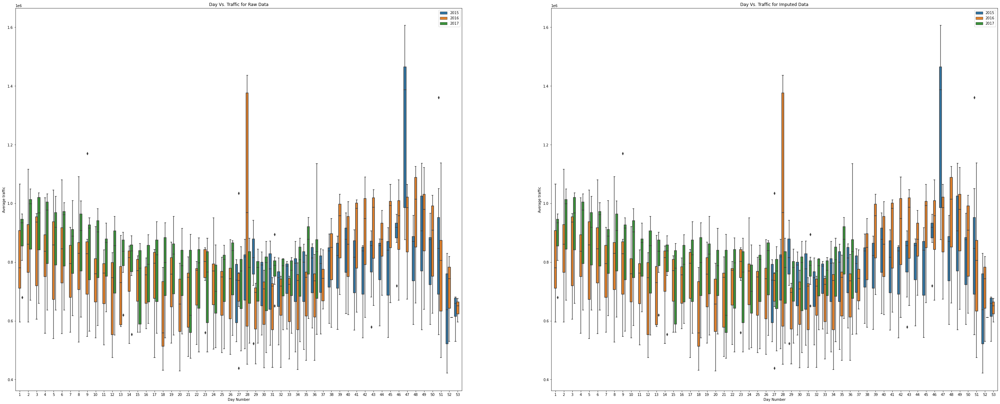

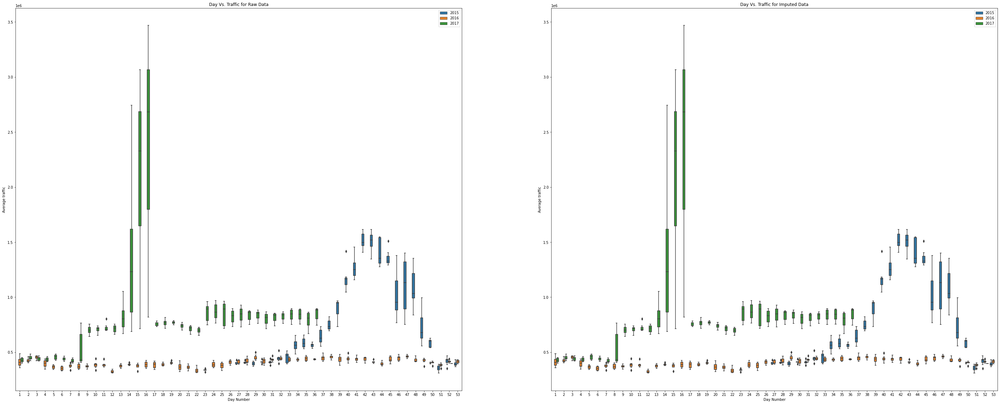

In [ ]:
# Boxplots of week vs. average pagehits.
import seaborn as sns
for i in range(0,15):
    rawhits=eda_train_raw.iloc[i,1:train.shape[1]].values
    imphits=eda_train_imp.iloc[i,1:train.shape[1]].values
    fig,axes=plt.subplots(1,2,figsize=(50,20))
    sns.boxplot(x=week,y=rawhits,hue=year,ax=axes[0])
    axes[0].set_xlabel('Day Number')
    axes[0].set_ylabel("Average traffic")
    axes[0].set_title('Day Vs. Traffic for Raw Data')
    sns.boxplot(x=week,y=imphits,hue=year,ax=axes[1])
    axes[1].set_xlabel('Day Number')
    axes[1].set_ylabel("Average traffic")
    axes[1].set_title('Day Vs. Traffic for Imputed Data')
    
    plt.show()


- It is observed in most cases the weeks in 2015 has higher pagehit values.
- Also there is a downward trend in pagehit values for weeks in 2016
- So weeks and year are important features

#### Plotting the pagehits data of top 15 pages based on the language 

Language  fr


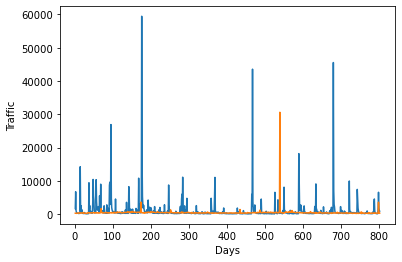

Language  en


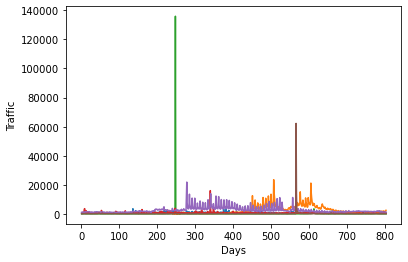

Language  ru


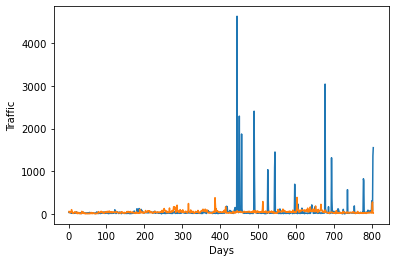

Language  de


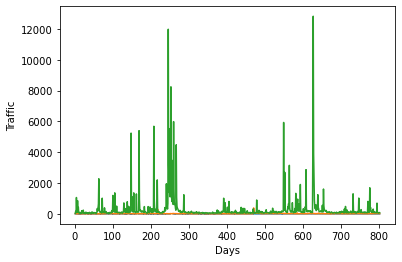

Language  es


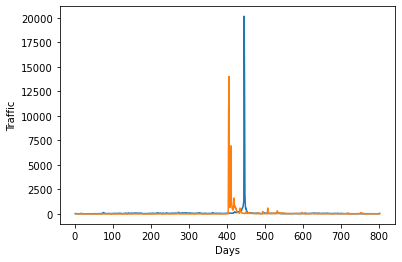

In [ ]:

top_15_raw=eda_train_raw.iloc[:15,:]
top_15_imp=eda_train_imp.iloc[:15,:]
# Plotting the pagehits raw data for top 15 pages based on their languages

for key in lang_df:
    index=top_15_raw.loc[top_15_raw['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')
        plt.show()
    

Language  fr


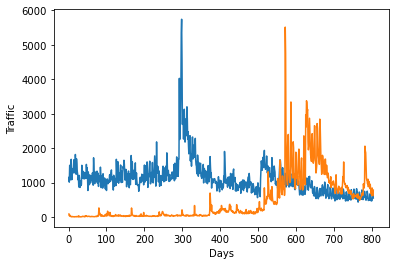

Language  en


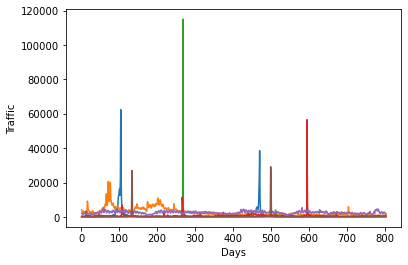

Language  ru


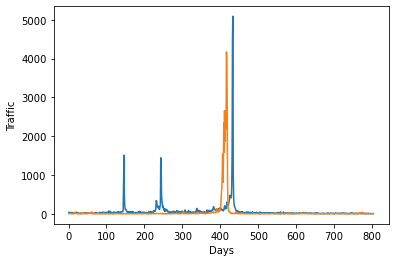

Language  de


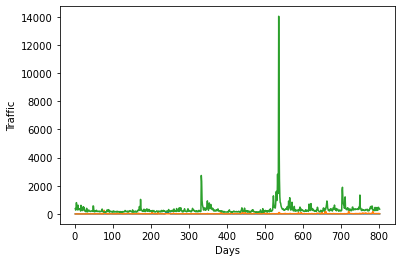

Language  es


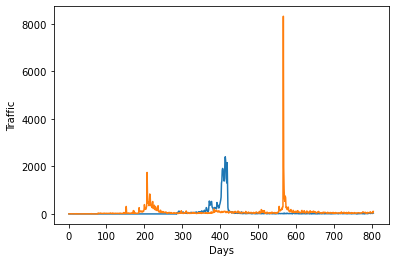

In [ ]:
# Plotting the pagehits imputed data for top 15 pages based on their languages

for key in lang_df:
    index=top_15_raw.loc[top_15_imp['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
    
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

For both raw and imputed data the plots are not similar for each language. I couldn't find any pattern for each language . So I won't be including language as a feature.

Language  fr


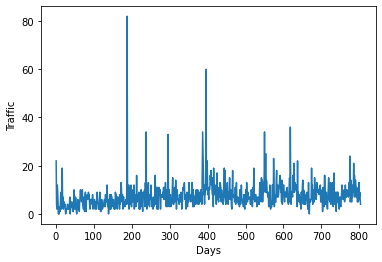

Language  na


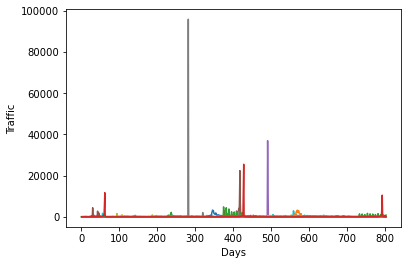

In [ ]:
for key in lang_df:
    index=last_15_raw.loc[last_15_raw['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')
        plt.show()


Language  fr


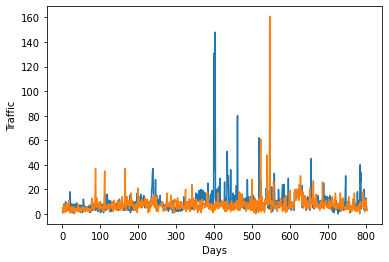

Language  en


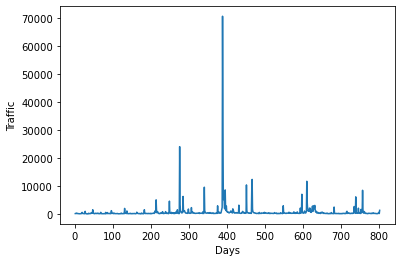

Language  na


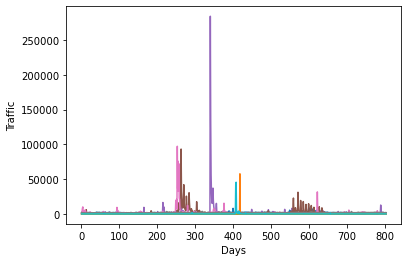

Language  ru


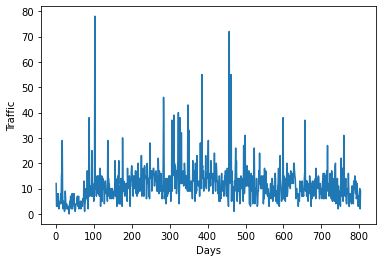

Language  es


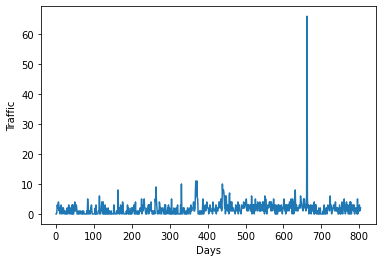

In [ ]:
for key in lang_df:
    index=last_15_imp.loc[last_15_imp['Lang']==key].index
    if len(index)!=0:
        print("Language ",key)
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')
        plt.show()


#### Plotting the pagehits data of top 15 pages for  each access type

Access  0


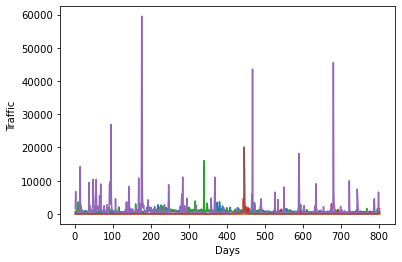

Access  1


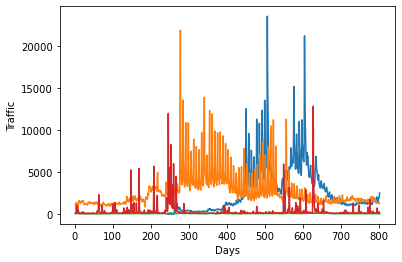

Access  2


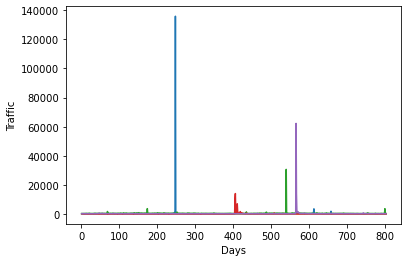

In [ ]:
for key in top_15_raw['Access'].unique():
    index=top_15_raw.loc[top_15_raw['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Access  0


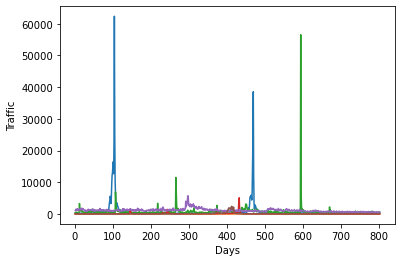

Access  1


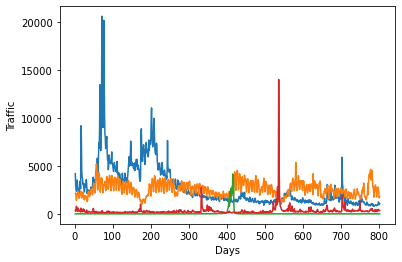

Access  2


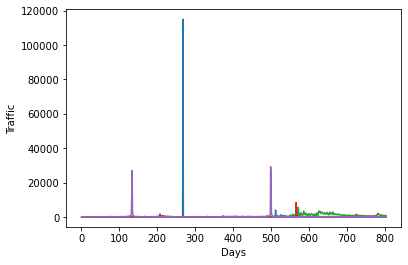

In [ ]:
for key in top_15_imp['Access'].unique():
    index=top_15_imp.loc[top_15_imp['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

For Access type also , I could'nt find any pattern in both raw and imputed top 15 pages. So I am not including this as a feature.

Access  0


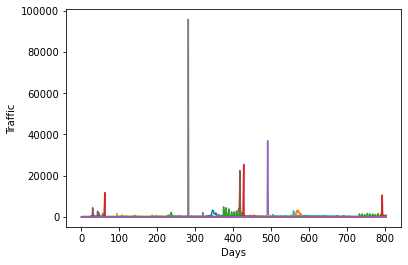

In [ ]:
for key in last_15_raw['Access'].unique():
    index=last_15_raw.loc[last_15_raw['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Access  0


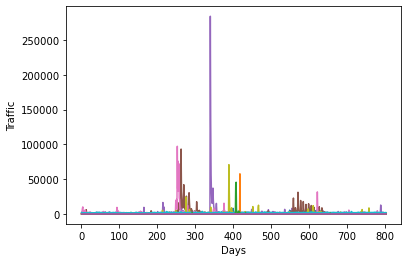

In [ ]:
for key in last_15_imp['Access'].unique():
    index=last_15_imp.loc[last_15_imp['Access']==key].index
    if len(index)!=0:
        print("Access ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

#### Plotting the pagehits data of top 15 pages for  each agent type

Agent  0


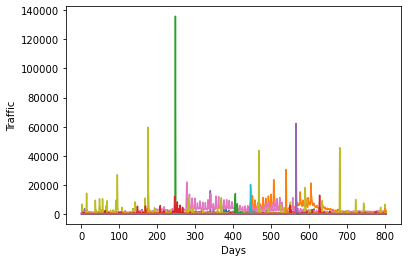

In [ ]:
# Raw Data
for key in top_15_raw['Agent'].unique():
    index=top_15_raw.loc[top_15_raw['Agent']==key].index
    if len(index)!=0:
        print("Agent ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Agent  0


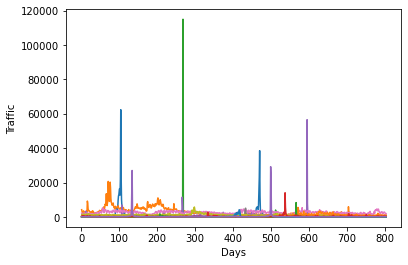

In [ ]:
# Imputed Data
for key in top_15_imp['Agent'].unique():
    index=top_15_imp.loc[top_15_imp['Agent']==key].index
    if len(index)!=0:
        print("Agent ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_imp.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

Agent  1


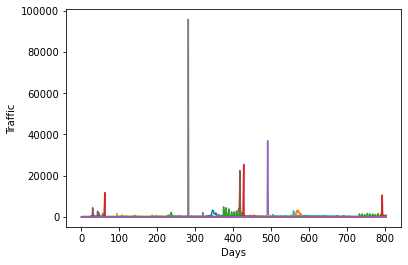

In [ ]:
# Raw Data
for key in last_15_raw['Agent'].unique():
    index=last_15_raw.loc[last_15_raw['Agent']==key].index
    if len(index)!=0:
        print("Agent ",key)
        
        for i in index:
            plt.plot(range(1,len(date_list)+1),eda_train_raw.iloc[i,1:train.shape[1]].values)
            plt.xlabel('Days')
            plt.ylabel('Traffic')

        plt.show()

All the top pages have the same type of agent , So it is difficult to understand if there is a difference for each agent type

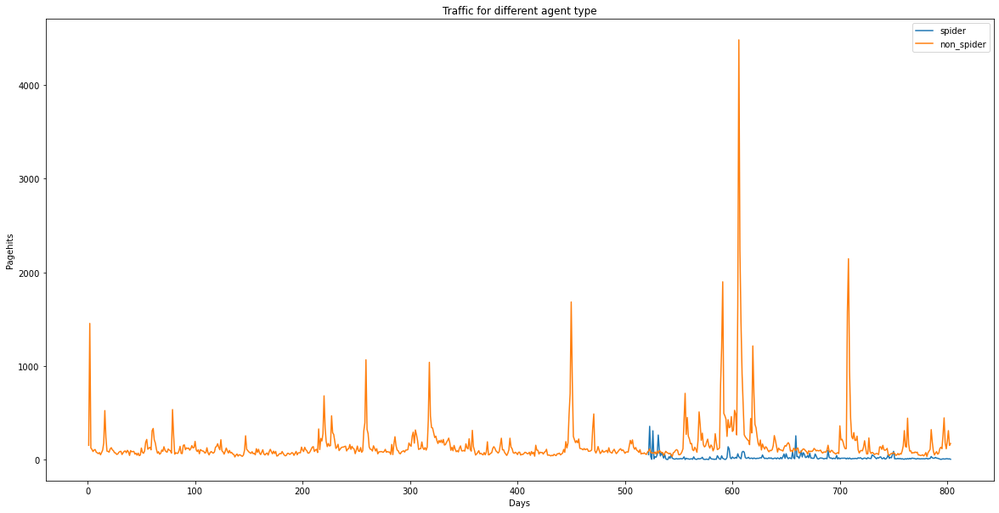

In [ ]:
### Plotting the traffic for 2 random pages of each agent type
n=random.randint(0,100)
plt.figure(figsize=(20,10))
for i in agent_df.keys():
    plt.plot(range(1,len(date_list)+1),agent_df[i].iloc[n,1:],label=i)
plt.xlabel("Days")
plt.ylabel("Pagehits")
plt.title("Traffic for different agent type")

plt.legend()
plt.show()

The pagehit values for spider is  less than the pagehit values for non-spider , so this will be used as a feature.

### Autocorrelation Plots for top 15 pages

 Language for Imputed Data  en


<Figure size 1800x720 with 0 Axes>

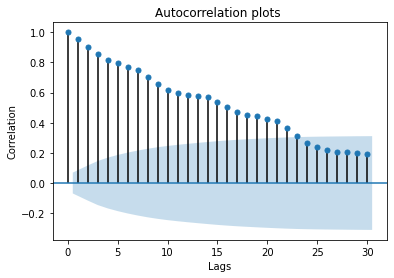

 Language for Imputed Data  en


<Figure size 1800x720 with 0 Axes>

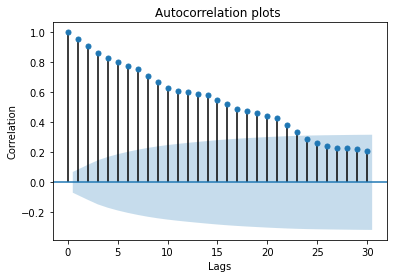

 Language for Imputed Data  en


<Figure size 1800x720 with 0 Axes>

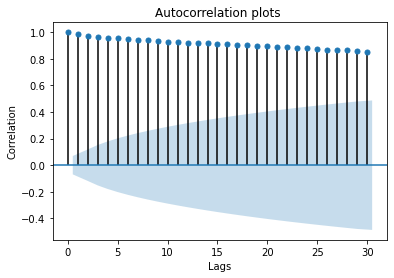

 Language for Imputed Data  de


<Figure size 1800x720 with 0 Axes>

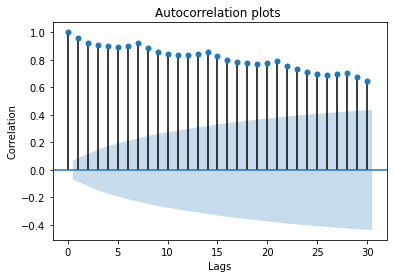

 Language for Imputed Data  en


<Figure size 1800x720 with 0 Axes>

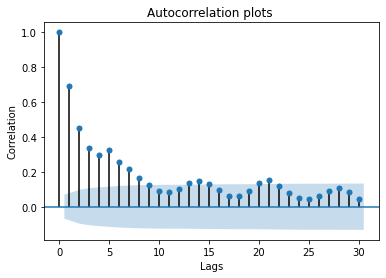

 Language for Imputed Data  de


<Figure size 1800x720 with 0 Axes>

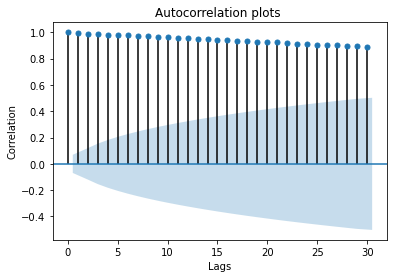

 Language for Imputed Data  en


<Figure size 1800x720 with 0 Axes>

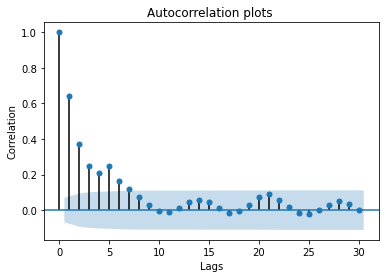

 Language for Imputed Data  ru


<Figure size 1800x720 with 0 Axes>

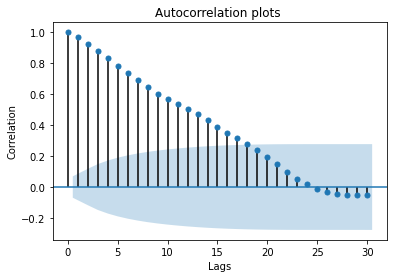

 Language for Imputed Data  fr


<Figure size 1800x720 with 0 Axes>

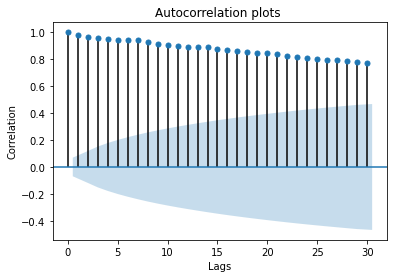

 Language for Imputed Data  es


<Figure size 1800x720 with 0 Axes>

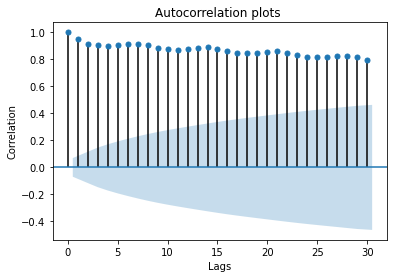

 Language for Imputed Data  ru


<Figure size 1800x720 with 0 Axes>

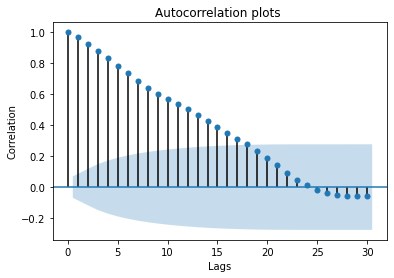

 Language for Imputed Data  fr


<Figure size 1800x720 with 0 Axes>

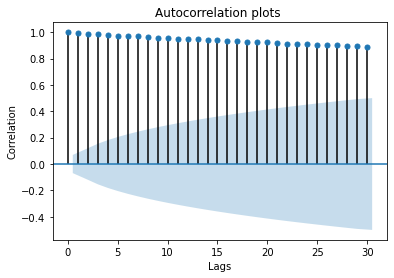

 Language for Imputed Data  es


<Figure size 1800x720 with 0 Axes>

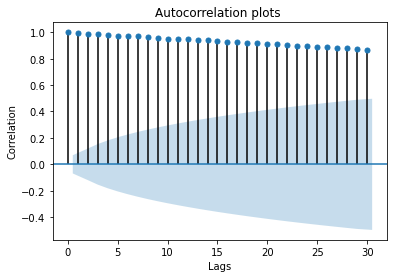

 Language for Imputed Data  de


<Figure size 1800x720 with 0 Axes>

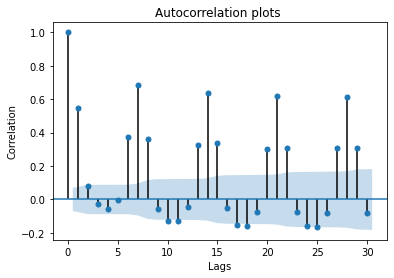

 Language for Imputed Data  en


<Figure size 1800x720 with 0 Axes>

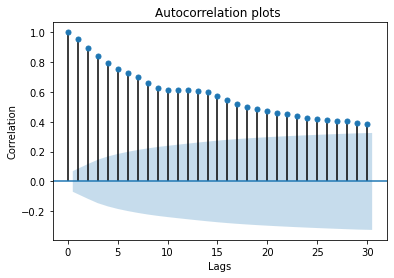

In [ ]:
import statsmodels.api as sm
for i in range(15):
    plt.figure(figsize=(25,10))
    sm.graphics.tsa.plot_acf(x=eda_train_imp.iloc[i,1:train.shape[1]],lags=30)

    print( " Language for Imputed Data ",eda_train_imp.loc[i]['Lang'])
    plt.xlabel('Lags')
    plt.ylabel('Correlation')
    plt.title('Autocorrelation plots ')
    plt.show()

Language for Raw Data  en        Language for Imputed Data  en


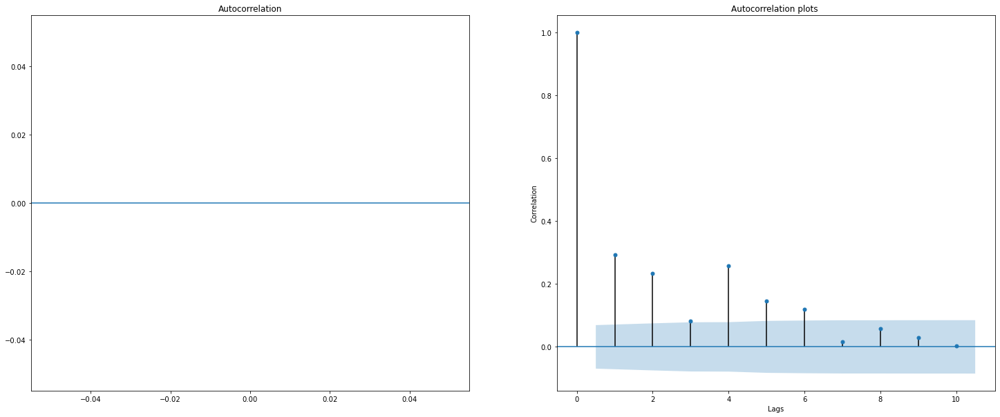

Language for Raw Data  en        Language for Imputed Data  en


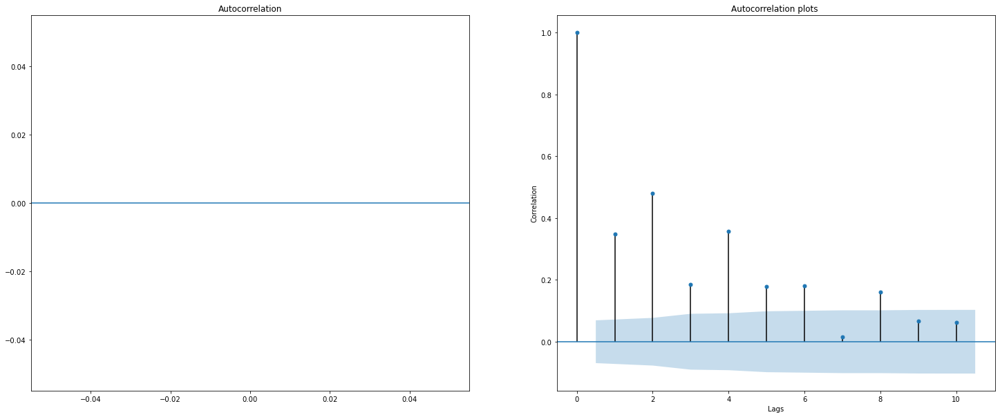

Language for Raw Data  en        Language for Imputed Data  en


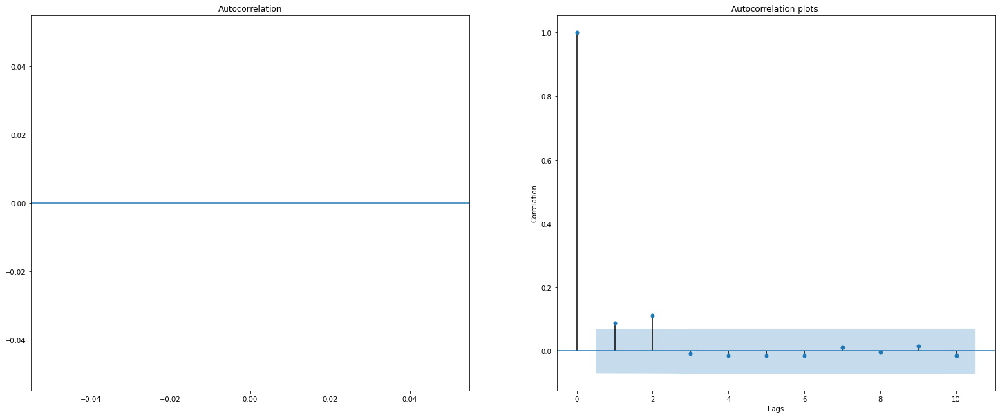

Language for Raw Data  de        Language for Imputed Data  de


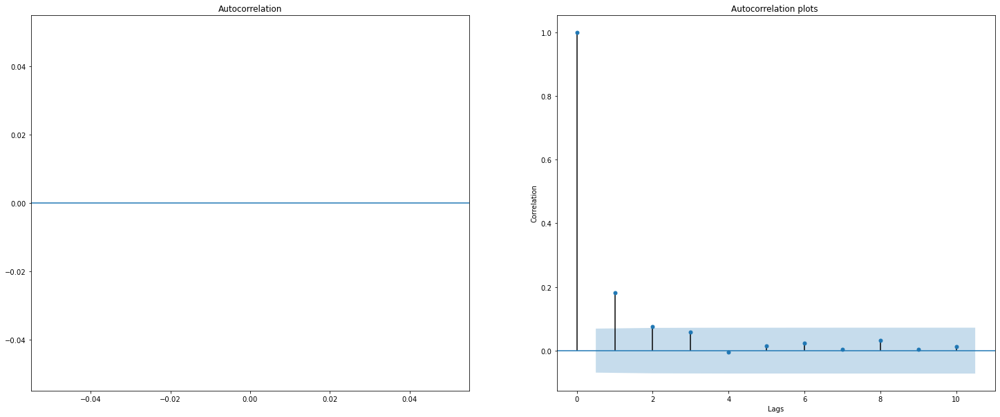

Language for Raw Data  en        Language for Imputed Data  en


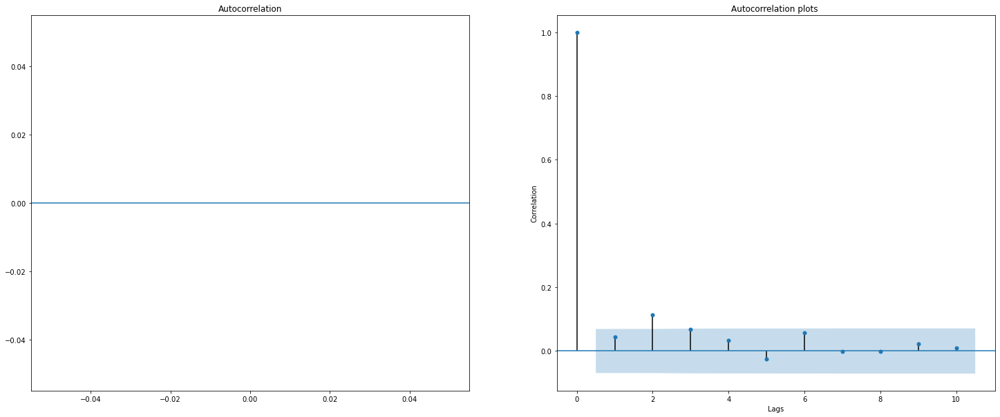

Language for Raw Data  de        Language for Imputed Data  de


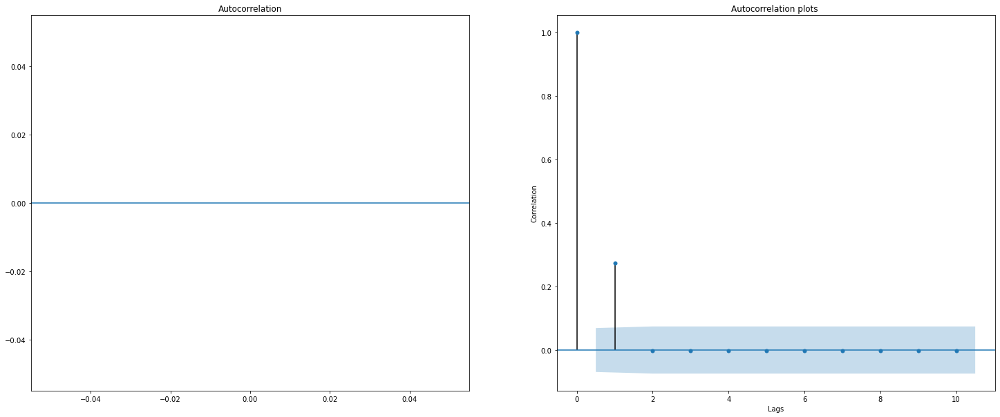

Language for Raw Data  en        Language for Imputed Data  en


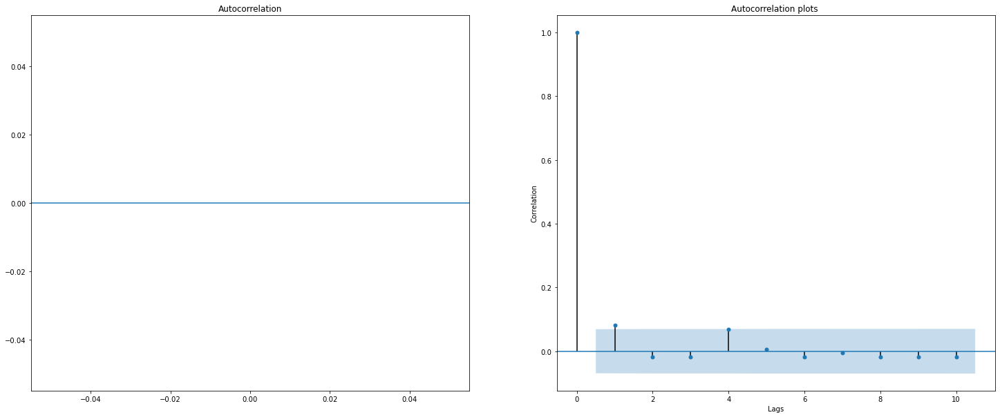

Language for Raw Data  ru        Language for Imputed Data  ru


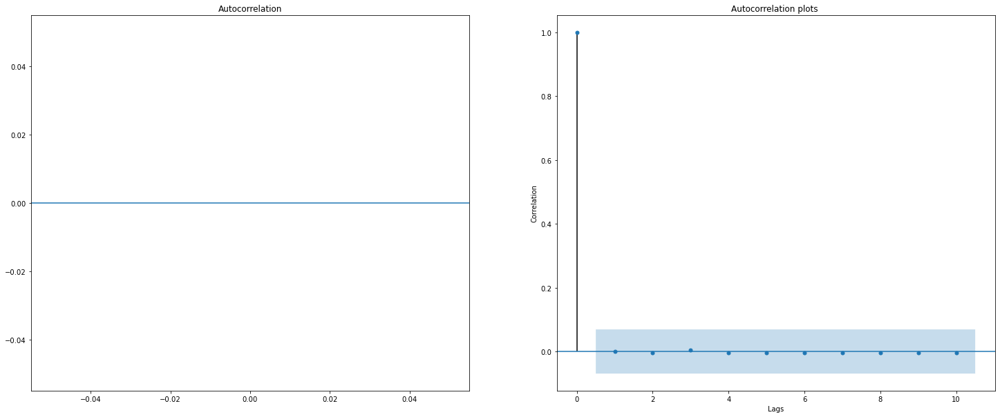

Language for Raw Data  fr        Language for Imputed Data  fr


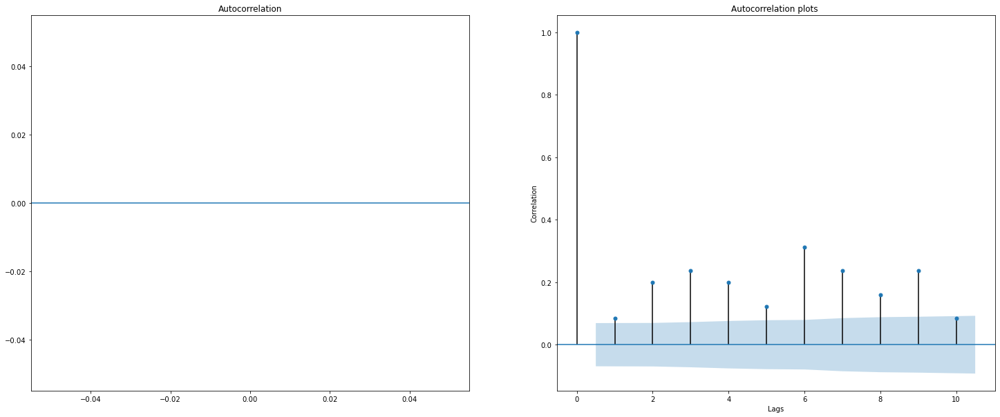

Language for Raw Data  es        Language for Imputed Data  es


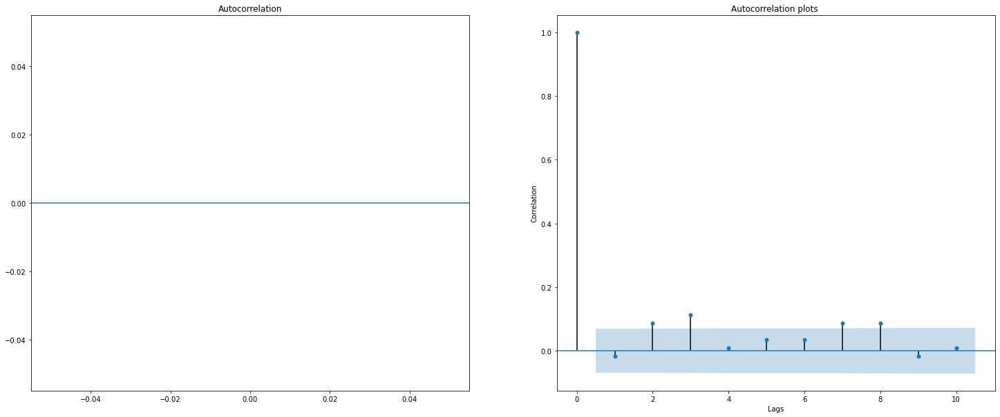

Language for Raw Data  ru        Language for Imputed Data  ru


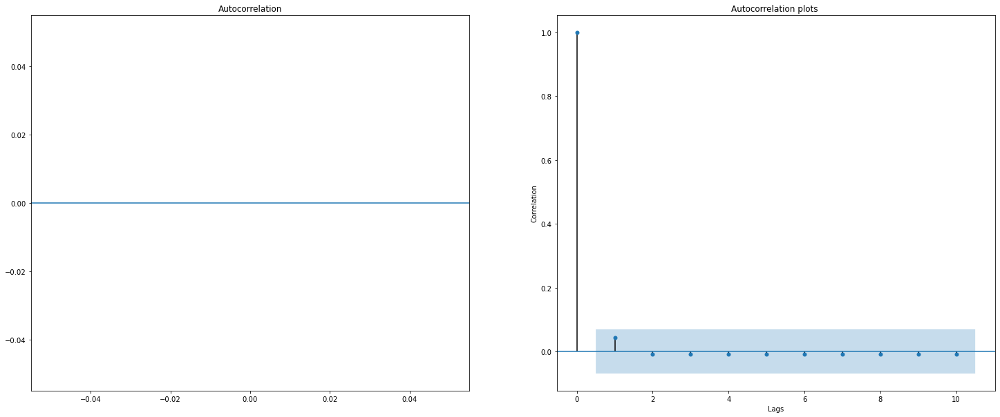

Language for Raw Data  fr        Language for Imputed Data  fr


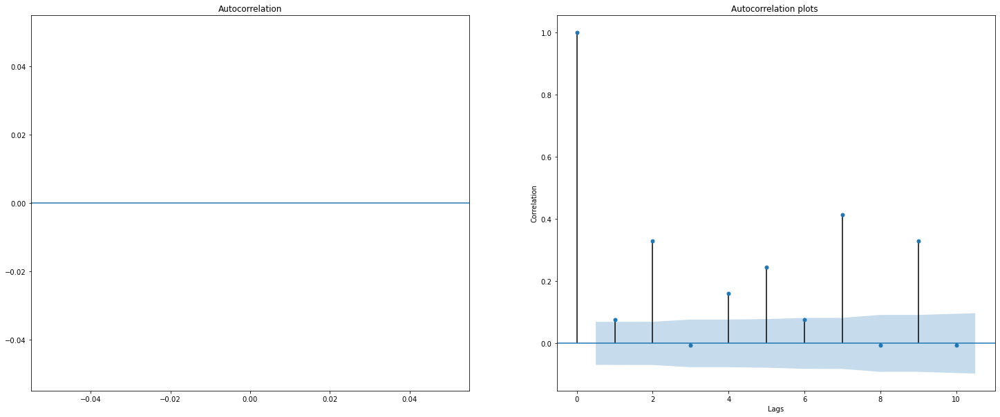

Language for Raw Data  es        Language for Imputed Data  es


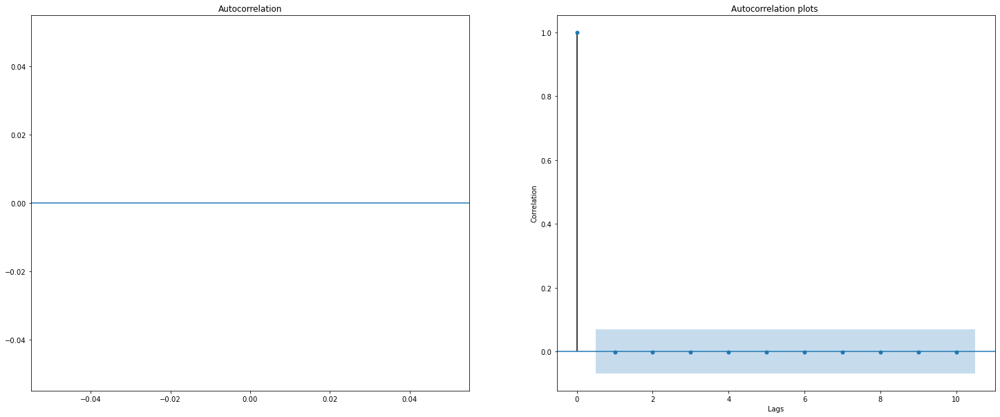

Language for Raw Data  de        Language for Imputed Data  de


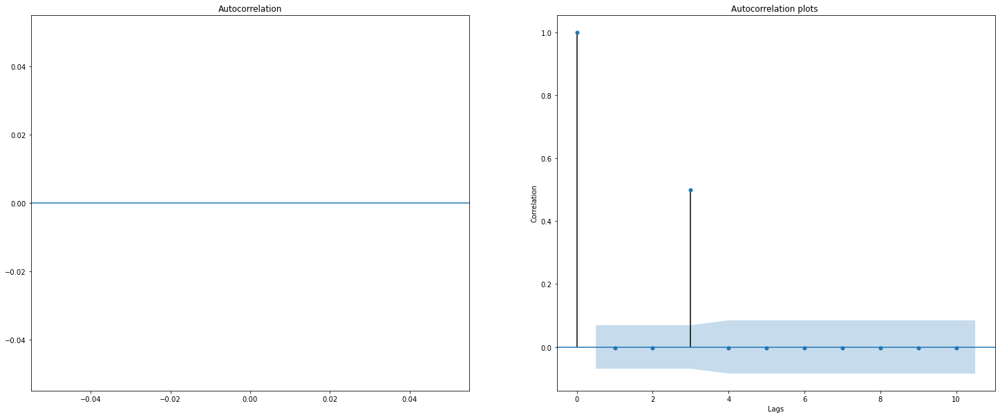

Language for Raw Data  en        Language for Imputed Data  en


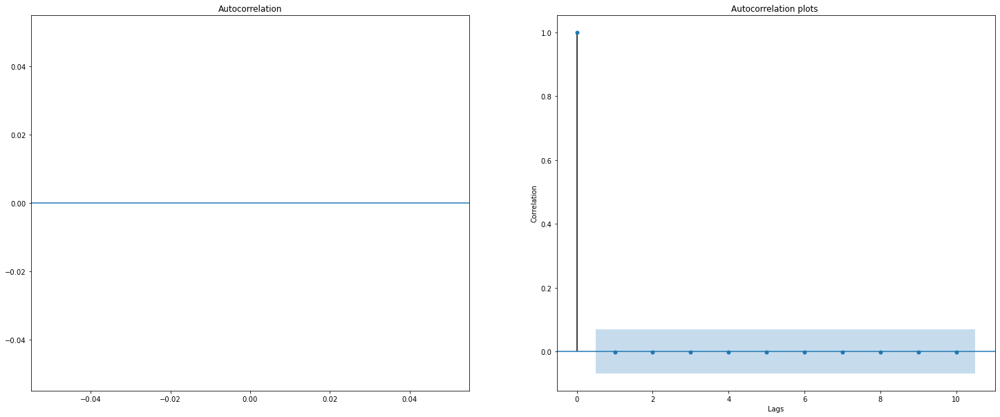

In [ ]:
import statsmodels.api as sm
for i in range(15):
    fig,axes=plt.subplots(1,2,figsize=(25,10))
    sm.graphics.tsa.plot_acf(x=last_15_raw.iloc[i,1:train.shape[1]],lags=10,ax=axes[0])
    sm.graphics.tsa.plot_acf(x=last_15_imp.iloc[i,1:train.shape[1]],lags=10,ax=axes[1])

    print("Language for Raw Data " ,top_15_raw.iloc[i]['Lang'],"       Language for Imputed Data ",top_15_imp.iloc[i]['Lang'])
    plt.xlabel('Lags')
    plt.ylabel('Correlation')
    plt.title('Autocorrelation plots ')
    plt.show()

I observe that the lag value is mostly around 7 for top pages.So the timestep will be 7 for all the LSTM models.

## Feature Development

In [ ]:
eda_train_imp=pd.read_csv('eda_train_imp.csv')

### Global Features

In [ ]:
'''
weekday has been calculated from the datelist 
is_sunday_or_monday feature is created from weekday feature . if weekday is 0 or 6 then its value will be 1 else 0  
'''
is_sunday_or_monday=[]
for i in weekday:
    if i == 0 or i == 6:
        is_sunday_or_monday.append(1)
    else:
        is_sunday_or_monday.append(0)
is_sunday_or_monday=pd.Series(is_sunday_or_monday)

#### Month , is_august and year_half  feature

In [ ]:
'''
month is created from datelist and is_august is created from the month number
year_half feature is created from month number , first 6 months is 1 and second 6 months is 2.
'''
is_august=[]
for i in month:
    if i == 8:
        is_august.append(1)
    else:
        is_august.append(0)
is_august=pd.Series(is_august)

year_half=[]
for i in month:
    if i in [1,2,3,4,5,6] :
        year_half.append(1)
    else :
        year_half.append(2)
year_half=pd.Series(year_half)

In [ ]:
### The above features are irrespective of the page , I will call them global features
global_feat=pd.DataFrame()
global_feat=pd.concat([weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week],axis=1)
global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
global_feat

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week
0,2,0,7,0,2,3,True,False,True,False,31,27
1,3,0,7,0,2,3,False,False,False,False,31,27
2,4,0,7,0,2,3,False,False,False,False,31,27
3,5,0,7,0,2,3,False,False,False,False,31,27
4,6,1,7,0,2,3,False,False,False,False,31,27
...,...,...,...,...,...,...,...,...,...,...,...,...
798,2,0,9,0,2,3,False,False,False,False,30,36
799,3,0,9,0,2,3,False,False,False,False,30,36
800,4,0,9,0,2,3,False,False,False,False,30,36
801,5,0,9,0,2,3,False,False,False,False,30,36


### Page Specific Features 

For page specific features , I am creating different feature sets for different access and agents. So I am grouping the total data by access and agents and finding the 25th percentile value of pagehits for each date of all the groups. These pagehit values will act as the target variable.

In [ ]:
train_pages_min=pd.DataFrame()
for i in eda_imp_pop['Agent'].unique():
    for j in eda_imp_pop['Access'].unique():
        df=pd.DataFrame(eda_train_imp.loc[(eda_train_imp['Agent']==i) & (eda_train_imp['Access']==j)].iloc[:,1:train.shape[1]].quantile(0.25,axis=0)).T
        df['Agent']=i
        df['Access']=j
        train_pages_min=pd.concat([train_pages_min,df],axis=0)
train_pages_min=train_pages_min.reset_index(drop=True)        
train_pages_min        
    

,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,...,2017-09-03,2017-09-04,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Agent,Access
0,16.0,16.0,15.0,14.0,15.0,18.0,17.0,17.0,17.0,16.202381,...,65.0,64.0,65.0,65.0,67.0,65.0,61.25,64.0,0,0
1,24.0,25.0,23.0,20.0,20.0,26.0,26.0,25.0,25.0,24.000000,...,45.0,53.0,54.0,54.0,59.0,53.0,43.00,45.0,0,1
2,12.0,12.0,12.0,15.0,16.0,14.0,14.0,13.0,13.0,13.000000,...,64.0,52.0,50.0,49.0,49.0,50.0,60.00,64.0,0,2
3,1.0,1.0,2.0,2.0,2.0,1.0,1.0,2.0,2.0,2.000000,...,4.0,4.0,4.0,5.0,5.0,5.0,5.00,4.0,1,0
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,2


The last 2 rows have NaN value because these groups do not exist in train data

Here also I have made the same groups but the target values are the 75th percentile of the pagehits for each group

In [ ]:
train_pages_max=pd.DataFrame()
for i in eda_train_imp['Agent'].unique():
    for j in eda_train_imp['Access'].unique():
        df=pd.DataFrame(eda_train_imp.loc[(eda_train_imp['Agent']==i) & (eda_train_imp['Access']==j)].iloc[:,1:train.shape[1]].quantile(0.75,axis=0)).T
        df['Agent']=i
        df['Access']=j
        train_pages_max=pd.concat([train_pages_max,df],axis=0)
train_pages_max=train_pages_max.reset_index(drop=True)        
train_pages_max        
    

,2015-07-01,2015-07-02,2015-07-03,2015-07-04,2015-07-05,2015-07-06,2015-07-07,2015-07-08,2015-07-09,2015-07-10,...,2017-09-03,2017-09-04,2017-09-05,2017-09-06,2017-09-07,2017-09-08,2017-09-09,2017-09-10,Agent,Access
0,897.0,891.0,869.0,848.0,937.0,955.0,945.0,954.0,949.75,943.75,...,1142.0,1078.0,1068.75,1083.75,1106.0,1038.75,1051.0,1169.0,0,0
1,569.0,561.0,524.0,443.0,493.0,601.0,597.0,601.0,601.00,578.00,...,460.0,536.0,550.00,558.00,614.0,511.00,426.0,474.0,0,1
2,447.0,443.0,448.0,491.0,547.0,478.5,471.0,472.0,473.00,477.00,...,800.0,672.0,656.00,649.00,654.0,651.00,731.0,818.0,0,2
3,14.0,13.0,13.0,15.0,15.0,10.0,12.0,13.0,16.00,15.00,...,33.0,30.0,31.00,32.00,44.0,32.00,30.0,30.0,1,0
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,2


The following table is the median view percentage value for each group

In [ ]:
view=eda_train_imp[['Agent','Access','viewperc']].groupby(['Agent','Access']).median()
viewmid=view[['viewperc']].reset_index(drop=True)
viewmid

,viewperc
0,679.435866
1,379.976339
2,404.794521
3,15.835616


### 75th Percentile group
### Group 1

In [ ]:
agent_index=train_pages_max.iloc[0].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

In [ ]:
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_max.iloc[0].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat

,spider,non_spider,All_Access,Desktop,Mobile
0,0,1,1,0,0
1,0,1,1,0,0
2,0,1,1,0,0
3,0,1,1,0,0
4,0,1,1,0,0
...,...,...,...,...,...
798,0,1,1,0,0
799,0,1,1,0,0
800,0,1,1,0,0
801,0,1,1,0,0


### Total Features for group1
 

In [ ]:
# combining the global and page specific features to get the final feature set
total_feat1=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat1.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0


### Target Values for group 1

In [ ]:
### target value as a numpy array
target1 = pd.DataFrame(train_pages_max.iloc[0,0:train.shape[1]-1].values)
target1.columns = ['Target']
target1

,Target
0,897.00
1,891.00
2,869.00
3,848.00
4,937.00
...,...
798,1083.75
799,1106.00
800,1038.75
801,1051.00


### Group2

In [ ]:
agent_index=train_pages_max.iloc[1].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_max.iloc[1].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat2=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat2.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0


In [ ]:
### target value as a numpy array
target2 = pd.DataFrame(train_pages_max.iloc[1,0:train.shape[1]-1].values)
target2.columns = ['Target']
target2

,Target
0,569.0
1,561.0
2,524.0
3,443.0
4,493.0
...,...
798,558.0
799,614.0
800,511.0
801,426.0


### Group  3

In [ ]:
agent_index=train_pages_max.iloc[2].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_max.iloc[2].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat3=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat3.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1


In [ ]:
### target value as a numpy array
target3 = pd.DataFrame(train_pages_max.iloc[2,0:train.shape[1]-1].values)
target3.columns = ['Target']
target3

,Target
0,447.0
1,443.0
2,448.0
3,491.0
4,547.0
...,...
798,649.0
799,654.0
800,651.0
801,731.0


### Group 4

In [ ]:
agent_index=train_pages_max.iloc[3].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_max.iloc[3].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat4=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat4.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
799,3,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
800,4,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
801,5,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
802,6,1,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0


In [ ]:
### target value as a numpy array
target4 = pd.DataFrame(train_pages_max.iloc[3,0:train.shape[1]-1].values)
target4.columns = ['Target']
target4

,Target
0,14.0
1,13.0
2,13.0
3,15.0
4,15.0
...,...
798,32.0
799,44.0
800,32.0
801,30.0


### 25th Percentile Group
## Group1

In [ ]:
agent_index=train_pages_min.iloc[0].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_min.iloc[0].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat5=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat5.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,1,0,0


In [ ]:
### target value as a numpy array
target5 = pd.DataFrame(train_pages_min.iloc[0,0:train.shape[1]-1].values)
target5.columns = ['Target']
target5

,Target
0,16.00
1,16.00
2,15.00
3,14.00
4,15.00
...,...
798,65.00
799,67.00
800,65.00
801,61.25


## Group 2 

In [ ]:
agent_index=train_pages_min.iloc[1].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_min.iloc[1].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat6=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat6.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,0,1,0


In [ ]:
### target value as a numpy array
target6 = pd.DataFrame(train_pages_min.iloc[1,0:train.shape[1]-1].values)
target6.columns = ['Target']
target6

,Target
0,24.0
1,25.0
2,23.0
3,20.0
4,20.0
...,...
798,54.0
799,59.0
800,53.0
801,43.0


## Group 3

In [ ]:
agent_index=train_pages_min.iloc[2].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_min.iloc[2].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat7=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat7.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1


In [ ]:
### target value as a numpy array
target7 = pd.DataFrame(train_pages_min.iloc[2,0:train.shape[1]-1].values)
target7.columns = ['Target']
target7

,Target
0,12.0
1,12.0
2,12.0
3,15.0
4,16.0
...,...
798,49.0
799,49.0
800,50.0
801,60.0


## Group 4

In [ ]:
agent_index=train_pages_min.iloc[3].loc['Agent']
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)
# Combining them to make the page_specific features
# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([page_specific_feat,spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
access_index=train_pages_min.iloc[3].loc['Access']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat
# combining the global and page specific features to get the final feature set
total_feat8=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat8.tail()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
799,3,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
800,4,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
801,5,0,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0
802,6,1,9,0,2,3,False,False,False,False,30,36,1,0,1,0,0


In [ ]:
### target value as a numpy array
target8= pd.DataFrame(train_pages_min.iloc[3,0:train.shape[1]-1].values)
target8.columns = ['Target']
target8

,Target
0,1.0
1,1.0
2,2.0
3,2.0
4,2.0
...,...
798,5.0
799,5.0
800,5.0
801,5.0


### Baseline Model feature development
This is the feature development of the baseline model using any random page.

In [ ]:
'''
Weekday is calculated using datelist ,weekend is calculated as 1 for weekend days and 0 
for weekdays.
Month is also calculated from datelist .Other features like month_start, month_end , quarter_start , quarter_end etc 
are created using this datelist.
'''
from datetime import datetime
datelist=[]
for i in train.columns[1:]:
    datelist.append(datetime.strptime(i, '%Y-%m-%d'))

weekday_test=[]
for i in datelist:
    weekday_test.append(i.weekday())
weekday_test=pd.Series(weekday_test)

month_test=[]
for i in datelist:
    month_test.append(i.month)
month_test=pd.Series(month_test)

month_start_test=[]
month_start_test=pd.Series(datelist).dt.is_month_start

month_end_test=[]
month_end_test=pd.Series(datelist).dt.is_month_end

quarter_start_test=[]
quarter_start_test=pd.Series(datelist).dt.is_quarter_start

quarter_end_test=[]
quarter_end_test=pd.Series(datelist).dt.is_quarter_end

week_test=[]
week_test=pd.Series(datelist).dt.week


quarter_test=[]
quarter_test=pd.Series(datelist).dt.quarter


days_in_month_test=[]
days_in_month_test =pd.Series(datelist).dt.days_in_month

year_test=[]
year_test=pd.Series(datelist).dt.year


'''
weekday has been calculated from the datelist 
is_sunday_or_monday feature is created from weekday feature . if weekday is 0 or 6 then its value will be 1 else 0  
'''
is_sunday_or_monday_test=[]
for i in weekday_test:
    if i == 0 or i == 6:
        is_sunday_or_monday_test.append(1)
    else:
        is_sunday_or_monday_test.append(0)
is_sunday_or_monday_test=pd.Series(is_sunday_or_monday_test)


'''
month is created from datelist and is_august is created from the month number
year_half feature is created from month number , first 6 months is 1 and second 6 months is 2.
'''
is_august_test=[]
for i in month_test:
    if i == 8:
        is_august_test.append(1)
    else:
        is_august_test.append(0)
is_august_test=pd.Series(is_august_test)

year_half_test=[]
for i in month_test:
    if i in [1,2,3,4,5,6] :
        year_half_test.append(1)
    else :
        year_half_test.append(2)
year_half_test=pd.Series(year_half_test)

### The above features are irrespective of the page , I will call them global features
global_feat=pd.DataFrame()
global_feat=pd.concat([weekday_test,is_sunday_or_monday_test,month_test,is_august_test,year_half_test,quarter_test,quarter_start_test,quarter_end_test,month_start_test,month_end_test,days_in_month_test,week_test],axis=1)
global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
global_feat.shape

(803, 12)

In [ ]:
index=random.randint(0,train.shape[0])
page_base=train.iloc[index].loc['Page']
access_index=eda_train_imp.loc[eda_train_imp['Page']==page_base]['Access'].values
agent_index=re.search('spider',page_base)
if agent_index == 1:
    spider=[1]*(train.shape[1]-1)
    non_spider=[0]*(train.shape[1]-1)
else:
    spider=[0]*(train.shape[1]-1)
    non_spider=[1]*(train.shape[1]-1)
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)

# Combining them to make the page_specific features
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
print(access_index)
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1


# combining the global and page specific features to get the final feature set
total_feat_base=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat_base.tail()

[2]


,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
798,2,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
799,3,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
800,4,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
801,5,0,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1
802,6,1,9,0,2,3,False,False,False,False,30,36,0,1,0,0,1


In [ ]:
### target value as a numpy array
target_base = pd.DataFrame(eda_train_imp.loc[eda_train_imp['Page']== page_base].iloc[0,1:train.shape[1]].values)
target_base.columns = ['Target']
target_base['Target']=pd.to_numeric(target_base['Target'])
target_base

,Target
0,846.0
1,2716.0
2,1300.0
3,2498.0
4,988.0
...,...
798,299.0
799,285.0
800,273.0
801,296.0


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(total_feat_base, target_base, test_size = 0.3, random_state = 0,shuffle=False)
print(X_train.shape)
print(X_test.shape)

(562, 17)
(241, 17)


## Model Development

### Data Processing for Baseline Model
The categorical data is label-encoded

In [ ]:
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try us

## Transformation of data
I used for log(1+x) as the transformation because it is easier to inverse transform the forcasted value to get real output.
Also 1+x is used because in some cases the pagehit value is 0 so log transformation is not possible on those values.

In [ ]:
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)


## Baseline Model

In [ ]:
##Taking the mean of the target values as the predicted value
mean_forcast = np.mean(eda_train_imp.iloc[:,1:train.shape[1]].values.flatten())
y_pred=[[mean_forcast]]*X_test.shape[0]
y_pred=pd.DataFrame(y_pred)
y_test_base= pd.DataFrame(y_test)


### Metric for evaluation and score

In [ ]:
def smape(a, f):
    return 1/len(a) * np.sum(2 * np.abs(f-a) / (np.abs(a) + np.abs(f))*100)


In [ ]:
smape(y_pred.values,y_test_base.values)

90.1504513662095

## 75th Percentile Models
Below 4 models are using the 75th percentile pagehit values 

## Model 1


     weekday  is_sunday_or_monday  month  is_august  year_half  quarter  \
0          2                    0      7          0          2        3   
1          3                    0      7          0          2        3   
2          4                    0      7          0          2        3   
3          5                    0      7          0          2        3   
4          6                    1      7          0          2        3   
..       ...                  ...    ...        ...        ...      ...   
557        6                    1      1          0          1        1   
558        0                    1      1          0          1        1   
559        1                    0      1          0          1        1   
560        2                    0      1          0          1        1   
561        3                    0      1          0          1        1   

     quarter_start  quarter_end  month_start  month_end  days_in_month  week  \
0             True 

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = v

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

7/7 [==============================] - ETA: 0s - loss: 1.3129
Epoch 00001: val_loss improved from inf to 0.25593, saving model to model1_new.hdf5
7/7 [==============================] - 2s 273ms/step - loss: 1.3129 - val_loss: 0.2559
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.2619- ETA: 0s - loss: 0.28
Epoch 00002: val_loss improved from 0.25593 to 0.24930, saving model to model1_new.hdf5
7/7 [==============================] - 1s 103ms/step - loss: 0.2619 - val_loss:

Epoch 35/100
7/7 [==============================] - ETA: 0s - loss: 0.0301
Epoch 00035: val_loss did not improve from 0.00756
7/7 [==============================] - 1s 108ms/step - loss: 0.0301 - val_loss: 0.0426
Epoch 36/100
7/7 [==============================] - ETA: 0s - loss: 0.0220
Epoch 00036: val_loss did not improve from 0.00756
7/7 [==============================] - 1s 113ms/step - loss: 0.0220 - val_loss: 0.0328
Epoch 37/100
7/7 [==============================] - ETA: 0s - loss: 0.0178
Epoch 00037: val_loss did not improve from 0.00756
7/7 [==============================] - 1s 123ms/step - loss: 0.0178 - val_loss: 0.0206
Epoch 38/100
7/7 [==============================] - ETA: 0s - loss: 0.0200
Epoch 00038: val_loss did not improve from 0.00756
7/7 [==============================] - 1s 107ms/step - loss: 0.0200 - val_loss: 0.0104
Epoch 39/100
7/7 [==============================] - ETA: 0s - loss: 0.0229
Epoch 00039: val_loss did not improve from 0.00756
7/7 [=================

Epoch 73/100
7/7 [==============================] - ETA: 0s - loss: 0.0179
Epoch 00073: val_loss did not improve from 0.00667
7/7 [==============================] - 1s 97ms/step - loss: 0.0179 - val_loss: 0.0332
Epoch 74/100
7/7 [==============================] - ETA: 0s - loss: 0.0145
Epoch 00074: val_loss did not improve from 0.00667
7/7 [==============================] - 1s 97ms/step - loss: 0.0145 - val_loss: 0.0233
Epoch 75/100
7/7 [==============================] - ETA: 0s - loss: 0.0162
Epoch 00075: val_loss did not improve from 0.00667
7/7 [==============================] - 1s 119ms/step - loss: 0.0162 - val_loss: 0.0196
Epoch 76/100
7/7 [==============================] - ETA: 0s - loss: 0.0188
Epoch 00076: val_loss did not improve from 0.00667
7/7 [==============================] - 1s 113ms/step - loss: 0.0188 - val_loss: 0.0197
Epoch 77/100
7/7 [==============================] - ETA: 0s - loss: 0.0203- ETA: 0s - loss: 0.019
Epoch 00077: val_loss did not improve from 0.00667
7

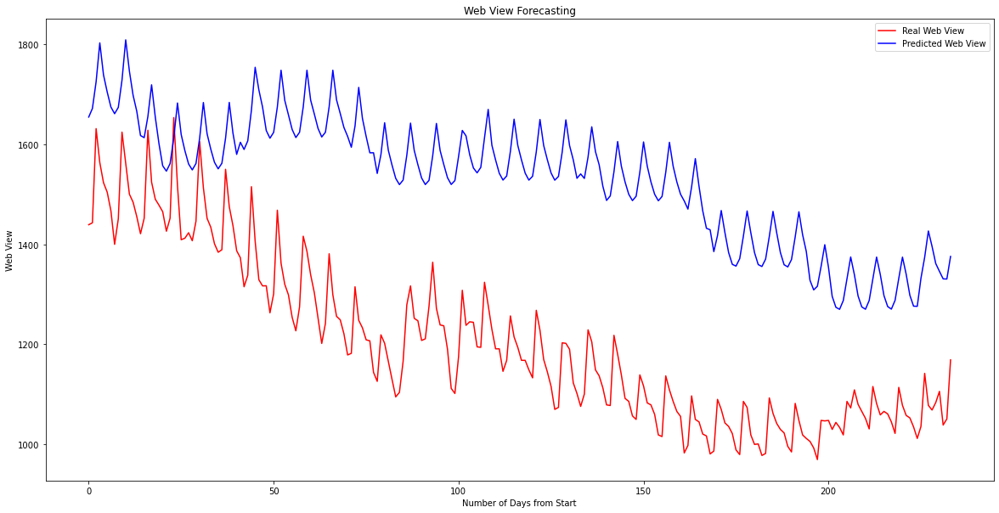

Score for the model  24.38971979578614


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat1, target1, test_size = 0.3, random_state = 0,shuffle=False)
print(X_train)
print(X_test)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model1=Sequential()
model1.add(Bidirectional(
            LSTM(units=256,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model1.add(Dropout(0.5))
model1.add(Bidirectional(
            LSTM(units=32,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model1.add(Dense(1))
opt=Adam(learning_rate=0.001)
model1.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model1_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model1.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model1.load_weights('model1_new.hdf5')
model1.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model1.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Model 2

Epoch 1/100

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p



If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

7/7 [==============================] - ETA: 0s - loss: 1.2878
Epoch 00001: val_loss improved from inf to 0.34814, saving model to model2_new.hdf5
7/7 [==============================] - 2s 273ms/step - loss: 1.2878 - val_loss: 0.3481
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.2815
Epoch 00002: val_loss improved from 0.34814 to 0.14072, saving model to model2_new.hdf5
7/7 [==============================] - 1s 127ms/step - loss: 0.2815 - val_loss: 0.1407
Epoch 3/100
7/7 [========

Epoch 35/100
7/7 [==============================] - ETA: 0s - loss: 0.0598
Epoch 00035: val_loss improved from 0.01840 to 0.01485, saving model to model2_new.hdf5
7/7 [==============================] - 1s 120ms/step - loss: 0.0598 - val_loss: 0.0149
Epoch 36/100
7/7 [==============================] - ETA: 0s - loss: 0.0310
Epoch 00036: val_loss did not improve from 0.01485
7/7 [==============================] - 1s 107ms/step - loss: 0.0310 - val_loss: 0.0182
Epoch 37/100
7/7 [==============================] - ETA: 0s - loss: 0.0276
Epoch 00037: val_loss did not improve from 0.01485
7/7 [==============================] - 1s 108ms/step - loss: 0.0276 - val_loss: 0.0155
Epoch 38/100
7/7 [==============================] - ETA: 0s - loss: 0.0271
Epoch 00038: val_loss did not improve from 0.01485
7/7 [==============================] - 1s 107ms/step - loss: 0.0271 - val_loss: 0.0163
Epoch 39/100
7/7 [==============================] - ETA: 0s - loss: 0.0260
Epoch 00039: val_loss did not improv

Epoch 73/100
7/7 [==============================] - ETA: 0s - loss: 0.0214
Epoch 00073: val_loss did not improve from 0.01207
7/7 [==============================] - 1s 148ms/step - loss: 0.0214 - val_loss: 0.0325
Epoch 74/100
7/7 [==============================] - ETA: 0s - loss: 0.0255
Epoch 00074: val_loss did not improve from 0.01207
7/7 [==============================] - 1s 150ms/step - loss: 0.0255 - val_loss: 0.0130
Epoch 75/100
7/7 [==============================] - ETA: 0s - loss: 0.0318
Epoch 00075: val_loss did not improve from 0.01207
7/7 [==============================] - 1s 122ms/step - loss: 0.0318 - val_loss: 0.0232
Epoch 76/100
7/7 [==============================] - ETA: 0s - loss: 0.0292
Epoch 00076: val_loss did not improve from 0.01207
7/7 [==============================] - 1s 127ms/step - loss: 0.0292 - val_loss: 0.0168
Epoch 77/100
7/7 [==============================] - ETA: 0s - loss: 0.0292
Epoch 00077: val_loss did not improve from 0.01207
7/7 [=================

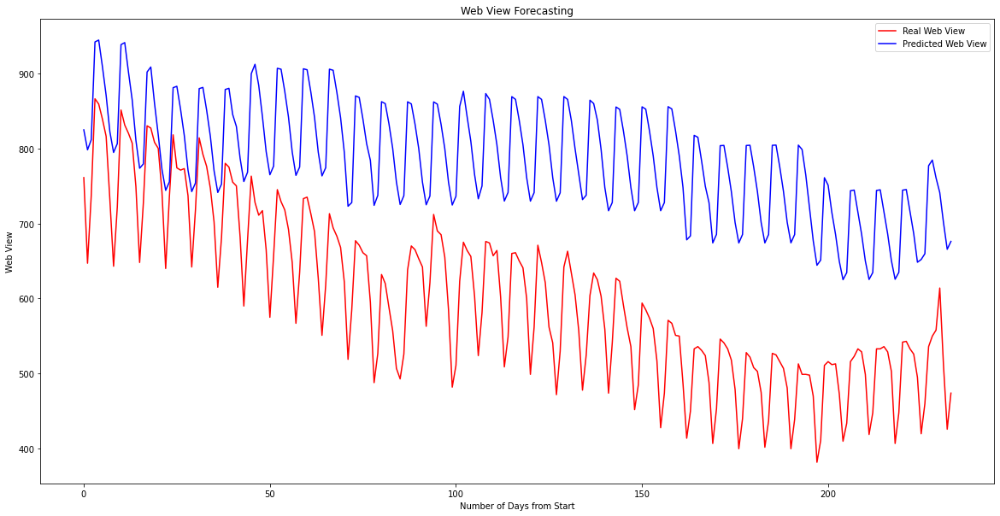

Score for the model  27.847823925487642


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat2, target2, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model2=Sequential()
model2.add(Bidirectional(
            LSTM(units=256,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model2.add(Dropout(0.5))
model2.add(Bidirectional(
            LSTM(units=32,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model2.add(Dense(1))
opt=Adam(learning_rate=0.001)
model2.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model2_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model2.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model2.load_weights('model2_new.hdf5')
model2.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model2.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Model 3

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

6/7 [========================>.....] - ETA: 0s - loss: 1.8193
Epoch 00001: val_loss improved from inf to 1.27422, saving model to model3_new.hdf5
7/7 [==============================] - 1s 204ms/step - loss: 1.7654 - val_loss: 1.2742
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.9583
Epoch 00002: val_loss improved from 1.27422 to 0.09126, saving model to model3_new.hdf5
7/7 [==============================] - 0s 38ms/step - loss: 0.9583 - val_loss: 0.0913
Epoch 3/100
7/7 [==============================] - ETA: 0s - loss: 0.2744
Epoch 00003: val_loss did not improve from 0.09126
7/7 [==============================] - 0s 30ms/step - loss: 0.2744 - val_loss: 0.4764
Epoch 4/100
7/7 [==============================] - ETA: 0s - loss: 0.2889
Epoch 00004: val_loss did not improve from 0.09126
7/7 [==============================] - 0s 28ms/step - loss: 0.2889 - val_loss: 0.0995
Epoch 5/100
7/7 [==============================] - ETA: 0s - loss: 0.2499
Epoch 00005: val_loss d

Epoch 77/100
7/7 [==============================] - ETA: 0s - loss: 0.0325
Epoch 00077: val_loss did not improve from 0.01983
7/7 [==============================] - 0s 30ms/step - loss: 0.0325 - val_loss: 0.0744
Epoch 78/100
7/7 [==============================] - ETA: 0s - loss: 0.0293
Epoch 00078: val_loss did not improve from 0.01983
7/7 [==============================] - 0s 33ms/step - loss: 0.0293 - val_loss: 0.0730
Epoch 79/100
7/7 [==============================] - ETA: 0s - loss: 0.0254
Epoch 00079: val_loss did not improve from 0.01983
7/7 [==============================] - 0s 30ms/step - loss: 0.0254 - val_loss: 0.0614
Epoch 80/100
7/7 [==============================] - ETA: 0s - loss: 0.0302
Epoch 00080: val_loss did not improve from 0.01983
7/7 [==============================] - 0s 30ms/step - loss: 0.0302 - val_loss: 0.0642
Epoch 81/100
7/7 [==============================] - ETA: 0s - loss: 0.0284
Epoch 00081: val_loss did not improve from 0.01983
7/7 [=====================

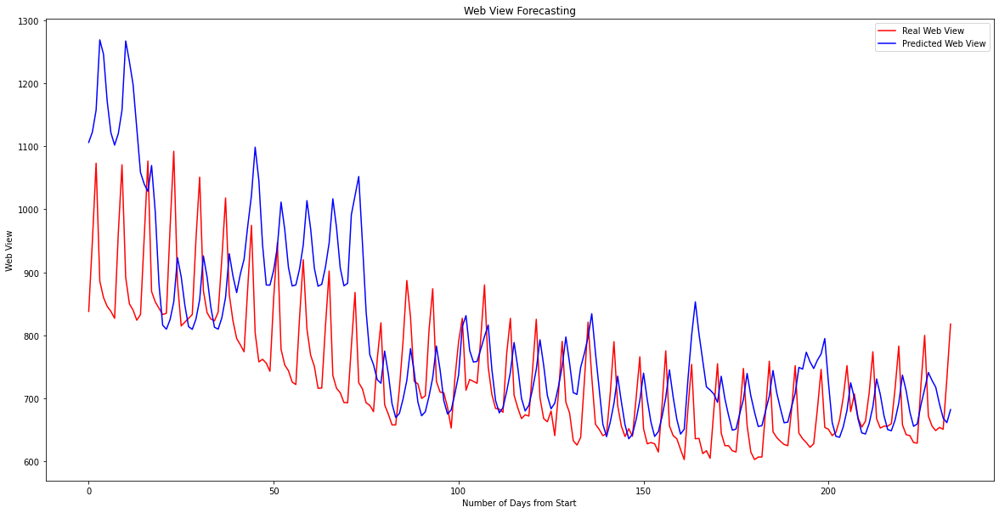

Score for the model  10.845792106033201


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat3, target3, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model3=Sequential()
model3.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model3.add(Dropout(0.5))
model3.add(Bidirectional(
            LSTM(units=12,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model3.add(Dense(1))
opt=Adam(learning_rate=0.001)
model3.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model3_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model3.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model3.load_weights('model3_new.hdf5')
model3.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model3.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Model 4

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

6/7 [========================>.....] - ETA: 0s - loss: 1.3051
Epoch 00001: val_loss improved from inf to 0.11441, saving model to model4_new.hdf5
7/7 [==============================] - 1s 214ms/step - loss: 1.1655 - val_loss: 0.1144
Epoch 2/100
6/7 [========================>.....] - ETA: 0s - loss: 0.2678
Epoch 00002: val_loss did not improve from 0.11441
7/7 [==============================] - 0s 59ms/step - loss: 0.2709 - val_loss: 0.2653
Epoch 3/100
6/7 [========================>.....] - E

Epoch 36/100
7/7 [==============================] - ETA: 0s - loss: 0.0859
Epoch 00036: val_loss did not improve from 0.02090
7/7 [==============================] - 0s 63ms/step - loss: 0.0859 - val_loss: 0.0268
Epoch 37/100
7/7 [==============================] - ETA: 0s - loss: 0.1124
Epoch 00037: val_loss did not improve from 0.02090
7/7 [==============================] - 1s 78ms/step - loss: 0.1124 - val_loss: 0.1167
Epoch 38/100
7/7 [==============================] - ETA: 0s - loss: 0.0736
Epoch 00038: val_loss did not improve from 0.02090
7/7 [==============================] - 0s 64ms/step - loss: 0.0736 - val_loss: 0.0269
Epoch 39/100
7/7 [==============================] - ETA: 0s - loss: 0.1434
Epoch 00039: val_loss did not improve from 0.02090
7/7 [==============================] - 0s 64ms/step - loss: 0.1434 - val_loss: 0.1291
Epoch 40/100
7/7 [==============================] - ETA: 0s - loss: 0.1098
Epoch 00040: val_loss did not improve from 0.02090
7/7 [=====================

Epoch 75/100
7/7 [==============================] - ETA: 0s - loss: 0.0998
Epoch 00075: val_loss did not improve from 0.02090
7/7 [==============================] - 0s 68ms/step - loss: 0.0998 - val_loss: 0.1007
Epoch 76/100
7/7 [==============================] - ETA: 0s - loss: 0.0792
Epoch 00076: val_loss did not improve from 0.02090
7/7 [==============================] - 0s 71ms/step - loss: 0.0792 - val_loss: 0.0501
Epoch 77/100
7/7 [==============================] - ETA: 0s - loss: 0.0950
Epoch 00077: val_loss did not improve from 0.02090
7/7 [==============================] - 1s 84ms/step - loss: 0.0950 - val_loss: 0.1081
Epoch 78/100
7/7 [==============================] - ETA: 0s - loss: 0.0704
Epoch 00078: val_loss did not improve from 0.02090
7/7 [==============================] - 1s 79ms/step - loss: 0.0704 - val_loss: 0.0351
Epoch 79/100
7/7 [==============================] - ETA: 0s - loss: 0.1069
Epoch 00079: val_loss did not improve from 0.02090
7/7 [=====================

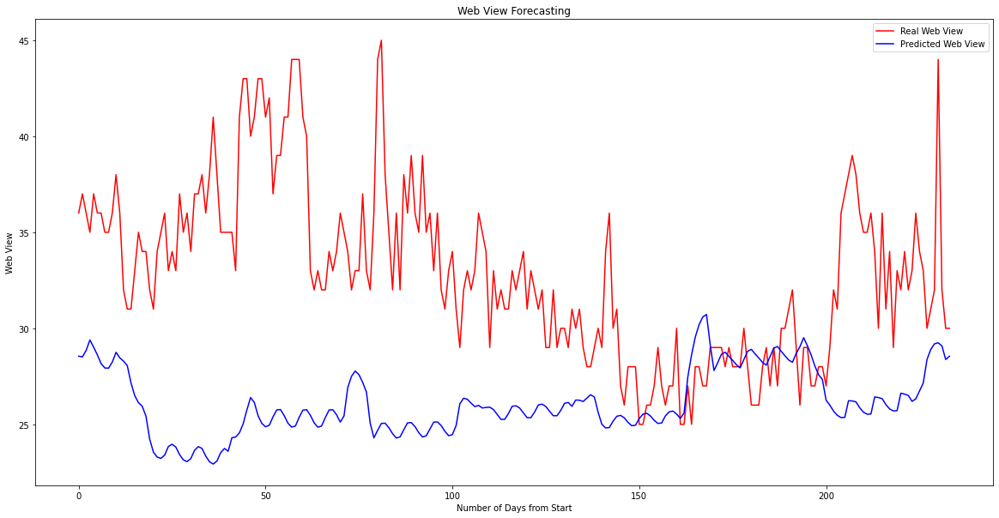

Score for the model  23.12621253770453


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat4, target4, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model4=Sequential()
model4.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model4.add(Dropout(0.2))
model4.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model4.add(Dense(1))
opt=Adam(learning_rate=0.001)
model4.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model4_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model4.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model4.load_weights('model4_new.hdf5')
model4.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model4.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## 25% percentile group
## Model 5

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

6/7 [========================>.....] - ETA: 0s - loss: 1.2823
Epoch 00001: val_loss improved from inf to 0.10164, saving model to model5_new.hdf5
7/7 [==============================] - 1s 213ms/step - loss: 1.1633 - val_loss: 0.1016
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.2612
Epoch 00002: val_loss did not improve from 0.10164
7/7 [==============================] - 1s 75ms/step - loss: 0.2612 - val_loss: 0.2019
Epoch 3/100
6/7 [========================>.....] - ETA: 0s - loss: 0.3652
Epoch 00003: val_loss did not improve from 0.10164
7/7 [==============================] - 0s 57ms/step - loss: 0.3504 - val_loss: 0.2269
Epoch 4/100
7/7 [==============================] - ETA: 0s - loss: 0.2029
Epoch 00004: val_loss improved from 0.10164 to 0.09908, saving model to model5_new.hdf5
7/7 [==============================] - 0s 60ms/step - loss: 0.2029 - val_loss: 0.0991
Epoch 5/100
7/7 [==============================] - ETA: 0s - loss: 0.1316
Epoch 00005: val_loss i

Epoch 78/100
7/7 [==============================] - ETA: 0s - loss: 0.0929
Epoch 00078: val_loss did not improve from 0.02207
7/7 [==============================] - 0s 53ms/step - loss: 0.0929 - val_loss: 0.2187
Epoch 79/100
7/7 [==============================] - ETA: 0s - loss: 0.1082
Epoch 00079: val_loss did not improve from 0.02207
7/7 [==============================] - 1s 73ms/step - loss: 0.1082 - val_loss: 0.2780
Epoch 80/100
7/7 [==============================] - ETA: 0s - loss: 0.0881
Epoch 00080: val_loss did not improve from 0.02207
7/7 [==============================] - 1s 75ms/step - loss: 0.0881 - val_loss: 0.1973
Epoch 81/100
6/7 [========================>.....] - ETA: 0s - loss: 0.1164
Epoch 00081: val_loss did not improve from 0.02207
7/7 [==============================] - 0s 59ms/step - loss: 0.1242 - val_loss: 0.2859
Epoch 82/100
6/7 [========================>.....] - ETA: 0s - loss: 0.0910
Epoch 00082: val_loss did not improve from 0.02207
7/7 [=====================

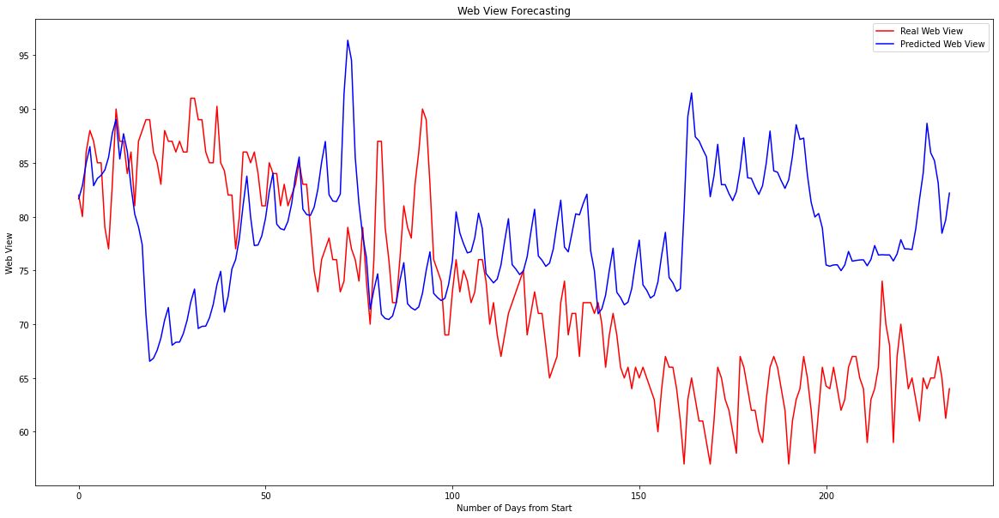

Score for the model  14.192116597940725


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat5, target5, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model5=Sequential()
model5.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model5.add(Dropout(0.2))
model5.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model5.add(Dense(1))
opt=Adam(learning_rate=0.001)
model5.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model5_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model5.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model5.load_weights('model5_new.hdf5')
model5.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model5.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Model 6

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

7/7 [==============================] - ETA: 0s - loss: 1.4928
Epoch 00001: val_loss improved from inf to 0.61005, saving model to model6_new.hdf5
7/7 [==============================] - 1s 178ms/step - loss: 1.4928 - val_loss: 0.6100
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.3496
Epoch 00002: val_loss improved from 0.61005 to 0.57786, saving model to model6_new.hdf5
7/7 [==============================] - 0s 60ms/step - loss: 0.3496 - val_loss: 0.5779
Epoch 3/100
7/7 [==============================] - ETA: 0s - loss: 0.3486
Epoch 00003: val_loss improved from 0.57786 to 0.05109, saving model to model6_new.hdf5
7/7 [==============================] - 0s 64ms/step - loss: 0.3486 - val_loss: 0.0511
Epoch 4/100
7/7 [==============================] - ETA: 0s - loss: 0.2147
Epoch 00004: val_loss did not improve from 0.05109
7/7 [==============================] - 0s 54ms/step - loss: 0.2147 - val_loss: 0.0703
Epoch 5/100
7/7 [==============================] - ETA: 0s -

Epoch 39/100
7/7 [==============================] - ETA: 0s - loss: 0.1146
Epoch 00039: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 55ms/step - loss: 0.1146 - val_loss: 0.1638
Epoch 40/100
7/7 [==============================] - ETA: 0s - loss: 0.0813
Epoch 00040: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 57ms/step - loss: 0.0813 - val_loss: 0.0808
Epoch 41/100
7/7 [==============================] - ETA: 0s - loss: 0.1170
Epoch 00041: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 59ms/step - loss: 0.1170 - val_loss: 0.1530
Epoch 42/100
6/7 [========================>.....] - ETA: 0s - loss: 0.0739
Epoch 00042: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 56ms/step - loss: 0.0797 - val_loss: 0.0937
Epoch 43/100
7/7 [==============================] - ETA: 0s - loss: 0.1071
Epoch 00043: val_loss did not improve from 0.01727
7/7 [=====================

Epoch 78/100
7/7 [==============================] - ETA: 0s - loss: 0.0632
Epoch 00078: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 55ms/step - loss: 0.0632 - val_loss: 0.1122
Epoch 79/100
7/7 [==============================] - ETA: 0s - loss: 0.0934
Epoch 00079: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 59ms/step - loss: 0.0934 - val_loss: 0.1741
Epoch 80/100
7/7 [==============================] - ETA: 0s - loss: 0.0638
Epoch 00080: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 54ms/step - loss: 0.0638 - val_loss: 0.1055
Epoch 81/100
6/7 [========================>.....] - ETA: 0s - loss: 0.0963
Epoch 00081: val_loss did not improve from 0.01727
7/7 [==============================] - 0s 55ms/step - loss: 0.0997 - val_loss: 0.1756
Epoch 82/100
7/7 [==============================] - ETA: 0s - loss: 0.0733
Epoch 00082: val_loss did not improve from 0.01727
7/7 [=====================

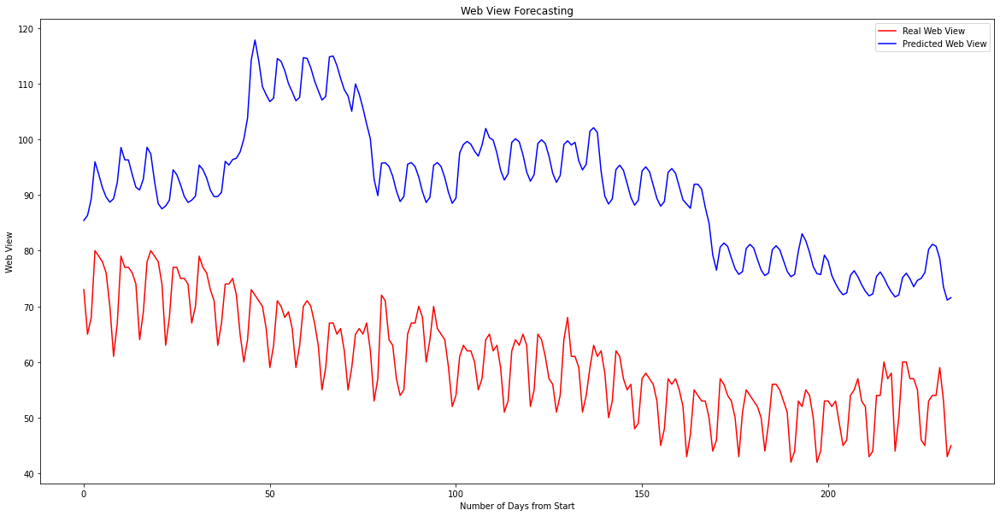

Score for the model  41.20244996258066


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat6, target6, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model6=Sequential()
model6.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model6.add(Dropout(0.2))
model6.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model6.add(Dense(1))
opt=Adam(learning_rate=0.001)
model6.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model6_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model6.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model6.load_weights('model6_new.hdf5')
model6.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model6.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Model 7

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.



C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

7/7 [==============================] - ETA: 0s - loss: 1.0925
Epoch 00001: val_loss improved from inf to 0.24712, saving model to model7_new.hdf5
7/7 [==============================] - 1s 173ms/step - loss: 1.0925 - val_loss: 0.2471
Epoch 2/100
7/7 [==============================] - ETA: 0s - loss: 0.3620
Epoch 00002: val_loss improved from 0.24712 to 0.17161, saving model to model7_new.hdf5
7/7 [==============================] - 0s 61ms/step - loss: 0.3620 - val_loss: 0.1716
Epoch 3/100
6/7 [========================>.....] - ETA: 0s - loss: 0.4157
Epoch 00003: val_loss did not improve from 0.17161
7/7 [==============================] - 0s 56ms/step - loss: 0.4283 - val_loss: 0.5180
Epoch 4/100
7/7 [==============================] - ETA: 0s - loss: 0.2709
Epoch 00004: val_loss improved from 0.17161 to 0.06039, saving model to model7_new.hdf5
7/7 [==============================] - 0s 61ms/step - loss: 0.2709 - val_loss: 0.0604
Epoch 5/100
6/7 [========================>.....] - ETA: 0s -

Epoch 77/100
6/7 [========================>.....] - ETA: 0s - loss: 0.0897
Epoch 00077: val_loss did not improve from 0.02243
7/7 [==============================] - 0s 54ms/step - loss: 0.1011 - val_loss: 0.2118
Epoch 78/100
6/7 [========================>.....] - ETA: 0s - loss: 0.0944
Epoch 00078: val_loss did not improve from 0.02243
7/7 [==============================] - 0s 55ms/step - loss: 0.1048 - val_loss: 0.2462
Epoch 79/100
6/7 [========================>.....] - ETA: 0s - loss: 0.0763
Epoch 00079: val_loss did not improve from 0.02243
7/7 [==============================] - 0s 55ms/step - loss: 0.0867 - val_loss: 0.1971
Epoch 80/100
7/7 [==============================] - ETA: 0s - loss: 0.1104
Epoch 00080: val_loss did not improve from 0.02243
7/7 [==============================] - 0s 53ms/step - loss: 0.1104 - val_loss: 0.2562
Epoch 81/100
7/7 [==============================] - ETA: 0s - loss: 0.0892
Epoch 00081: val_loss did not improve from 0.02243
7/7 [=====================

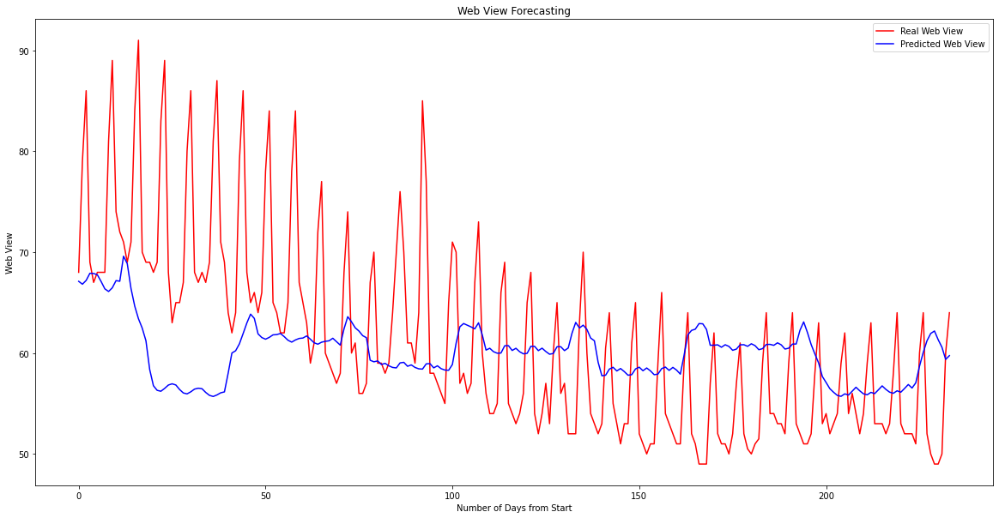

Score for the model  11.54279504652954


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat7, target7, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model7=Sequential()
model7.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model7.add(Dropout(0.2))
model7.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model7.add(Dense(1))
opt=Adam(learning_rate=0.001)
model7.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model7_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model7.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model7.load_weights('model7_new.hdf5')
model7.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model7.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Model 8

C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\ADMIN\anaconda3\lib\site-packages\ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.p

Epoch 1/100

If you intended to run this layer in float32, you can safely ignore this warning. If in doubt, this warning is likely only an issue if you are porting a TensorFlow 1.X model to TensorFlow 2.

To change all layers to have dtype float64 by default, call `tf.keras.backend.set_floatx('float64')`. To change just this layer, pass dtype='float64' to the layer constructor. If you are the author of this layer, you can disable autocasting by passing autocast=False to the base Layer constructor.

7/7 [==============================] - ETA: 0s - loss: 0.6595
Epoch 00001: val_loss improved from inf to 0.43836, saving model to model8_new.hdf5
7/7 [==============================] - 1s 189ms/step - loss: 0.6595 - val_loss: 0.4384
Epoch 2/100
6/7 [========================>.....] - ETA: 0s - loss: 0.4363
Epoch 00002: val_loss improved from 0.43836 to 0.09012, saving model to model8_new.hdf5
7/7 [==============================] - 0s 66ms/step - loss: 0.3917 - val_loss: 0.0901
Epoch 3/100
7/7

Epoch 36/100
7/7 [==============================] - ETA: 0s - loss: 0.1581
Epoch 00036: val_loss did not improve from 0.08866
7/7 [==============================] - 0s 65ms/step - loss: 0.1581 - val_loss: 0.2024
Epoch 37/100
7/7 [==============================] - ETA: 0s - loss: 0.1562
Epoch 00037: val_loss did not improve from 0.08866
7/7 [==============================] - 0s 65ms/step - loss: 0.1562 - val_loss: 0.2259
Epoch 38/100
7/7 [==============================] - ETA: 0s - loss: 0.1429
Epoch 00038: val_loss did not improve from 0.08866
7/7 [==============================] - 1s 79ms/step - loss: 0.1429 - val_loss: 0.1972
Epoch 39/100
7/7 [==============================] - ETA: 0s - loss: 0.1628
Epoch 00039: val_loss did not improve from 0.08866
7/7 [==============================] - 1s 78ms/step - loss: 0.1628 - val_loss: 0.2613
Epoch 40/100
7/7 [==============================] - ETA: 0s - loss: 0.1367
Epoch 00040: val_loss did not improve from 0.08866
7/7 [=====================

Epoch 75/100
6/7 [========================>.....] - ETA: 0s - loss: 0.1438
Epoch 00075: val_loss did not improve from 0.08866
7/7 [==============================] - 0s 61ms/step - loss: 0.1484 - val_loss: 0.2572
Epoch 76/100
7/7 [==============================] - ETA: 0s - loss: 0.1328
Epoch 00076: val_loss did not improve from 0.08866
7/7 [==============================] - 0s 61ms/step - loss: 0.1328 - val_loss: 0.1994
Epoch 77/100
7/7 [==============================] - ETA: 0s - loss: 0.1572
Epoch 00077: val_loss did not improve from 0.08866
7/7 [==============================] - 0s 60ms/step - loss: 0.1572 - val_loss: 0.2576
Epoch 78/100
6/7 [========================>.....] - ETA: 0s - loss: 0.1325
Epoch 00078: val_loss did not improve from 0.08866
7/7 [==============================] - 0s 58ms/step - loss: 0.1364 - val_loss: 0.2088
Epoch 79/100
6/7 [========================>.....] - ETA: 0s - loss: 0.1500
Epoch 00079: val_loss did not improve from 0.08866
7/7 [=====================

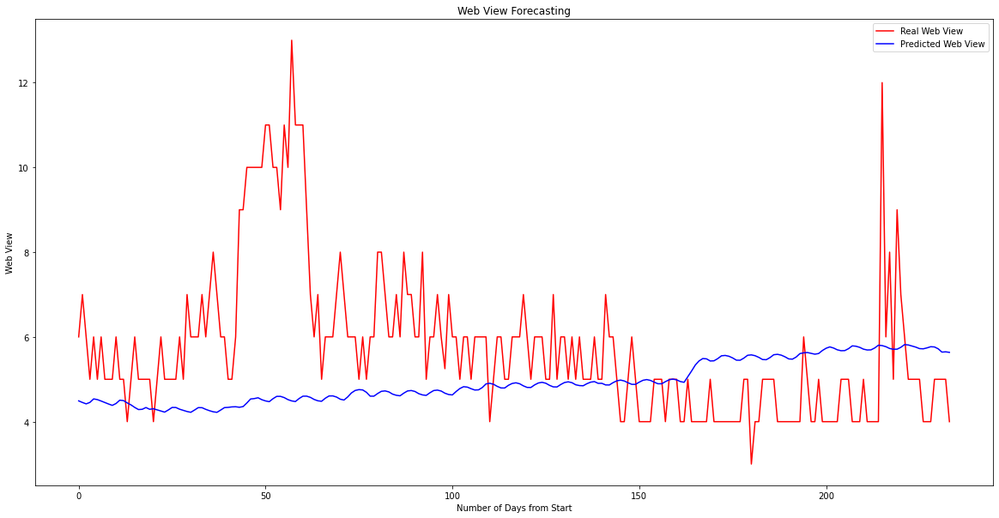

Score for the model  27.562404426815988


In [ ]:
from sklearn.model_selection import train_test_split
from keras.callbacks import ModelCheckpoint
from tensorflow.keras import backend as K
X_train, X_test, y_train, y_test = train_test_split(total_feat8, target8, test_size = 0.3, random_state = 0,shuffle=False)
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
X_train['month_start']=le1.fit_transform(X_train['month_start'])
X_test['month_start']=le1.transform(X_test['month_start'])

le2=LabelEncoder()
X_train['month_end']=le2.fit_transform(X_train['month_end'])
X_test['month_end']=le2.transform(X_test['month_end'])

le3=LabelEncoder()
X_train['quarter_start']=le3.fit_transform(X_train['quarter_start'])
X_test['quarter_start']=le3.transform(X_test['quarter_start'])

le4=LabelEncoder()
X_train['quarter_end']=le4.fit_transform(X_train['quarter_end'])
X_test['quarter_end']=le4.transform(X_test['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

#for i in X_train.columns:
    
 #   X_train[i] = X_train[i].astype('float')
  #  X_test[i]=X_test[i].astype('float')
X_train=np.log1p(X_train)
X_test=np.log1p(X_test)
y_train=np.log1p(y_train)

    
train_x,train_y=create_dataset(X_train.values,y_train.values,7)
test_x,test_y=create_dataset(X_test.values,y_test.values,7)


from keras import Sequential
import keras
from keras.layers import LSTM
from keras.layers import Dropout
from keras.layers import Bidirectional
from keras.layers import Dense
from keras.optimizers import Adam
model8=Sequential()
model8.add(Bidirectional(
            LSTM(units=128,
                 activation='relu',
                 input_shape=(train_x.shape[0],train_x.shape[1],),
                 return_sequences=True
                )
        )
         )
         
model8.add(Dropout(0.2))
model8.add(Bidirectional(
            LSTM(units=64,
                 activation='relu',
                 
                )
        )
         )
         
#model.add(Dropout(0.8))
def customLoss(y_true, y_pred):
    epsilon = 0.1
    summ = K.maximum(K.abs(y_true) + K.abs(y_pred) + epsilon, 0.5 + epsilon)
    smape = K.abs(y_pred - y_true) / summ * 2.0
    return smape

model8.add(Dense(1))
opt=Adam(learning_rate=0.001)
model8.compile(loss=customLoss,optimizer=opt)
#print(model.summary())
filepath='model8_new.hdf5'
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')
callbacks_list = [checkpoint]

history=model8.fit(train_x,train_y,epochs=100,batch_size=64,verbose=1,validation_split=0.2,shuffle=False,callbacks=callbacks_list)


model8.load_weights('model8_new.hdf5')
model8.compile(loss=customLoss,optimizer=opt)

y_pred_lstm=model8.predict(test_x)
y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y

plt.figure(figsize=(20,10))
plt.plot(test_y_lstm,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score for the model " ,smape(test_y_lstm,y_pred_lstm))

## Testing on some Random Page 

In [ ]:
# Selecting a random page to create page specific features
index=random.randint(0,train.shape[0])
print("Index No ",index )
page=train.loc[index]['Page']
# Selecting a set of dates for which we will predict
dates=train.iloc[0,450:500].index
target = pd.DataFrame(eda_train_imp.loc[eda_train_imp['Page']== page].iloc[0,450:500].values)
viewperc = pd.DataFrame(eda_train_imp.loc[eda_train_imp['Page']== page]['viewperc'])

target.columns = ['Target']
target['Target']=pd.to_numeric(target['Target'])
target

Index No  76908


,Target
0,395.0
1,379.0
2,445.0
3,446.0
4,463.0
5,370.0
6,402.0
7,384.0
8,422.0
9,439.0


#### Feature Development for test data

In [ ]:
date_list=[]
for i in dates:
    date_list.append(datetime.strptime(i, '%Y-%m-%d'))


In [ ]:
'''
Weekday is calculated using datelist ,weekend is calculated as 1 for weekend days and 0 
for weekdays.
Month is also calculated from datelist .Other features like month_start, month_end , quarter_start , quarter_end etc 
are created using this datelist.
'''
weekday_test=[]
for i in date_list:
    weekday_test.append(i.weekday())
weekday_test=pd.Series(weekday_test)

month_test=[]
for i in date_list:
    month_test.append(i.month)
month_test=pd.Series(month_test)

month_start_test=[]
month_start_test=pd.Series(date_list).dt.is_month_start

month_end_test=[]
month_end_test=pd.Series(date_list).dt.is_month_end

quarter_start_test=[]
quarter_start_test=pd.Series(date_list).dt.is_quarter_start

quarter_end_test=[]
quarter_end_test=pd.Series(date_list).dt.is_quarter_end

week_test=[]
week_test=pd.Series(date_list).dt.week


quarter_test=[]
quarter_test=pd.Series(date_list).dt.quarter


days_in_month_test=[]
days_in_month_test =pd.Series(date_list).dt.days_in_month

year_test=[]
year_test=pd.Series(date_list).dt.year


'''
weekday has been calculated from the datelist 
is_sunday_or_monday feature is created from weekday feature . if weekday is 0 or 6 then its value will be 1 else 0  
'''
is_sunday_or_monday_test=[]
for i in weekday_test:
    if i == 0 or i == 6:
        is_sunday_or_monday_test.append(1)
    else:
        is_sunday_or_monday_test.append(0)
is_sunday_or_monday_test=pd.Series(is_sunday_or_monday_test)


'''
month is created from datelist and is_august is created from the month number
year_half feature is created from month number , first 6 months is 1 and second 6 months is 2.
'''
is_august_test=[]
for i in month_test:
    if i == 8:
        is_august_test.append(1)
    else:
        is_august_test.append(0)
is_august_test=pd.Series(is_august_test)

year_half_test=[]
for i in month_test:
    if i in [1,2,3,4,5,6] :
        year_half_test.append(1)
    else :
        year_half_test.append(2)
year_half_test=pd.Series(year_half_test)

### The above features are irrespective of the page , I will call them global features
global_feat=pd.DataFrame()
global_feat=pd.concat([weekday_test,is_sunday_or_monday_test,month_test,is_august_test,year_half_test,quarter_test,quarter_start_test,quarter_end_test,month_start_test,month_end_test,days_in_month_test,week_test],axis=1)
global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
global_feat.shape

(50, 12)

In [ ]:
access_index=eda_train_imp.loc[eda_train_imp['Page']==page]['Access'].values[0]
agent_index=eda_train_imp.loc[eda_train_imp['Page']==page]['Agent'].values[0]
if agent_index == 1:
    spider=[1]*(target.shape[0])
    non_spider=[0]*(target.shape[0])
else:
    spider=[0]*(target.shape[0])
    non_spider=[1]*(target.shape[0])
spider=pd.Series(spider)
non_spider=pd.Series(non_spider)


In [ ]:
page_specific_feat=pd.DataFrame()
page_specific_feat=pd.concat([spider,non_spider],axis=1)
page_specific_feat.columns=['spider','non_spider']
if access_index==0:
    page_specific_feat['All_Access']=1
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=0

elif access_index==1:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=1
    page_specific_feat['Mobile']=0
else:
    page_specific_feat['All_Access']=0
    page_specific_feat['Desktop']=0
    page_specific_feat['Mobile']=1

page_specific_feat

,spider,non_spider,All_Access,Desktop,Mobile
0,0,1,0,0,1
1,0,1,0,0,1
2,0,1,0,0,1
3,0,1,0,0,1
4,0,1,0,0,1
5,0,1,0,0,1
6,0,1,0,0,1
7,0,1,0,0,1
8,0,1,0,0,1
9,0,1,0,0,1


In [ ]:
total_feat=pd.concat([global_feat,page_specific_feat],axis=1)
total_feat.head()

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week,spider,non_spider,All_Access,Desktop,Mobile
0,3,0,9,0,2,3,False,False,False,False,30,38,0,1,0,0,1
1,4,0,9,0,2,3,False,False,False,False,30,38,0,1,0,0,1
2,5,0,9,0,2,3,False,False,False,False,30,38,0,1,0,0,1
3,6,1,9,0,2,3,False,False,False,False,30,38,0,1,0,0,1
4,0,1,9,0,2,3,False,False,False,False,30,39,0,1,0,0,1


#### Encoding of categorical values ,standarization and data creation with timestep

In [ ]:
from sklearn.preprocessing import LabelEncoder
le1=LabelEncoder()
total_feat['month_start']=le1.fit_transform(total_feat['month_start'])


le2=LabelEncoder()
total_feat['month_end']=le2.fit_transform(total_feat['month_end'])


le3=LabelEncoder()
total_feat['quarter_start']=le3.fit_transform(total_feat['quarter_start'])


le4=LabelEncoder()
total_feat['quarter_end']=le4.fit_transform(total_feat['quarter_end'])


def create_dataset(X,y,timestep=1):
    Xs,ys=[],[]
    for i in range(len(X)-timestep):
        v=X[i:i+timestep]
        Xs.append(v)
        ys.append(y[i+timestep])
    return np.array(Xs),np.array(ys)

from sklearn.preprocessing import RobustScaler

    
total_feat=np.log1p(total_feat)
    
test_x1,test_y1=create_dataset(total_feat.values,target.values,7)
len(test_x1)

43

#### Testing with desired model 

- For testing the model on each page , I have taken the viewperc value for that page . 
- Also I find the access and agent for that page .
- If the viewperc is greater than the median viewperc for an agent access group then I use the 75th percentile model for that group else I use the 25th percentile model for that group.

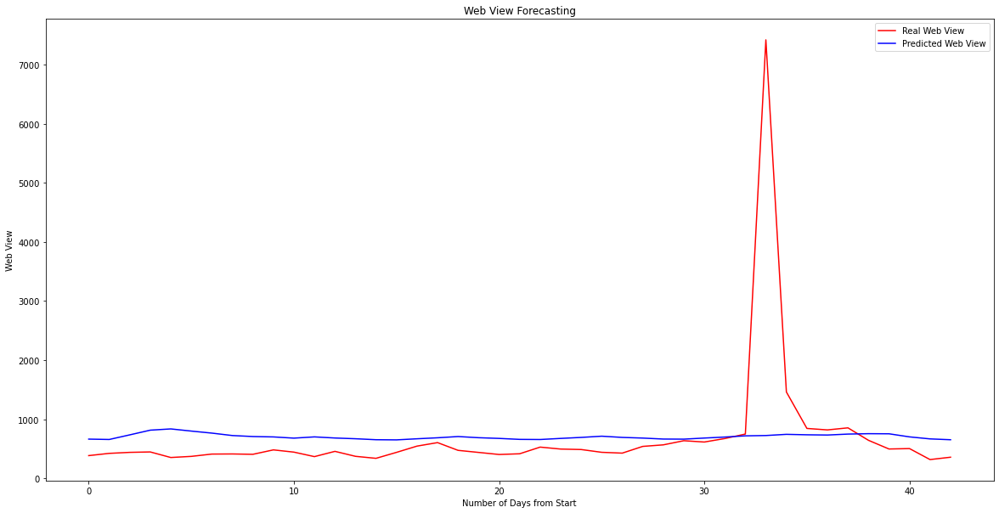

Score  42.20673439821267


In [ ]:
viewperc=viewperc.values[0][0]
if access_index==0 and agent_index==0:
    if viewperc>=viewmid.loc[0].values[0]:
        y_pred_lstm=model1.predict(test_x1)
    else:
        y_pred_lstm=model5.predict(test_x1)

elif access_index==1 and agent_index==0:
    if viewperc>=viewmid.loc[1].values[0]:
        y_pred_lstm=model2.predict(test_x1)
    else:
        y_pred_lstm=model6.predict(test_x1)

elif access_index==2 and agent_index==0:
    if viewperc>=viewmid.loc[2].values[0]:
        y_pred_lstm=model3.predict(test_x1)
    else:
        y_pred_lstm=model7.predict(test_x1)
elif access_index==0 and agent_index==1:
    if viewperc>=viewmid.loc[3].values[0]:
        y_pred_lstm=model4.predict(test_x1)
    else:
        y_pred_lstm=model8.predict(test_x1)

y_pred_lstm=np.exp(y_pred_lstm)-1
test_y_lstm=test_y1
#y_pred_lstm=sc_y.inverse_transform(y_pred_lstm)
plt.figure(figsize=(20,10))
plt.plot(test_y1,  color = 'red', label = 'Real Web View')
plt.plot(y_pred_lstm, color = 'blue', label = 'Predicted Web View')
plt.title('Web View Forecasting')
plt.xlabel('Number of Days from Start')
plt.ylabel('Web View')
plt.legend()
plt.show()

print("Score ",smape(test_y1,y_pred_lstm))

In [2]:
# Creating a dictionary using Page name as the keys and the viewperc as the values . 
# These will be accessed during predictions.

import pandas as pd
eda_train_imp=pd.read_csv('eda_train_imp.csv')
dictionary=dict(zip(eda_train_imp.Page,eda_train_imp.viewperc))
import numpy as np
np.save('viewperc.npy', dictionary) 

pageview = np.load('viewperc.npy',allow_pickle='TRUE').item()
print(pageview['5566_zh.wikipedia.org_all-access_spider']) # displays "world"


17.881693648816942


## Kaggle Predictions

In [ ]:
from datetime import date , timedelta
sdate = date(2017,9,13)   # start date
edate = date(2017,11,23)   # end date
actual_edate=date(2017,11,13)
delta = actual_edate-sdate
days= delta.days+1
test_date=pd.date_range(sdate,edate-timedelta(days=1),freq='d')
print(days)

62


In [ ]:
def global_feat(datelist):
   
    weekday_test=[]
    for i in datelist:
        weekday_test.append(i.weekday())
    weekday_test=pd.Series(weekday_test)

    month_test=[]
    for i in datelist:
        month_test.append(i.month)
    month_test=pd.Series(month_test)

    month_start_test=[]
    month_start_test=pd.Series(datelist).dt.is_month_start

    month_end_test=[]
    month_end_test=pd.Series(datelist).dt.is_month_end

    quarter_start_test=[]
    quarter_start_test=pd.Series(datelist).dt.is_quarter_start

    quarter_end_test=[]
    quarter_end_test=pd.Series(datelist).dt.is_quarter_end

    week_test=[]
    week_test=pd.Series(datelist).dt.week


    quarter_test=[]
    quarter_test=pd.Series(datelist).dt.quarter


    days_in_month_test=[]
    days_in_month_test =pd.Series(datelist).dt.days_in_month

    year_test=[]
    year_test=pd.Series(datelist).dt.year


    is_sunday_or_monday_test=[]
    for i in weekday_test:
        if i == 0 or i == 6:
            is_sunday_or_monday_test.append(1)
        else:
            is_sunday_or_monday_test.append(0)
    is_sunday_or_monday_test=pd.Series(is_sunday_or_monday_test)


    is_august_test=[]
    for i in month_test:
        if i == 8:
            is_august_test.append(1)
        else:
            is_august_test.append(0)
    is_august_test=pd.Series(is_august_test)

    year_half_test=[]
    for i in month_test:
        if i in [1,2,3,4,5,6] :
            year_half_test.append(1)
        else :
            year_half_test.append(2)
    year_half_test=pd.Series(year_half_test)

### The above features are irrespective of the page , I will call them global features
    global_feat=pd.DataFrame()
    global_feat=pd.concat([weekday_test,is_sunday_or_monday_test,month_test,is_august_test,year_half_test,quarter_test,quarter_start_test,quarter_end_test,month_start_test,month_end_test,days_in_month_test,week_test],axis=1)
    global_feat.columns=['weekday','is_sunday_or_monday','month','is_august','year_half','quarter','quarter_start','quarter_end','month_start','month_end','days_in_month','week']
    return global_feat

In [ ]:
global_feat_test=global_feat(test_date)
global_feat_test

,weekday,is_sunday_or_monday,month,is_august,year_half,quarter,quarter_start,quarter_end,month_start,month_end,days_in_month,week
0,2,0,9,0,2,3,False,False,False,False,30,37
1,3,0,9,0,2,3,False,False,False,False,30,37
2,4,0,9,0,2,3,False,False,False,False,30,37
3,5,0,9,0,2,3,False,False,False,False,30,37
4,6,1,9,0,2,3,False,False,False,False,30,37
...,...,...,...,...,...,...,...,...,...,...,...,...
66,5,0,11,0,2,4,False,False,False,False,30,46
67,6,1,11,0,2,4,False,False,False,False,30,46
68,0,1,11,0,2,4,False,False,False,False,30,47
69,1,0,11,0,2,4,False,False,False,False,30,47


In [ ]:
view1=viewmid.loc[0].values[0]
view2=viewmid.loc[1].values[0]
view3=viewmid.loc[2].values[0]
view4=viewmid.loc[3].values[0]

In [ ]:
def total_feat_create(page,global_feat,eda_train_imp):
    access_index=eda_train_imp.loc[eda_train_imp['Page']==page]['Access'].values[0]
    agent_index=eda_train_imp.loc[eda_train_imp['Page']==page]['Agent'].values[0]
    viewperc=eda_train_imp.loc[eda_train_imp['Page']==page]['viewperc'].values[0]

    
    if agent_index == 1:
        spider=[1]*(global_feat.shape[0])
        non_spider=[0]*(global_feat.shape[0])
    else:
        spider=[0]*(global_feat.shape[0])
        non_spider=[1]*(global_feat.shape[0])
    spider=pd.Series(spider)
    non_spider=pd.Series(non_spider)
    page_specific_feat=pd.DataFrame()
    page_specific_feat=pd.concat([spider,non_spider],axis=1)
    page_specific_feat.columns=['spider','non_spider']
    if access_index==0:
        page_specific_feat['All_Access']=1
        page_specific_feat['Desktop']=0
        page_specific_feat['Mobile']=0

    elif access_index==1:
        page_specific_feat['All_Access']=0
        page_specific_feat['Desktop']=1
        page_specific_feat['Mobile']=0
    else:
        page_specific_feat['All_Access']=0
        page_specific_feat['Desktop']=0
        page_specific_feat['Mobile']=1

    total_feat=pd.concat([global_feat,page_specific_feat],axis=1)
    return total_feat

In [ ]:
def testing(page,global_feat,days):
    total_feat=pd.DataFrame()
    total_feat=total_feat_create(page,global_feat,eda_train_imp)
    access_index=eda_train_imp.loc[eda_train_imp['Page']==page]['Access'].values[0]
    agent_index=eda_train_imp.loc[eda_train_imp['Page']==page]['Agent'].values[0]
    viewperc=eda_train_imp.loc[eda_train_imp['Page']==page]['viewperc'].values[0]

    
    from sklearn.preprocessing import LabelEncoder
    le1=LabelEncoder()
    total_feat['month_start']=le1.fit_transform(total_feat['month_start'])


    le2=LabelEncoder()
    total_feat['month_end']=le2.fit_transform(total_feat['month_end'])


    le3=LabelEncoder()
    total_feat['quarter_start']=le3.fit_transform(total_feat['quarter_start'])


    le4=LabelEncoder()
    total_feat['quarter_end']=le4.fit_transform(total_feat['quarter_end'])



    def create_test_dataset(X,timestep=1):
        Xs=[]
        for i in range(len(X)):
            end_ix=i+timestep
            if end_ix > X.shape[0]:
                break
            
            v=X[i:end_ix]
            Xs.append(v)
            
        return np.array(Xs)

    from sklearn.preprocessing import RobustScaler
    '''
    for i in total_feat.columns:
    
        total_feat[i] = total_feat[i].astype('float')
    '''
    total_feat=np.log1p(total_feat)
    test_x=create_test_dataset(total_feat.values,7)
    
    if access_index==0 and agent_index==0:
        if viewperc>=view1:
            y_pred_lstm=model1.predict(test_x)
        else:
            y_pred_lstm=model5.predict(test_x)

    elif access_index==1 and agent_index==0:
        if viewperc>=view2:
            y_pred_lstm=model2.predict(test_x)
        else:
            y_pred_lstm=model6.predict(test_x)

    elif access_index==2 and agent_index==0:
        if viewperc>=view3:
            y_pred_lstm=model3.predict(test_x)
        else:
            y_pred_lstm=model7.predict(test_x)
    elif access_index==0 and agent_index==1:
        if viewperc>=view4:
            y_pred_lstm=model4.predict(test_x)
        else:
            y_pred_lstm=model8.predict(test_x)

    y_pred_lstm=y_pred_lstm[0:days]
    y_pred_lstm=np.exp(y_pred_lstm)-1
    y_pred_lstm=pd.DataFrame(y_pred_lstm)
    print(y_pred_lstm.shape)
    y_pred_lstm['Page']=page
    return y_pred_lstm

#### Reading the key file for submission

In [ ]:
import pandas as pd
key_data=pd.read_csv('key_2.csv')
key_data.head()

Generating page name from page value

In [ ]:
key_data['Page_name']=key_data.apply(lambda x : x['Page'][0:-11],axis=1 )
key_data

In [ ]:
key_data_new=key_data[['Page_name','Id']]
key_data_new.head()

,Page_name,Id
0,007_スペクター_ja.wikipedia.org_all-access_all-agents,0b293039387a
1,007_スペクター_ja.wikipedia.org_all-access_all-agents,7114389dd824
2,007_スペクター_ja.wikipedia.org_all-access_all-agents,057b02ff1f09
3,007_スペクター_ja.wikipedia.org_all-access_all-agents,bd2aca21caa3
4,007_スペクター_ja.wikipedia.org_all-access_all-agents,c0effb42cdd5


In [ ]:
pagelist=key_data_new['Page_name'].unique()

len(pagelist)

145063

#### Predicting for all pages

In [ ]:
final_df=pd.DataFrame()
k=0
for i in pagelist:
    k=k+1
    print(k)
    preddf=testing(i,global_feat_test,days)
    final_df=pd.concat([final_df,preddf],axis=0,ignore_index=True)

final_df

In [ ]:
final_df.columns=['Visits','Page_name']
final_df.to_csv('test_out_4.csv')

In [ ]:
result = pd.concat([key_data_new,final_df],axis=1)
result.head()

,Page_name,Id,Visits,Page_name
0,007_スペクター_ja.wikipedia.org_all-access_all-agents,0b293039387a,1343.774902,007_スペクター_ja.wikipedia.org_all-access_all-agents
1,007_スペクター_ja.wikipedia.org_all-access_all-agents,7114389dd824,1317.541992,007_スペクター_ja.wikipedia.org_all-access_all-agents
2,007_スペクター_ja.wikipedia.org_all-access_all-agents,057b02ff1f09,1313.882812,007_スペクター_ja.wikipedia.org_all-access_all-agents
3,007_スペクター_ja.wikipedia.org_all-access_all-agents,bd2aca21caa3,1329.617554,007_スペクター_ja.wikipedia.org_all-access_all-agents
4,007_スペクター_ja.wikipedia.org_all-access_all-agents,c0effb42cdd5,1374.627197,007_スペクター_ja.wikipedia.org_all-access_all-agents


In [ ]:
result=result[['Id','Visits']]
result.head()

,Id,Visits
0,0b293039387a,1343.774902
1,7114389dd824,1317.541992
2,057b02ff1f09,1313.882812
3,bd2aca21caa3,1329.617554
4,c0effb42cdd5,1374.627197


In [ ]:
result.to_csv('Submission_lstm_tr4.csv',index=False)
key_data_new.to_csv('key_data_pro.csv',index=False)

## Kaggle score for LSTM Model

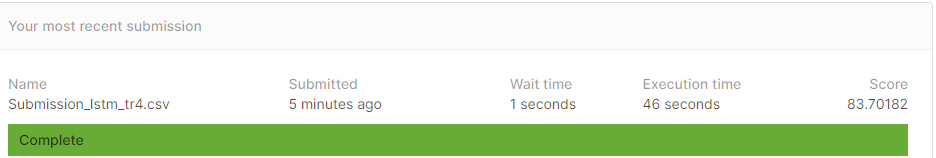

In [ ]:
from IPython.display import display
from PIL import Image


path="Screenshot_12.png"
display(Image.open(path))


### Kaggle Score for Baseline Model

In [ ]:
key_data_new['Visit_Base']=mean_forcast
result_base=key_data_new[['Id','Visit_Base']]
result_base.head()

,Id,Visit_Base
0,0b293039387a,1281.730282
1,7114389dd824,1281.730282
2,057b02ff1f09,1281.730282
3,bd2aca21caa3,1281.730282
4,c0effb42cdd5,1281.730282


In [ ]:
result_base.columns=['Id','Visits']
result_base.to_csv('Submission_Base.csv',index=False)

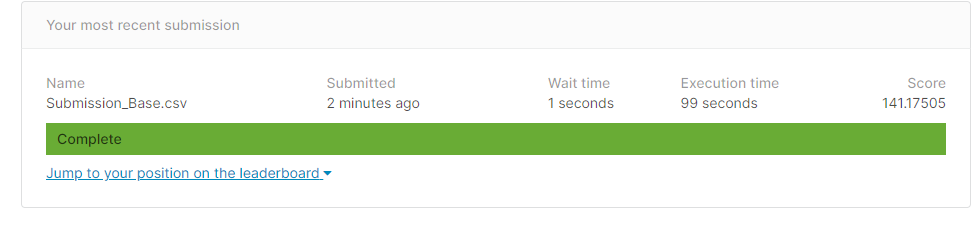

In [ ]:
from IPython.display import display
from PIL import Image


path="Screenshot_13.png"
display(Image.open(path))


In [4]:
from prettytable import PrettyTable
x= PrettyTable()
x.field_names=['Model','Kaggle Score']
x.add_row(['Model LSTM (with dropout)',83.70])
x.add_row(['Model LSTM (without dropout)',84.80])
x.add_row(['Model CNN ',84.15])
x.add_row(['Model CNN-LSTM ',84.46])
print(x)

+------------------------------+--------------+
|            Model             | Kaggle Score |
+------------------------------+--------------+
|  Model LSTM (with dropout)   |     83.7     |
| Model LSTM (without dropout) |     84.8     |
|          Model CNN           |    84.15     |
|       Model CNN-LSTM         |    84.46     |
+------------------------------+--------------+
